# **1. DATA Collection**

**Import Libraries**

In [1]:
import sys
import tarfile
import time
import zipfile
from collections import defaultdict
import pandas as pd
%matplotlib inline 
import numpy as np
import seaborn as sns
from scipy.stats import norm, pearsonr
sns.set_theme(color_codes=True)
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split


## **1.1. Import Dataset**

In [2]:
flotation = pd.read_csv("RAW PLANT DATA.csv")
# Display initial data types
print("Initial data types:")
print(flotation.dtypes)
print()

Initial data types:
date                            object
% Iron Feed                     object
% Silica Feed                   object
Starch Flow                     object
Amina Flow                      object
Ore Pulp Flow                   object
Ore Pulp pH                     object
Ore Pulp Density                object
Flotation Column 01 Air Flow    object
Flotation Column 02 Air Flow    object
Flotation Column 03 Air Flow    object
Flotation Column 04 Air Flow    object
Flotation Column 05 Air Flow    object
Flotation Column 06 Air Flow    object
Flotation Column 07 Air Flow    object
Flotation Column 01 Level       object
Flotation Column 02 Level       object
Flotation Column 03 Level       object
Flotation Column 04 Level       object
Flotation Column 05 Level       object
Flotation Column 06 Level       object
Flotation Column 07 Level       object
% Iron Concentrate              object
% Silica Concentrate            object
dtype: object



At this stage all dtypes = object. We want date as the index and all data columns as numeric types (float64/32/16). This we will change later.

# **2. Data Preprocessing**

## **2.1. Dataset information**

In [3]:
flotation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 737453 entries, 0 to 737452
Data columns (total 24 columns):
 #   Column                        Non-Null Count   Dtype 
---  ------                        --------------   ----- 
 0   date                          737453 non-null  object
 1   % Iron Feed                   737453 non-null  object
 2   % Silica Feed                 737453 non-null  object
 3   Starch Flow                   737453 non-null  object
 4   Amina Flow                    737453 non-null  object
 5   Ore Pulp Flow                 737453 non-null  object
 6   Ore Pulp pH                   737453 non-null  object
 7   Ore Pulp Density              737453 non-null  object
 8   Flotation Column 01 Air Flow  737453 non-null  object
 9   Flotation Column 02 Air Flow  737453 non-null  object
 10  Flotation Column 03 Air Flow  737453 non-null  object
 11  Flotation Column 04 Air Flow  737453 non-null  object
 12  Flotation Column 05 Air Flow  737453 non-null  object
 13 

In [4]:
flotation.sample(5).T

,155445,160570,101525,121905,591010
date,2017-04-28 06:00:00,2017-04-29 11:00:00,2017-04-15 19:00:00,2017-04-20 12:00:00,2017-08-07 02:00:00
% Iron Feed,"53,01","53,64","54,26","53,51","48,81"
% Silica Feed,"20,32","19,08","17,54","16,52","25,31"
Starch Flow,"1867,12","2361,26","2060,15","2451,96","2636,82"
Amina Flow,"552,943","532,182","567,236","516,891","356,692"
Ore Pulp Flow,"402,909","402,604","405,472","402,766","384,1851987382"
Ore Pulp pH,"9,37441","9,98963","9,44756","9,72592","10,0697"
Ore Pulp Density,"1,74861","1,79049","1,76665","1,69579","1,54314"
Flotation Column 01 Air Flow,"300,366","300,107","250,315","249,708","299,24"
Flotation Column 02 Air Flow,"295,548","321,853","247,222","251,829","293,293"


In [5]:
flotation.describe().T

,count,unique,top,freq
date,737453,4097,2017-06-16 15:00:00,180
% Iron Feed,737453,278,"64,03",142560
% Silica Feed,737453,293,"6,26",142560
Starch Flow,737453,409317,"2562,5",690
Amina Flow,737453,319416,"534,668",959
Ore Pulp Flow,737453,180189,"402,246",1735
Ore Pulp pH,737453,131143,"10,0591",1509
Ore Pulp Density,737453,105805,"1,75",3214
Flotation Column 01 Air Flow,737453,43675,"299,927",13683
Flotation Column 02 Air Flow,737453,80442,"255,322",1487


In [6]:
flotation.isna()

,date,% Iron Feed,% Silica Feed,Starch Flow,Amina Flow,Ore Pulp Flow,Ore Pulp pH,Ore Pulp Density,Flotation Column 01 Air Flow,Flotation Column 02 Air Flow,...,Flotation Column 07 Air Flow,Flotation Column 01 Level,Flotation Column 02 Level,Flotation Column 03 Level,Flotation Column 04 Level,Flotation Column 05 Level,Flotation Column 06 Level,Flotation Column 07 Level,% Iron Concentrate,% Silica Concentrate
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
737448,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
737449,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
737450,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
737451,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


## **2.2. Adjust and rename column names**

Although the column names are very descriptive, they are very long. We'd like them to be more concise.

In [7]:
# Rename column names
old_columns = ['% Iron Feed', '% Silica Feed', 'Starch Flow', 'Amina Flow',
       'Ore Pulp Flow', 'Ore Pulp pH', 'Ore Pulp Density',
       'Flotation Column 01 Air Flow', 'Flotation Column 02 Air Flow',
       'Flotation Column 03 Air Flow', 'Flotation Column 04 Air Flow',
       'Flotation Column 05 Air Flow', 'Flotation Column 06 Air Flow',
       'Flotation Column 07 Air Flow', 'Flotation Column 01 Level',
       'Flotation Column 02 Level', 'Flotation Column 03 Level',
       'Flotation Column 04 Level', 'Flotation Column 05 Level',
       'Flotation Column 06 Level', 'Flotation Column 07 Level',
       '% Iron Concentrate', '% Silica Concentrate']

new_columns = ["feed_Fe","feed_Si", "starch_flow", "amina_flow",
               "pulp_flow", "pulp_pH", "pulp_density",
               "air1", "air2", "air3", "air4", "air5", "air6", "air7",
               "level1", "level2", "level3", "level4", "level5", "level6", "level7",
               "conc_Fe", "conc_Si"]

flotation = flotation.rename(columns=dict(zip(old_columns, new_columns)))
flotation.columns

Index(['date', 'feed_Fe', 'feed_Si', 'starch_flow', 'amina_flow', 'pulp_flow',
       'pulp_pH', 'pulp_density', 'air1', 'air2', 'air3', 'air4', 'air5',
       'air6', 'air7', 'level1', 'level2', 'level3', 'level4', 'level5',
       'level6', 'level7', 'conc_Fe', 'conc_Si'],
      dtype='object')

## **2.3. Processing the data**


### **2.3.1. Changing decimal seperator to fullstops**
At this stage decimals are seperated by commas. We want them to be seperated by fullstops.

In [8]:
flotation = flotation.replace(',' , '.', regex = True)
flotation.head()

,date,feed_Fe,feed_Si,starch_flow,amina_flow,pulp_flow,pulp_pH,pulp_density,air1,air2,...,air7,level1,level2,level3,level4,level5,level6,level7,conc_Fe,conc_Si
0,2017-03-10 01:00:00,55.2,16.98,3019.53,557.434,395.713,10.0664,1.74,249.214,253.235,...,250.884,457.396,432.962,424.954,443.558,502.255,446.37,523.344,66.91,1.31
1,2017-03-10 01:00:00,55.2,16.98,3024.41,563.965,397.383,10.0672,1.74,249.719,250.532,...,248.994,451.891,429.56,432.939,448.086,496.363,445.922,498.075,66.91,1.31
2,2017-03-10 01:00:00,55.2,16.98,3043.46,568.054,399.668,10.068,1.74,249.741,247.874,...,248.071,451.24,468.927,434.61,449.688,484.411,447.826,458.567,66.91,1.31
3,2017-03-10 01:00:00,55.2,16.98,3047.36,568.665,397.939,10.0689,1.74,249.917,254.487,...,251.147,452.441,458.165,442.865,446.21,471.411,437.69,427.669,66.91,1.31
4,2017-03-10 01:00:00,55.2,16.98,3033.69,558.167,400.254,10.0697,1.74,250.203,252.136,...,248.928,452.441,452.9,450.523,453.67,462.598,443.682,425.679,66.91,1.31


### **2.3.2. Setting date column to correct form**
We want the data column as datetime type. Additionally we want this to be the index

In [9]:
# Convert 'date' column to datetime type
flotation['date'] = pd.to_datetime(flotation['date'])

# Set 'date' column as the index
flotation.set_index('date', inplace=True)

In [10]:
flotation

,feed_Fe,feed_Si,starch_flow,amina_flow,pulp_flow,pulp_pH,pulp_density,air1,air2,air3,...,air7,level1,level2,level3,level4,level5,level6,level7,conc_Fe,conc_Si
date,,,,,,,,,,,,,,,,,,,,,
2017-03-10 01:00:00,55.2,16.98,3019.53,557.434,395.713,10.0664,1.74,249.214,253.235,250.576,...,250.884,457.396,432.962,424.954,443.558,502.255,446.37,523.344,66.91,1.31
2017-03-10 01:00:00,55.2,16.98,3024.41,563.965,397.383,10.0672,1.74,249.719,250.532,250.862,...,248.994,451.891,429.56,432.939,448.086,496.363,445.922,498.075,66.91,1.31
2017-03-10 01:00:00,55.2,16.98,3043.46,568.054,399.668,10.068,1.74,249.741,247.874,250.313,...,248.071,451.24,468.927,434.61,449.688,484.411,447.826,458.567,66.91,1.31
2017-03-10 01:00:00,55.2,16.98,3047.36,568.665,397.939,10.0689,1.74,249.917,254.487,250.049,...,251.147,452.441,458.165,442.865,446.21,471.411,437.69,427.669,66.91,1.31
2017-03-10 01:00:00,55.2,16.98,3033.69,558.167,400.254,10.0697,1.74,250.203,252.136,249.895,...,248.928,452.441,452.9,450.523,453.67,462.598,443.682,425.679,66.91,1.31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-09-09 23:00:00,49.75,23.2,2710.94,441.052,386.57,9.62129,1.65365,302.344,298.786,299.163,...,313.695,392.16,430.702,872.008,418.725,497.548,446.357,416.892,64.27,1.71
2017-09-09 23:00:00,49.75,23.2,2692.01,473.436,384.939,9.62063,1.65352,303.013,301.879,299.487,...,236.7,401.505,404.616,864.409,418.377,506.398,372.995,426.337,64.27,1.71
2017-09-09 23:00:00,49.75,23.2,2692.2,500.488,383.496,9.61874,1.65338,303.662,307.397,299.487,...,225.879,408.899,399.316,867.598,419.531,503.414,336.035,433.13,64.27,1.71


### **2.3.3. Setting data type to numeric**

As previously mentioned all datatypes are as dtype=object. It should be of numeric type. Here we change it to float64.

In [11]:
# Display initial data types
print("Initial data types:")
print(flotation.dtypes)
print()

# Convert columns to appropriate data types
# Assuming the date column is named 'date' and the rest are numeric
numeric_columns = flotation.columns

for col in numeric_columns:
    flotation[col] = pd.to_numeric(flotation[col], errors='coerce')  # Convert to numeric, handle errors

# Display data types after conversion
print("Data types after conversion:")
print(flotation.dtypes)

Initial data types:
feed_Fe         object
feed_Si         object
starch_flow     object
amina_flow      object
pulp_flow       object
pulp_pH         object
pulp_density    object
air1            object
air2            object
air3            object
air4            object
air5            object
air6            object
air7            object
level1          object
level2          object
level3          object
level4          object
level5          object
level6          object
level7          object
conc_Fe         object
conc_Si         object
dtype: object

Data types after conversion:
feed_Fe         float64
feed_Si         float64
starch_flow     float64
amina_flow      float64
pulp_flow       float64
pulp_pH         float64
pulp_density    float64
air1            float64
air2            float64
air3            float64
air4            float64
air5            float64
air6            float64
air7            float64
level1          float64
level2          float64
level3          float64

### **2.3.4. Memory usage reduction**

It is not necessary for all datatypes to be float64. For many variables lower resolution may not infuence the accuracy very much, and save a tremendous amount of memory.

In [12]:
# Function to reduce memory usage
def reduce_mem_usage(flotation, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = flotation.memory_usage().sum() / 1024 ** 2
    for col in flotation.columns:
        col_type = flotation[col].dtypes
        if col_type in numerics:
            c_min = flotation[col].min()
            c_max = flotation[col].max()
            if str(col_type)[:3] == 'int':
                integer_types = [np.int8, np.int16, np.int32, np.int64]
                for int_type in integer_types:
                    if c_min > np.iinfo(int_type).min and c_max < np.iinfo(int_type).max:
                        try:
                            flotation[col] = flotation[col].astype(int_type)
                            break
                        except OverflowError:
                            continue
            else:
                float_types = [np.float32, np.float64]
                for float_type in float_types:
                    if c_min > np.finfo(float_type).min and c_max < np.finfo(float_type).max:
                        try:
                            flotation[col] = flotation[col].astype(float_type)
                            break
                        except OverflowError:
                            continue
    end_mem = flotation.memory_usage().sum() / 1024 ** 2
    if verbose:
        print(f"Mem. usage decreased to {end_mem:.2f} Mb ({100 * (start_mem - end_mem) / start_mem:.1f}% reduction)")
    return flotation

flotation = reduce_mem_usage(flotation)
print(flotation.dtypes)
print()
flotation

Mem. usage decreased to 70.33 Mb (47.9% reduction)
feed_Fe         float32
feed_Si         float32
starch_flow     float32
amina_flow      float32
pulp_flow       float32
pulp_pH         float32
pulp_density    float32
air1            float32
air2            float32
air3            float32
air4            float32
air5            float32
air6            float32
air7            float32
level1          float32
level2          float32
level3          float32
level4          float32
level5          float32
level6          float32
level7          float32
conc_Fe         float32
conc_Si         float32
dtype: object



,feed_Fe,feed_Si,starch_flow,amina_flow,pulp_flow,pulp_pH,pulp_density,air1,air2,air3,...,air7,level1,level2,level3,level4,level5,level6,level7,conc_Fe,conc_Si
date,,,,,,,,,,,,,,,,,,,,,
2017-03-10 01:00:00,55.200001,16.980000,3019.530029,557.434021,395.713013,10.06640,1.74000,249.214005,253.235001,250.576004,...,250.884003,457.395996,432.962006,424.954010,443.558014,502.255005,446.369995,523.343994,66.910004,1.31
2017-03-10 01:00:00,55.200001,16.980000,3024.409912,563.965027,397.382996,10.06720,1.74000,249.718994,250.531998,250.862000,...,248.994003,451.890991,429.559998,432.938995,448.085999,496.363007,445.921997,498.075012,66.910004,1.31
2017-03-10 01:00:00,55.200001,16.980000,3043.459961,568.054016,399.667999,10.06800,1.74000,249.740997,247.873993,250.313004,...,248.070999,451.239990,468.927002,434.609985,449.687988,484.411011,447.825989,458.566986,66.910004,1.31
2017-03-10 01:00:00,55.200001,16.980000,3047.360107,568.664978,397.938995,10.06890,1.74000,249.917007,254.487000,250.048996,...,251.147003,452.441010,458.165009,442.864990,446.209991,471.411011,437.690002,427.669006,66.910004,1.31
2017-03-10 01:00:00,55.200001,16.980000,3033.689941,558.166992,400.253998,10.06970,1.74000,250.203003,252.136002,249.895004,...,248.927994,452.441010,452.899994,450.523010,453.670013,462.597992,443.682007,425.678986,66.910004,1.31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-09-09 23:00:00,49.750000,23.200001,2710.939941,441.052002,386.570007,9.62129,1.65365,302.343994,298.786011,299.162994,...,313.695007,392.160004,430.701996,872.007996,418.725006,497.548004,446.356995,416.891998,64.269997,1.71
2017-09-09 23:00:00,49.750000,23.200001,2692.010010,473.436005,384.938995,9.62063,1.65352,303.013000,301.878998,299.487000,...,236.699997,401.505005,404.615997,864.408997,418.377014,506.398010,372.994995,426.337006,64.269997,1.71
2017-09-09 23:00:00,49.750000,23.200001,2692.199951,500.488007,383.496002,9.61874,1.65338,303.661987,307.397003,299.487000,...,225.878998,408.898987,399.316010,867.598022,419.531006,503.414001,336.035004,433.130005,64.269997,1.71


# **3. Exploratory Data Analysis (RAW DATASET)**

## **3.1. Descriptive Statistics**
Purpose: To get an overview of the data distribution, central tendency, and variability.

Methods:

- Summary Statistics: Mean, median, standard deviation, minimum, maximum, and quartiles.
- Skewness and Kurtosis: To understand the asymmetry and tail behavior of the data distribution.

In [13]:

uncut_descriptive_stats = flotation.describe().T
print(uncut_descriptive_stats)
uncut_descriptive_stats.to_excel("Flotation Data.xlsx", "stats_uncut", float_format = "%.3f")
print("________________________________________________________________")
print()
print("skewness")
print(flotation.skew())
print("________________________________________________________________")
print()
print("kurtosis")
print(flotation.kurtosis())

                 count         mean          std         min          25%  \
feed_Fe       737453.0    56.294743     5.157743   42.740002    52.669998   
feed_Si       737453.0    14.651719     6.807439    1.310000     8.940000   
starch_flow   737453.0  2869.140381  1215.203735    0.002026  2076.320068   
amina_flow    737453.0   488.144653    91.230537  241.669006   431.795990   
pulp_flow     737453.0   397.578400     9.699785  376.248993   394.264008   
pulp_pH       737453.0     9.767639     0.387007    8.753340     9.527360   
pulp_density  737453.0     1.680380     0.069249    1.519820     1.647310   
air1          737453.0   280.151886    29.621286  175.509995   250.281006   
air2          737453.0   277.159973    30.149357  175.156006   250.457001   
air3          737453.0   281.082489    28.558270  176.468994   250.854996   
air4          737453.0   299.447845     2.572536  292.195007   298.262573   
air5          737453.0   299.917816     3.636578  286.295013   298.067993   

## **3.2. Data Visualization**
Purpose: To visually inspect the data, detect anomalies, and understand relationships between variables.

Methods:

- Histograms: To visualize the distribution of each variable.
- Box Plots: To identify outliers and understand the spread and skewness of the data.
- Heatmaps: To visualize correlations between variables.
- Pair Plots: To examine relationships between pairs of variables

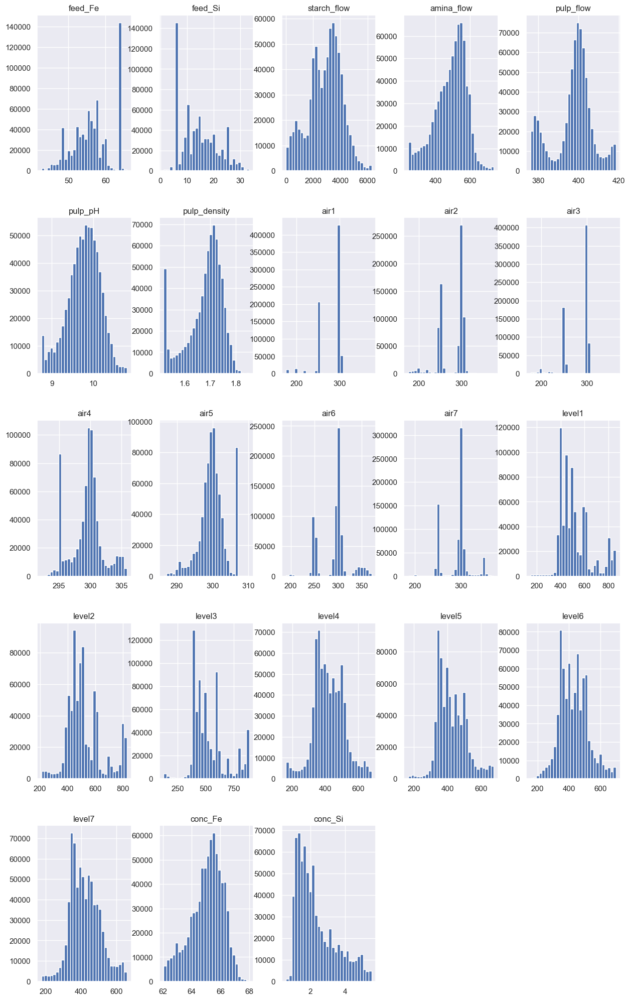

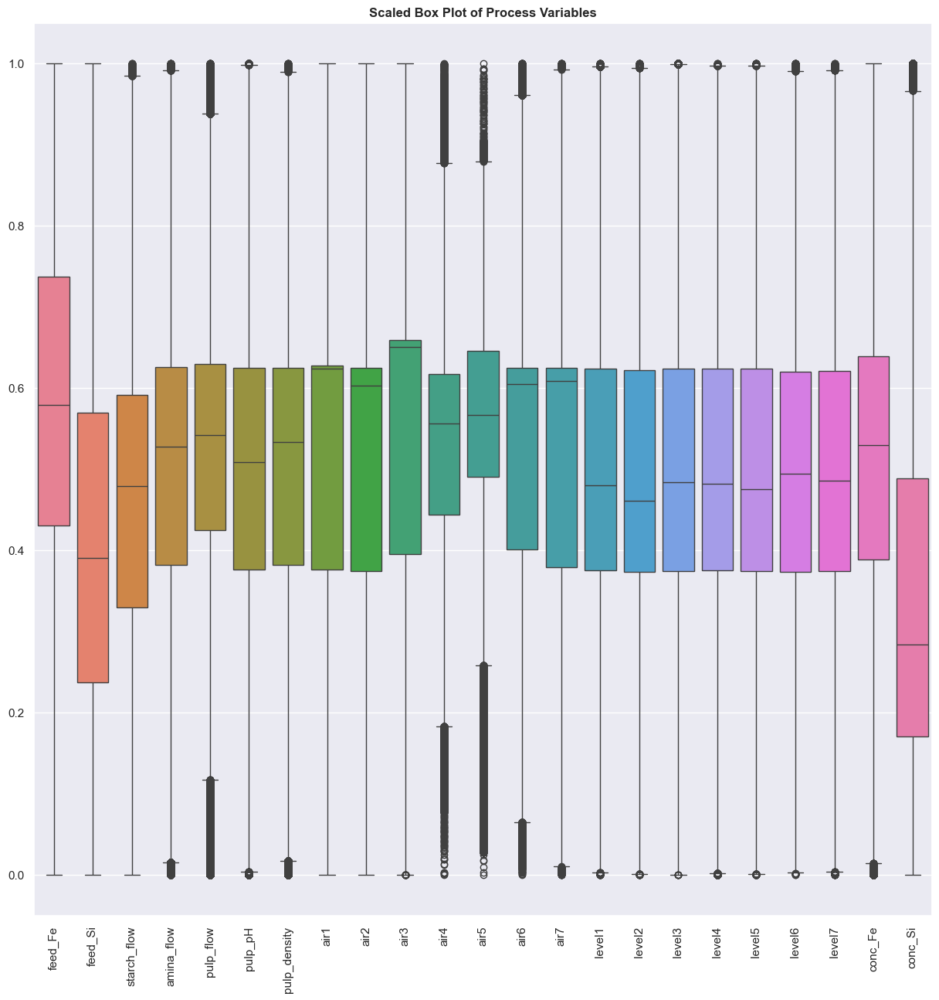

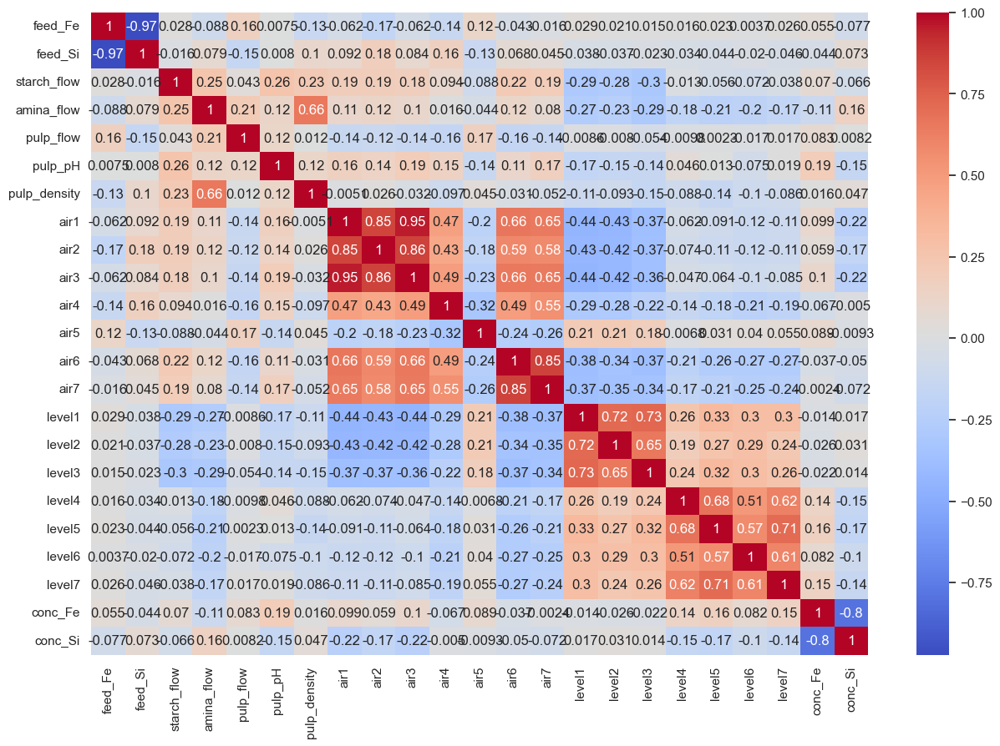

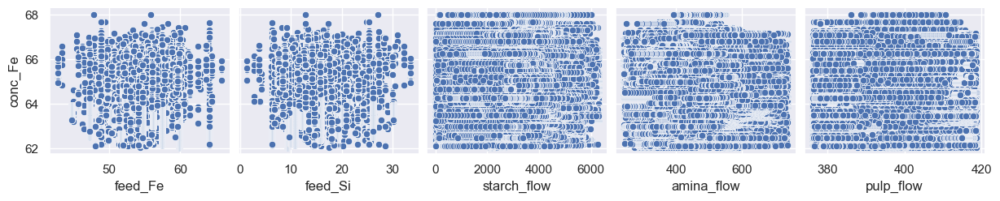

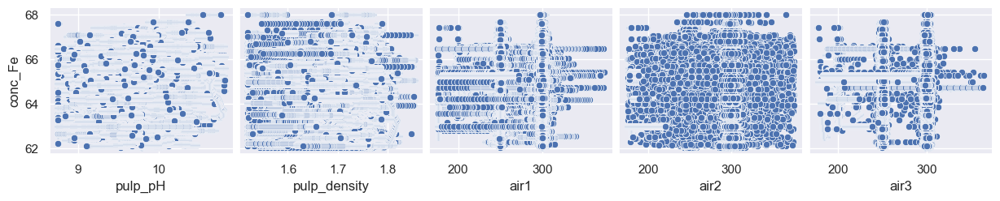

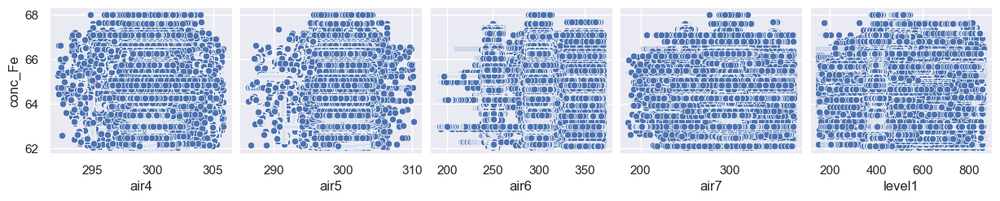

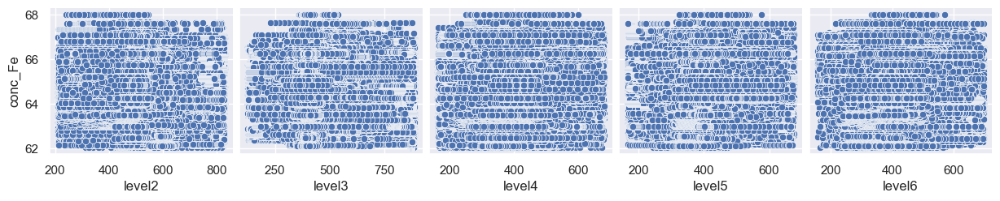

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import pandas as pd

# Histograms
flotation.hist(bins=30, figsize=(15, 25))
plt.title("Histograms of the Distribution of Process Variables")
plt.show()

# Box Plots
# Create a MinMaxScaler instance
scaler = MinMaxScaler()

# Apply MinMax scaling to the data
flotation_scaled = pd.DataFrame(scaler.fit_transform(flotation), columns=flotation.columns)

# Plot Box Plots
plt.figure(figsize=(15, 15))
sns.boxplot(data=flotation_scaled)
plt.xticks(rotation=90)
plt.title("Scaled Box Plot of Process Variables", fontsize=12, fontweight='bold')
plt.show()

# Correlation Heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(flotation.corr(), annot=True, cmap='coolwarm')
plt.show()


# Pair Plot for `conc_Fe` with other mean columns, split into four plots
mean_columns = [col for col in flotation.columns if not col.startswith('std_')]
num_splits = 4
split_size = len(mean_columns) // num_splits

# Split the columns into four groups
split_columns = [mean_columns[i * split_size: (i + 1) * split_size] for i in range(num_splits)]

# Generate pair plots for each group
for i, cols in enumerate(split_columns):
    sns.pairplot(flotation, x_vars=cols, y_vars=['conc_Fe'])
    #if i ==0:
        #plt.title(f'Pair Plot of Process Variables with Iron Concentration', fontsize = 12, fontweight ='bold')
    plt.show()


## **3.3. Time Series Analysis**
Purpose: Since the data is likely time-dependent, understanding trends, seasonality, and cycles is crucial.

Methods:

- Line Plots: To visualize trends over time.
- Seasonal Decomposition: To decompose the time series into trend, seasonal, and residual components.
- Autocorrelation and Partial Autocorrelation: To understand the lag relationships

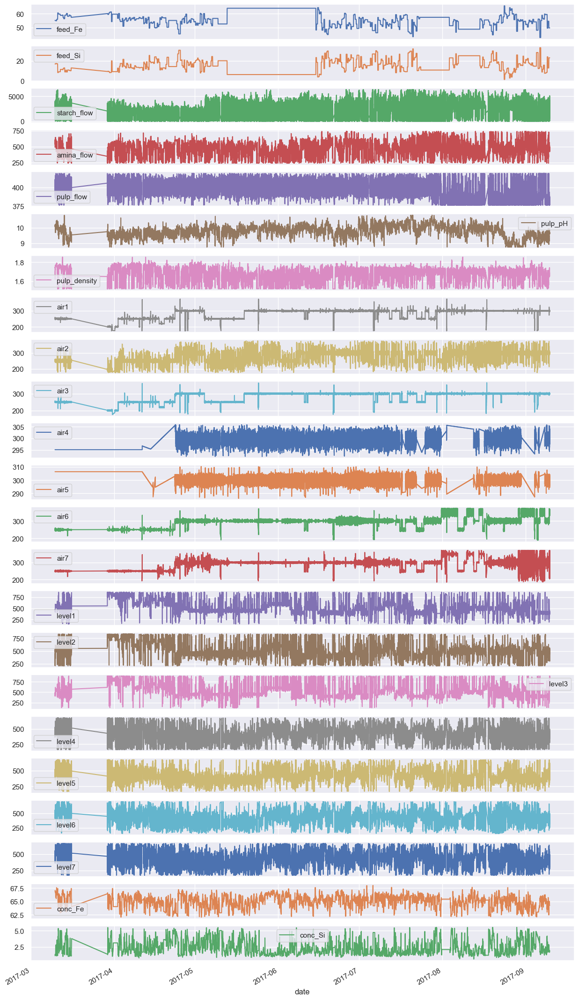

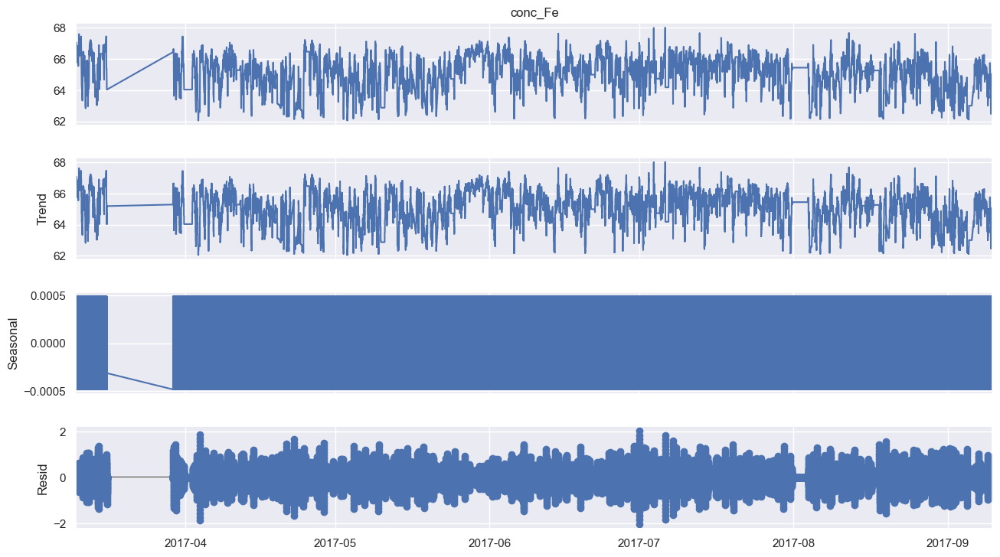

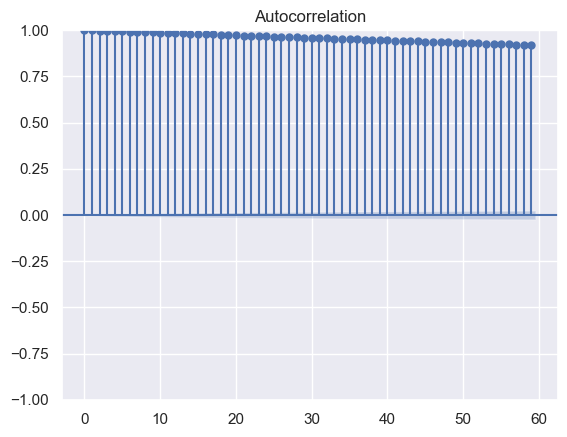

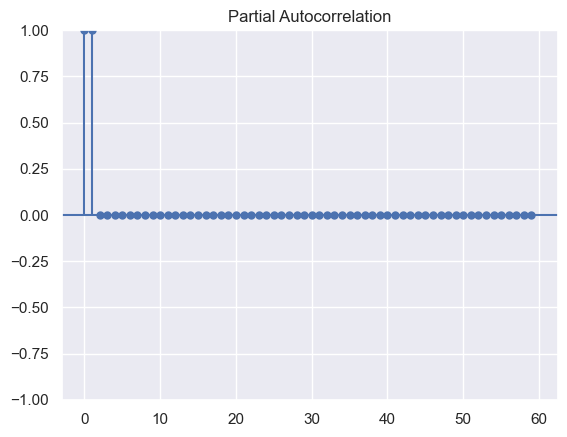

In [15]:
# Line Plots for all variables
flotation.plot(subplots=True, figsize=(15, 30))
plt.show()

# Seasonal Decomposition
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(flotation['conc_Fe'], model='additive', period=24)
fig = result.plot()
fig.set_size_inches(15, 8)
plt.show()

# Autocorrelation and Partial Autocorrelation
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plot_acf(flotation['conc_Fe'])
plot_pacf(flotation['conc_Fe'])
plt.show()

## **3.4. Feature Engineering and Selection**

Purpose: To create new features that might capture underlying physics principles and improve model performance.

Methods:

- Domain-Specific Features: Based on understanding of the flotation process.
- Lag Features: To capture temporal dependencies.
- Rolling Statistics: Mean, standard deviation, min, max over rolling windows.

In [16]:
flotation_FE1 = flotation.copy()
# Feature Engineering: Lag Features and Rolling Statistics for `conc_Fe`
for lag in range(1, 6):
    flotation_FE1[f'conc_Fe_lag_{lag}'] = flotation_FE1['conc_Fe'].shift(lag)

flotation_FE1['conc_Fe_roll_mean'] = flotation_FE1['conc_Fe'].rolling(window=5).mean()
flotation_FE1['conc_Fe_roll_std'] = flotation_FE1['conc_Fe'].rolling(window=5).std()

# Present lag features and rolling statistics in a DataFrame
lag_features = flotation_FE1[['conc_Fe'] + [f'conc_Fe_lag_{lag}' for lag in range(1, 6)]]
rolling_stats = flotation_FE1[['conc_Fe_roll_mean', 'conc_Fe_roll_std']]
print("Lag Features for conc_Fe:")
print(lag_features.head)
print("________________________________________")
print()
print("Rolling Statistics for conc_Fe:")
print(rolling_stats.head)

Lag Features for conc_Fe:
<bound method NDFrame.head of                        conc_Fe  conc_Fe_lag_1  conc_Fe_lag_2  conc_Fe_lag_3  \
date                                                                          
2017-03-10 01:00:00  66.910004            NaN            NaN            NaN   
2017-03-10 01:00:00  66.910004      66.910004            NaN            NaN   
2017-03-10 01:00:00  66.910004      66.910004      66.910004            NaN   
2017-03-10 01:00:00  66.910004      66.910004      66.910004      66.910004   
2017-03-10 01:00:00  66.910004      66.910004      66.910004      66.910004   
...                        ...            ...            ...            ...   
2017-09-09 23:00:00  64.269997      64.269997      64.269997      64.269997   
2017-09-09 23:00:00  64.269997      64.269997      64.269997      64.269997   
2017-09-09 23:00:00  64.269997      64.269997      64.269997      64.269997   
2017-09-09 23:00:00  64.269997      64.269997      64.269997      64.269997

## **3.5. Correlation and Multicollinearity Analysis**
Purpose: To identify highly correlated features and assess multicollinearity which can impact model performance.

Methods:

- Correlation Matrix: To identify highly correlated features.
- Variance Inflation Factor (VIF): To assess multicollinearity.

In [17]:
# Correlation Matrix
corr_matrix = flotation.corr()
print("CORRELATION MATRIX")
print(corr_matrix)
print("__________________________________________")
print()
# Variance Inflation Factor (VIF)

from statsmodels.stats.outliers_influence import variance_inflation_factor

# Calculating Variance Inflation Factor VIF for each feature
vif_data = pd.DataFrame()
vif_data["feature"] = flotation.columns
vif_data["VIF"] = [variance_inflation_factor(flotation.values, i) for i in range(len(flotation.columns))]
print(vif_data)

CORRELATION MATRIX
               feed_Fe   feed_Si  starch_flow  amina_flow  pulp_flow  \
feed_Fe       1.000000 -0.971833     0.027981   -0.088148   0.160705   
feed_Si      -0.971833  1.000000    -0.016073    0.078735  -0.150788   
starch_flow   0.027981 -0.016073     1.000000    0.254748   0.042703   
amina_flow   -0.088148  0.078735     0.254748    1.000000   0.212252   
pulp_flow     0.160705 -0.150788     0.042703    0.212252   1.000000   
pulp_pH       0.007451  0.008014     0.263020    0.123690   0.118376   
pulp_density -0.125518  0.104497     0.226004    0.655788   0.012279   
air1         -0.062379  0.091757     0.191131    0.111321  -0.137866   
air2         -0.169430  0.182573     0.186585    0.122911  -0.118549   
air3         -0.062207  0.084197     0.183288    0.101957  -0.140761   
air4         -0.137413  0.160880     0.093520    0.016080  -0.155990   
air5          0.121035 -0.130210    -0.088245   -0.044029   0.166989   
air6         -0.042531  0.067565     0.215780

## **3.6. Anomaly Detection**
Purpose: To detect anomalies in the data that could affect model training and prediction.

Methods:

- Isolation Forest: To identify anomalies in the dataset.
- Z-score: To identify outliers based on standard deviations from the mean.

In [18]:
from sklearn.ensemble import IsolationForest

iso = IsolationForest(contamination=0.01)
yhat = iso.fit_predict(flotation)
mask = yhat != -1
flotation_cleaned = flotation[mask]
print("Isolation Forest: Number of anomalies detected:", len(flotation) - len(flotation_cleaned))

# Z-score
from scipy import stats

z_scores = stats.zscore(flotation)
abs_z_scores = np.abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
flotation_cleaned = flotation[filtered_entries]
print("Isolation Forest: Number of anomalies detected:", len(flotation) - len(flotation_cleaned))

Isolation Forest: Number of anomalies detected: 7375
Isolation Forest: Number of anomalies detected: 19565


## **3.7. Plotting variables in time:**

The dataframe contains data about:

- Quality measures of the iron ore pulp before feeding it into the process (**inputs**)
- Features that can effect the quality of the product (**process parameters**)
- Quality measures of the iron ore pulp as product of the process (**outputs**)

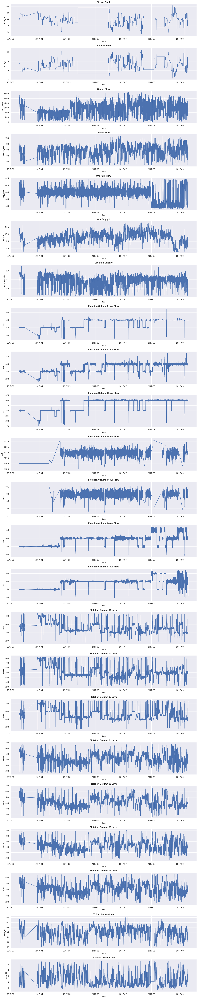

In [19]:
columns = flotation.columns

# Downsample the data to every nth point
n = 90  # Adjust this value based on the required resolution and performance
flotation_downsampled = flotation.iloc[::n, :]

# Configure the number of subplots
num_columns = 1
num_rows = (len(columns) - 1) // num_columns + 1

fig, axes = plt.subplots(num_rows, num_columns, figsize=(15, 75))
axes = axes.flatten()

for i, column in enumerate(columns):
    axes[i].plot(flotation_downsampled.index, flotation_downsampled[column])
    axes[i].set_xlabel('Date', fontsize=10, fontweight='bold')
    axes[i].set_ylabel(column, fontsize=10, fontweight='bold')
    axes[i].set_title(old_columns[i], fontsize=12, fontweight='bold')
    axes[i].grid(True)

if len(columns) < len(axes):
    for j in range(len(columns), len(axes)):
        axes[j].axis('off')

plt.tight_layout()
plt.show()

## **3.8. Transform dataset**



### **3.8.1. Snip Dataset**

The dataset misses data packages of a couple of days. This was probably caused by a production shutdown. In order to rule out any influences from potentially corrupted data, it will be trimmed the data earlier of the restart of production ("2017-03-29 12:00:00"). We can also see that the quality of the products does not seem to follow a clear temporal dependency.

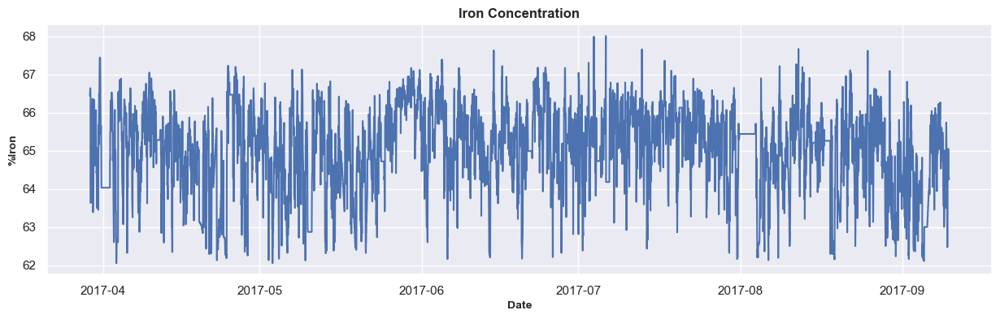

In [20]:
sep_date = "2017-03-29 12:00:00"

# Trim the dataset by filtering rows after the specified sep_date
flotation = flotation[flotation.index >= sep_date]


plt.figure(figsize=(15, 4))
plt.plot(flotation.index, flotation['conc_Fe'])
plt.xlabel('Date', fontsize=10, fontweight='bold')
plt.ylabel('%Iron', fontsize=10, fontweight='bold')
plt.title('Iron Concentration', fontsize=12, fontweight='bold')
plt.show()

In [21]:
flotation

,feed_Fe,feed_Si,starch_flow,amina_flow,pulp_flow,pulp_pH,pulp_density,air1,air2,air3,...,air7,level1,level2,level3,level4,level5,level6,level7,conc_Fe,conc_Si
date,,,,,,,,,,,,,,,,,,,,,
2017-03-29 12:00:00,60.18,9.340000,2044.989990,349.911011,405.625000,9.74604,1.649650,200.393005,195.733994,201.826004,...,251.001999,555.264465,552.255554,614.984741,428.429993,413.661987,447.886993,464.868988,66.440002,1.36
2017-03-29 12:00:00,60.18,9.340000,2020.550049,353.063995,404.402008,9.74169,1.643469,200.130997,196.475998,200.908997,...,250.828003,557.839905,554.531128,659.557434,431.145996,422.308014,444.325989,463.223999,66.440002,1.36
2017-03-29 12:00:00,60.18,9.340000,2012.839966,356.217010,403.179993,9.73733,1.637289,199.869003,197.218994,199.992004,...,250.653000,560.415405,556.806702,704.130127,433.863007,430.954010,440.765015,461.579010,66.440002,1.36
2017-03-29 12:00:00,60.18,9.340000,2007.670044,359.371002,401.957001,9.73298,1.631108,199.606995,197.960999,199.074997,...,250.477997,562.990845,559.082275,748.702881,436.579987,439.600006,437.204010,459.934998,66.440002,1.36
2017-03-29 12:00:00,60.18,9.340000,2003.920044,362.523987,400.734985,9.72862,1.624928,199.345001,198.703003,198.158005,...,250.304001,565.566345,561.357849,793.275574,439.295990,448.246002,433.643005,458.290009,66.440002,1.36
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-09-09 23:00:00,49.75,23.200001,2710.939941,441.052002,386.570007,9.62129,1.653650,302.343994,298.786011,299.162994,...,313.695007,392.160004,430.701996,872.007996,418.725006,497.548004,446.356995,416.891998,64.269997,1.71
2017-09-09 23:00:00,49.75,23.200001,2692.010010,473.436005,384.938995,9.62063,1.653520,303.013000,301.878998,299.487000,...,236.699997,401.505005,404.615997,864.408997,418.377014,506.398010,372.994995,426.337006,64.269997,1.71
2017-09-09 23:00:00,49.75,23.200001,2692.199951,500.488007,383.496002,9.61874,1.653380,303.661987,307.397003,299.487000,...,225.878998,408.898987,399.316010,867.598022,419.531006,503.414001,336.035004,433.130005,64.269997,1.71


### **3.8.2. Averaging dataset**

The dataset documentation reveals that different columns in the data are sampled at varying frequencies. Some features, like 'Ore Pulp Flow,' are recorded every 20 seconds, showcasing continuous changes throughout the process. On the other hand, features such as ('% Iron Feed' - '% Silica Feed') and ('% Iron Concentrate' - '% Silica Concentrate') are only logged once per hour. This discrepancy in sampling frequencies has important implications for how we interpret the data.

Treating each row as a separate observation might not accurately capture the true nature of the process, especially when including less frequently sampled features that remain constant over an hour. Simply using all the available samples for training a model fails to grasp the actual dynamics of the system.

One approach to address this issue involves aggregating the data by computing the average values of the 20-second samples within each hour. This process creates a new dataframe that represents the hourly average values, significantly reducing the data size by a factor of 180. By employing this approach, we obtain a more meaningful representation of the hourly trends. However, relying solely on mean values may result in the loss of crucial information present in the 20-second samples.

To mitigate the potential information loss from the 20-second samples, it is beneficial to consider the variations within each hour. Incorporating this variability can be accomplished by calculating additional statistics, such as the standard deviation of the meaned columns. Including these measures of variation allows us to capture the dynamics and fluctuations occurring within the hourly intervals, resulting in a more comprehensive representation of the process.

Considering the diverse sampling frequencies in the dataset and the trade-off between reducing data size and preserving information, aggregating the data to hourly means while incorporating measures of variability can offer a more meaningful depiction of the process dynamics. This aggregated representation can then be used for further analysis and modeling purposes.

In [22]:
# Assuming 'flotation' is your main DataFrame with a datetime index

# Convert the index to datetime
flotation.index = pd.to_datetime(flotation.index)

# Resample the DataFrame to hourly intervals
mean_grpby = flotation.resample('1H').mean()
median_grpby = flotation.resample('1H').median()
std_grpby = flotation.resample('1H').std()

# Add prefixes to column names to differentiate them
mean_grpby = mean_grpby.add_prefix('mean_')
median_grpby = median_grpby.add_prefix('median_')
std_grpby = std_grpby.add_prefix('std_')

# Merge all the statistics into a single DataFrame
flotation_transformed = pd.concat([mean_grpby, median_grpby, std_grpby], axis=1)

# Drop columns with zero variance (null columns) in standard deviation
flotation_transformed = flotation_transformed.loc[:, ~flotation_transformed.columns.str.startswith('std_') | (flotation_transformed.std() != 0)]
flotation_transformed


,mean_feed_Fe,mean_feed_Si,mean_starch_flow,mean_amina_flow,mean_pulp_flow,mean_pulp_pH,mean_pulp_density,mean_air1,mean_air2,mean_air3,...,std_air7,std_level1,std_level2,std_level3,std_level4,std_level5,std_level6,std_level7,std_conc_Fe,std_conc_Si
date,,,,,,,,,,,,,,,,,,,,,
2017-03-29 12:00:00,60.180000,9.340000,1060.859253,379.836212,400.982544,9.527187,1.550374,200.035858,195.577698,199.983719,...,0.950333,97.981102,85.517296,45.554947,90.034081,106.136345,65.240967,83.807144,0.0,0.0
2017-03-29 13:00:00,60.180000,9.340000,2034.926514,322.233978,400.468964,9.700680,1.532017,199.990128,195.106247,199.765350,...,1.148208,12.356236,31.635046,39.871929,99.486565,128.562744,62.340591,69.998680,0.0,0.0
2017-03-29 14:00:00,60.180000,9.340000,1435.425781,474.656342,399.157074,9.687788,1.645200,200.019318,195.604919,199.925797,...,0.780409,6.007056,1.179966,5.609657,30.081770,32.932713,35.395966,37.495720,0.0,0.0
2017-03-29 15:00:00,60.180000,9.340000,618.460388,396.377747,398.942535,9.851689,1.559929,199.940842,195.657089,200.044342,...,1.082366,1.246807,1.179967,3.835968,16.003298,21.890453,17.351725,29.120182,0.0,0.0
2017-03-29 16:00:00,59.540001,9.560000,1367.502808,317.134064,400.836273,9.936163,1.530983,199.878922,196.162872,199.905472,...,1.150451,1.246807,1.179965,2.012707,13.783445,15.665838,9.353200,20.850338,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-09-09 19:00:00,49.750000,23.200001,3327.047852,497.211212,380.847168,9.176166,1.660871,301.565552,300.169128,299.900726,...,35.129040,26.662367,20.563810,55.035778,31.808504,83.740372,64.330521,48.397110,0.0,0.0
2017-09-09 20:00:00,49.750000,23.200001,4225.800293,508.963837,381.112885,9.387542,1.691996,300.050171,299.967834,299.906555,...,32.842525,15.231664,18.871738,50.226105,26.046486,71.639023,42.086399,36.893654,0.0,0.0
2017-09-09 21:00:00,49.750000,23.200001,2808.214844,517.748840,381.064423,9.771276,1.735647,299.814270,299.801575,299.973145,...,34.800529,15.145633,19.272879,116.833397,29.102673,79.523247,58.479645,70.797409,0.0,0.0


Note: The purpose of removing columns with zero variance is to eliminate features that have constant values throughout the dataset. These columns do not contribute any useful information for modeling and can potentially cause issues during training. By removing them, we can reduce the dimensionality of the dataset and improve the model's performance.

**Median based aggregation/transformation**

- Subsequent analysis revealed that aggregating based o the mean value of each hourly interval poorly captures the variation in the raw data. 
- Aggregating based on the median will subsequently be performed to determine wheter or not it provides a significant improvement.

In [23]:
# Assuming `flotation` is your DataFrame
flotation_median = flotation.copy()
flotation_median.index = pd.to_datetime(flotation_median.index)

#Group by hourly intervals and calculate median and standard de#viation
median_grpby = flotation_median.resample('1H').median()
std_grpby = flotation_median.resample('1H').std()

# Add prefix 'std_' to the standard deviation columns
std_grpby = std_grpby.add_prefix('std_')

# Merge the median and standard deviation DataFrames
flotation_transformed_median = pd.concat([median_grpby, std_grpby], axis=1)

# Display the first few rows of the transformed DataFrame
flotation_transformed_median_stats = flotation_transformed_median.describe().T
flotation_transformed_median_stats

,count,mean,std,min,25%,50%,75%,max
feed_Fe,3948.0,56.220303,5.231149,42.740002,52.610001,55.939999,59.720001,65.779999
feed_Si,3948.0,14.767790,6.887711,1.310000,8.812500,14.200000,20.139999,33.400002
starch_flow,3948.0,2975.435303,1021.719299,1.506798,2210.356323,3088.412476,3687.473633,6272.199707
amina_flow,3948.0,490.795074,85.665283,242.800751,438.263123,506.208252,553.225372,737.291382
pulp_flow,3948.0,397.388153,9.022136,376.766754,398.685577,399.825989,400.589607,418.481018
pulp_pH,3948.0,9.769988,0.383590,8.753389,9.535417,9.798065,10.038775,10.807629
pulp_density,3948.0,1.680725,0.066265,1.519898,1.652080,1.697497,1.723737,1.824440
air1,3948.0,281.280243,29.484571,175.818817,250.119255,299.818481,299.949127,319.614990
air2,3948.0,278.218048,29.603615,177.898926,250.121002,299.583984,300.010376,310.050995
air3,3948.0,282.064331,28.307219,176.730072,250.030376,299.547256,299.817017,302.782990


Further analysis revealed that the median aggregate outperforms the mean based aggregate. The median dataset will henceforth be used by assigning it as the main dataframe

In [24]:
flotation = flotation_transformed

### **3.8.3. Check for missing values/duplicates**

In [25]:
missing_values = flotation.isnull().sum()
missing_values

mean_feed_Fe        0
mean_feed_Si        0
mean_starch_flow    0
mean_amina_flow     0
mean_pulp_flow      0
                   ..
std_level5          0
std_level6          0
std_level7          0
std_conc_Fe         0
std_conc_Si         0
Length: 67, dtype: int64

In [26]:
duplicates = flotation[flotation.duplicated()]
duplicates.count()

mean_feed_Fe        0
mean_feed_Si        0
mean_starch_flow    0
mean_amina_flow     0
mean_pulp_flow      0
                   ..
std_level5          0
std_level6          0
std_level7          0
std_conc_Fe         0
std_conc_Si         0
Length: 67, dtype: int64

In [27]:
flotation.info()


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3948 entries, 2017-03-29 12:00:00 to 2017-09-09 23:00:00
Freq: h
Data columns (total 67 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   mean_feed_Fe         3948 non-null   float32
 1   mean_feed_Si         3948 non-null   float32
 2   mean_starch_flow     3948 non-null   float32
 3   mean_amina_flow      3948 non-null   float32
 4   mean_pulp_flow       3948 non-null   float32
 5   mean_pulp_pH         3948 non-null   float32
 6   mean_pulp_density    3948 non-null   float32
 7   mean_air1            3948 non-null   float32
 8   mean_air2            3948 non-null   float32
 9   mean_air3            3948 non-null   float32
 10  mean_air4            3948 non-null   float32
 11  mean_air5            3948 non-null   float32
 12  mean_air6            3948 non-null   float32
 13  mean_air7            3948 non-null   float32
 14  mean_level1          3948 non-null   float32

# **3. Exploratory data analysis (Transformed Dataset)**

## **3.1. Correlation betw variables**

In [28]:
flotation.describe().T

,count,mean,std,min,25%,50%,75%,max
mean_feed_Fe,3948.0,56.220303,5.231150,42.740002,52.610001,55.940002,59.720005,65.779999
mean_feed_Si,3948.0,14.767789,6.887711,1.310000,8.812500,14.200000,20.139999,33.400002
mean_starch_flow,3948.0,2847.013184,948.913513,54.595482,2146.232483,2880.359009,3514.789795,6270.159180
mean_amina_flow,3948.0,488.720673,83.769852,242.927475,436.428764,502.685959,550.144592,736.982361
mean_pulp_flow,3948.0,397.471405,8.491449,376.837585,398.774376,399.835449,400.592918,418.070221
...,...,...,...,...,...,...,...,...
std_level5,3948.0,29.191771,25.013945,0.000000,14.130165,22.397656,34.771970,217.778061
std_level6,3948.0,37.695774,31.817053,0.000000,15.788064,26.451802,49.889937,187.144073
std_level7,3948.0,36.329914,24.129452,0.000000,19.408954,30.881011,47.573420,205.022659
std_conc_Fe,3948.0,0.005046,0.039691,0.000000,0.000000,0.000000,0.000000,0.935599


## **3.2. Pearson Correlation between variables**

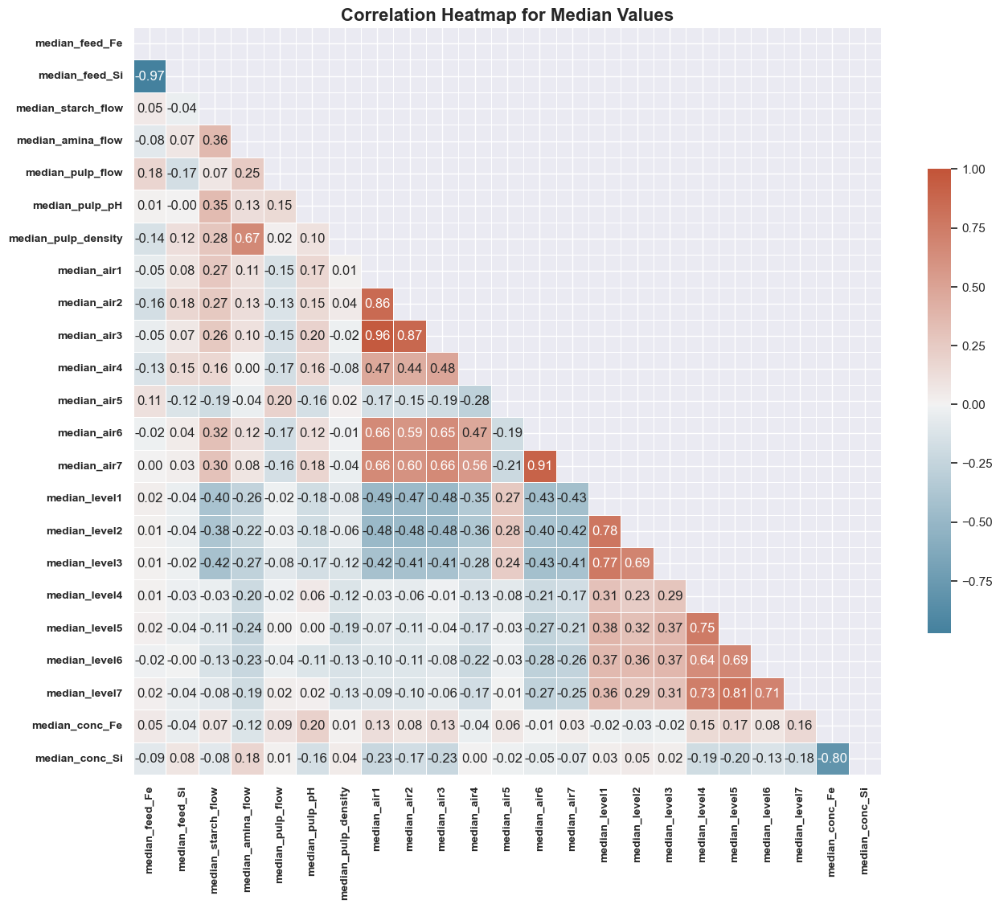

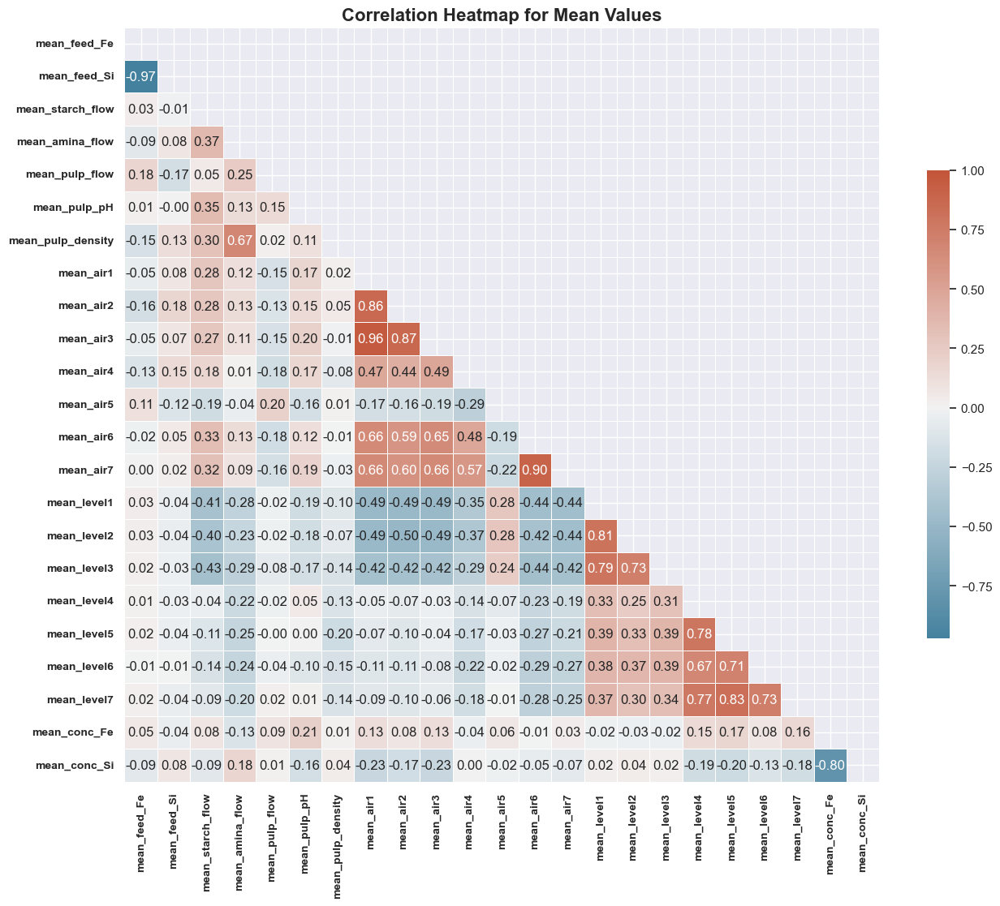

In [29]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Subset the DataFrame to contain only median and mean columns
median_subset = flotation.loc[:, flotation.columns.str.startswith('median_')]
mean_subset = flotation.loc[:, flotation.columns.str.startswith('mean_')]

# Function to plot the correlation heatmap
def plot_correlation_heatmap(data, title):
    # Calculate the correlation matrix
    corr_matrix = data.corr('pearson')
    
    # Create a mask to hide the upper triangle of the heatmap
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    f, ax = plt.subplots(figsize=(15, 15))
    cmap = sns.diverging_palette(230, 20, as_cmap=True)

    # Plot the correlation heatmap
    sns.heatmap(corr_matrix, mask=mask, cmap=cmap, vmax=1,
                center=0, annot=True, square=True,
                linewidths=.5, annot_kws={"fontsize": 12},
                cbar_kws={"shrink": .5}, fmt='.2f')

    # Set x and y axis tick font properties
    plt.xticks(fontsize=10, fontweight='bold')
    plt.yticks(fontsize=10, fontweight='bold')
    plt.title(title, fontsize=16, fontweight='bold')
    plt.show()

# Plot median correlation heatmap
plot_correlation_heatmap(median_subset, "Correlation Heatmap for Median Values")

# Plot mean correlation heatmap
plot_correlation_heatmap(mean_subset, "Correlation Heatmap for Mean Values")


**These correlations reveal:**
- A **highly negative** correlation between **Iron feed** and **Silica Feed** *(both of the process inputs)*
- A **highly negative** correlation between **Iron concentrate** and **Silica Concentrate** *(both of the process outputs from lab measurement)*
- This says that the **higher** the *quality of the iron*, the **less** *silica it contains*

## **3.3. Iron concentrate vs Silica Concentrate**

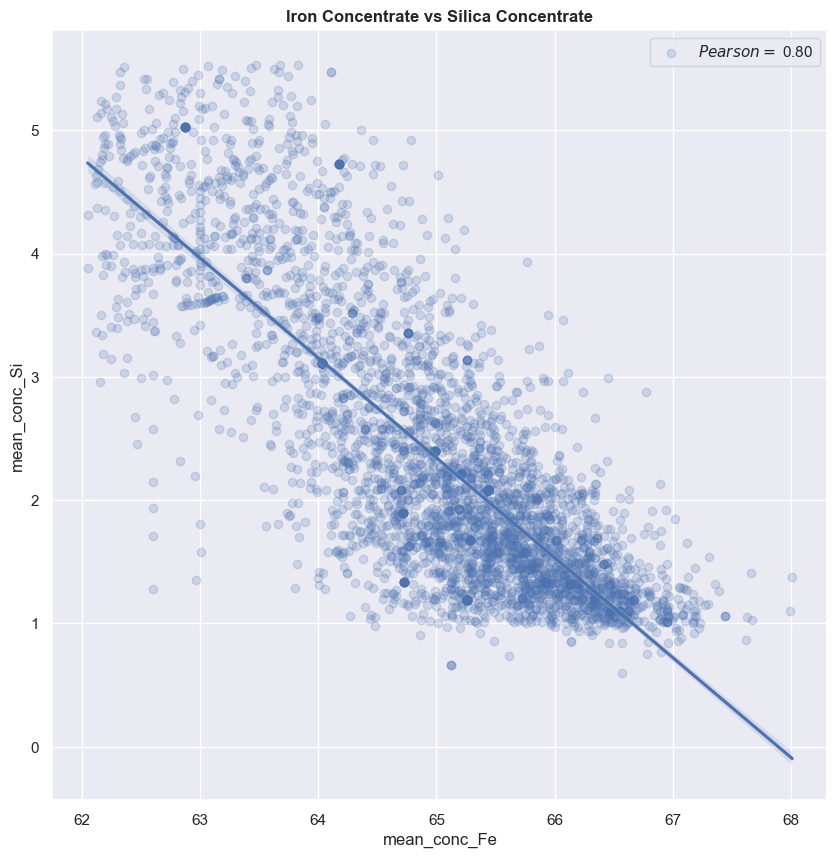

In [30]:
# iron concentrate (target_1) and silica concentrate (target_2) [Pearson = 0.8]
Pearson = 0.80
plt.figure(figsize = (10,10))
sns.regplot(data=flotation, x = 'mean_conc_Fe', y='mean_conc_Si', scatter_kws={'alpha':0.2})
plt.title('Iron Concentrate vs Silica Concentrate', fontsize = 12, fontweight='bold')
plt.legend(['$Pearson=$ {:.2f}'.format(Pearson)], loc = 'best')
plt.show()

Scatter plot shows the relationship between Silica Concentrate and Iron Concentrate in the flotation dataset. The Pearson correlation coefficient of -0.80 indicates a strong negative linear correlation between Silica Concentrate and Iron Concentrate in the flotation dataset.

In this case, as the Silica Concentrate increases, there is a tendency for the Iron Concentrate to decrease. This negative correlation suggests that higher levels of Silica Concentrate in the flotation process are associated with lower levels of Iron Concentrate.

While there may be some outliers in the data, the majority of the data points follow the negative correlation trend. This information is valuable in the context of the flotation process as it helps identify the inverse relationship between Silica Concentrate and Iron Concentrate.

Understanding this negative correlation is important for process optimization. It allows for monitoring and controlling Silica Concentrate levels to minimize their impact on Iron Concentrate production. By managing and reducing Silica Concentrate levels, it may be possible to improve the overall quality and yield of Iron Concentrate.

Scatter plot and the strong negative correlation between Silica Concentrate and Iron Concentrate emphasize the need to effectively control Silica Concentrate levels to enhance the production of Iron Concentrate in the flotation process.

## **3.4. Target Variable (Iron Concnetrate) Statistics**
### **3.4.1. Relationship between target variable (iron Concentrate) and the independant variables**

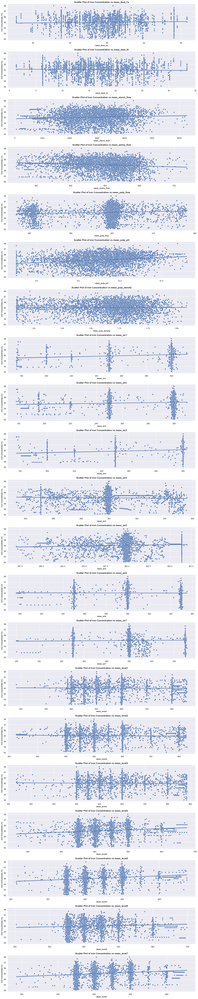

In [31]:
mean_subset = flotation.loc[:, flotation.columns.str.startswith('mean_')]

fig, axs = plt.subplots(21, 1, figsize=(15, 75))
axs = axs.flatten()

for i in range(21):
    col = mean_subset.columns[i]
    # Use 'mean_subset' instead of 'flotation' for data source
    sns.scatterplot(data=mean_subset, x=col, y='mean_conc_Fe', ax=axs[i])
    sns.regplot(data=mean_subset, x=col, y='mean_conc_Fe', ax=axs[i], scatter=False)
    axs[i].set_title(f'Scatter Plot of Iron Concentration vs {col}', fontsize=12, fontweight='bold')
    axs[i].set_xlabel(col, fontsize=10, fontweight='bold')
    axs[i].set_ylabel("Iron Concentrate (%)", fontsize=10, fontweight='bold')

plt.tight_layout()
plt.show()


### **3.4.2. P-values and correlation coefficients of Iron Concentrates vs Features**

             Variable  p-value  Correlation Coefficient
0           mean_air6    0.581                   -0.009
1   mean_pulp_density    0.515                    0.010
2         mean_level1    0.246                   -0.018
3         mean_level3    0.120                   -0.025
4           mean_air7    0.059                    0.030
5         mean_level2    0.054                   -0.031
6           mean_air4    0.016                   -0.038
7        mean_feed_Si    0.007                   -0.043
8        mean_feed_Fe    0.001                    0.054
9           mean_air5    0.000                    0.063
10   mean_starch_flow    0.000                    0.076
11        mean_level6    0.000                    0.077
12          mean_air2    0.000                    0.082
13     mean_pulp_flow    0.000                    0.091
14    mean_amina_flow    0.000                   -0.126
15          mean_air1    0.000                    0.126
16          mean_air3    0.000                  

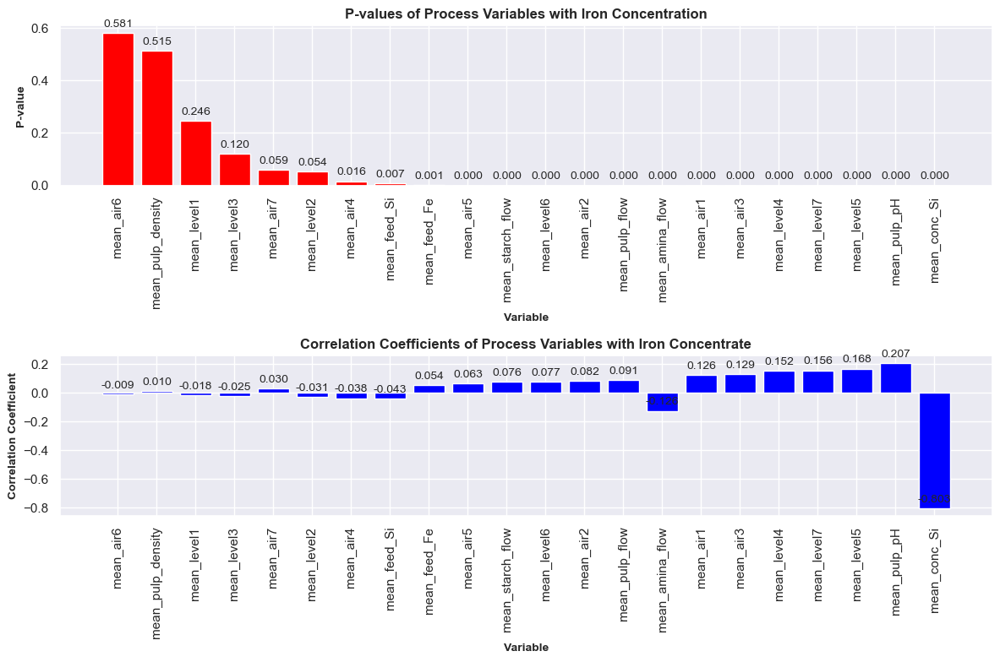

In [32]:
mean_subset = flotation.loc[:, flotation.columns.str.startswith('mean_')]
target_variable = 'mean_conc_Fe'

# Get the list of variables
variables = [col for col in mean_subset.columns if not col.startswith('std')]

correlation_data = []

for variable in variables:
    if variable != target_variable:
        # Calculate the correlation coefficient and p-value between the target variable and the current variable
        correlation_coefficient, p_value = pearsonr(mean_subset[target_variable], mean_subset[variable])
        # Create a DataFrame with the correlation data
        df = pd.DataFrame({
            'Variable': variable,
            'p-value': p_value,
            'Correlation Coefficient': correlation_coefficient,
        }, index=[0])
        # Append the DataFrame to the list
        correlation_data.append(df)

# Concatenate the correlation DataFrames into a single DataFrame
correlation_df = pd.concat(correlation_data, ignore_index=True)

# Sort the correlation DataFrame by the absolute value of the correlation coefficient
correlation_df['p-value'] = np.abs(correlation_df['p-value'])
correlation_df.sort_values('p-value', ascending=False, inplace=True)
correlation_df = correlation_df.round(3)
correlation_df.reset_index(drop=True, inplace=True)

print(correlation_df)

# Plotting the correlation coefficients and p-values
fig, axes = plt.subplots(2, 1, figsize=(12, 8))

# Plotting the p-values
p_value_ax = axes[0].bar(correlation_df['Variable'], correlation_df['p-value'], color='red')
axes[0].set_xlabel('Variable', fontsize = 10, fontweight = 'bold')
axes[0].set_ylabel('P-value', fontsize = 10, fontweight = 'bold')
axes[0].set_title('P-values of Process Variables with Iron Concentration', fontsize=12, fontweight='bold')
axes[0].tick_params(axis='x', rotation=90)

for rect in p_value_ax:
    height = rect.get_height()
    axes[0].annotate(f"{height:.3f}", xy=(rect.get_x() + rect.get_width() / 2, height),
                     xytext=(0, 3), textcoords="offset points", ha='center', va='bottom', fontsize=10)

# Plotting the correlation coefficients
correlation_ax = axes[1].bar(correlation_df['Variable'], correlation_df['Correlation Coefficient'], color='blue')
axes[1].set_xlabel('Variable', fontsize = 10, fontweight = 'bold')
axes[1].set_ylabel('Correlation Coefficient', fontsize = 10, fontweight = 'bold')
axes[1].set_title('Correlation Coefficients of Process Variables with Iron Concentrate', fontsize=12, fontweight='bold')
axes[1].tick_params(axis='x', rotation=90)

for rect in correlation_ax:
    height = rect.get_height()
    axes[1].annotate(f"{height:.3f}", xy=(rect.get_x() + rect.get_width() / 2, height),
                     xytext=(0, 3), textcoords="offset points", ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()

The **correlation analysis** was performed **between** the target variable **Output Iron Concentration** and **the other variables** in the flotation dataset. Here is a discussion of the results:

1. 'conc_Si': The variable 'conc_Si' has a strong negative correlation with 'conc_Fe' (correlation coefficient: -0.803). This suggests that as the concentration of silicon increases, the concentration of iron decreases in the flotation process. The correlation is highly significant (p-value: 0.000). However, this is not very useful as this is an process output variable.

2. 'pulp_pH': There is a moderate positive correlation between 'pulp_pH' and 'conc_Fe' (correlation coefficient: 0.207). This indicates that higher pulp pH values are associated with higher concentrations of iron. The correlation is highly significant (p-value: 0.000).

3. levels 4, - 5 and -7: All have moderate positive correlations with 'conc_Fe'. This suggests that higher levels in these variables are associated with higher concentrations of iron. The correlations are highly significant (p-value: 0.000).

4. 'air1'and 'air3: Have moderate positive correlations with 'conc_Fe'. This suggests that higher flows in these variables are associated with higher concentrations of iron. The correlations are highly significant (p-value: 0.000).

5. 'amina_flow': Has a moderate negative correlation with 'conc_Fe'. This indicates that higher flows in amina flow is associated with lower concentrations of iron. The correlation is highly significant (p-value: 0.000).

6. 'pulp flow': Has a slight positive correlation with 'conc_Fe'. This indicates that higher flows in pulp flow is associated with slightly higher iron concentration. The correlation is highly significant (p-value = 0.000).

7. 'air2': Has a slight positive correlation with 'conc_Fe'. This indicates that higher air flow in tank 2 is associated with slightly higher iron concentration. The correlation is highly significant (p-value = 0.000).

8. 'level6': Has a slight positive correlation with 'conc_Fe'. This indicates that higher levels in tank 6 is associated with slightly higher iron concentration. The correlation is highly significant (p-value = 0.000).

9. 'starch_flow': Has a slight positive correlation with 'conc_Fe'. This indicates that higher flow of starch is associated with higher concentrations of iron. The correlation is highly significant (p-value: 0.000).

10. 'air5': Has a slight positive correlation with 'conc_Fe'. This indicates that higher air flow in tank 5 is associated with slightly higher iron concentration. The correlation is highly significant (p-value = 0.000).

11. 'feed_Fe': The variable 'feed_Fe' has a slight positive correlation with 'conc_Fe' (correlation coefficient: 0.054). This suggests that a higher concentration of iron in the feed is associated with a higher concentration of iron in the flotation process. The correlation is highly significant (p-value: 0.001).

12. 'feed_Si': The variable 'feed_Si' has a slight negative correlation with 'conc_Fe' (correlation coefficient: -0.043). This suggests that a higher concentration of silicone in the feed is associated with a slightly lower concentration of iron in the flotation process. The correlation is highly significant (p-value: 0.007).

13. Other variables: The remaining variables have weaker correlations with 'conc_Fe', with correlation coefficients ranging from -0.009 to 0.03. These correlations are relatively weaker compared to the variables discussed above. However, some of them still show statistical significance (p-value < 0.05).

Overall, the analysis reveals several variables that exhibit significant correlations with the target variable 'conc_Fe'. Understanding these relationships can provide insights into the factors influencing iron concentration in the flotation process.

### **3.4.3. Histogram of Iron Concentrate Distribution**

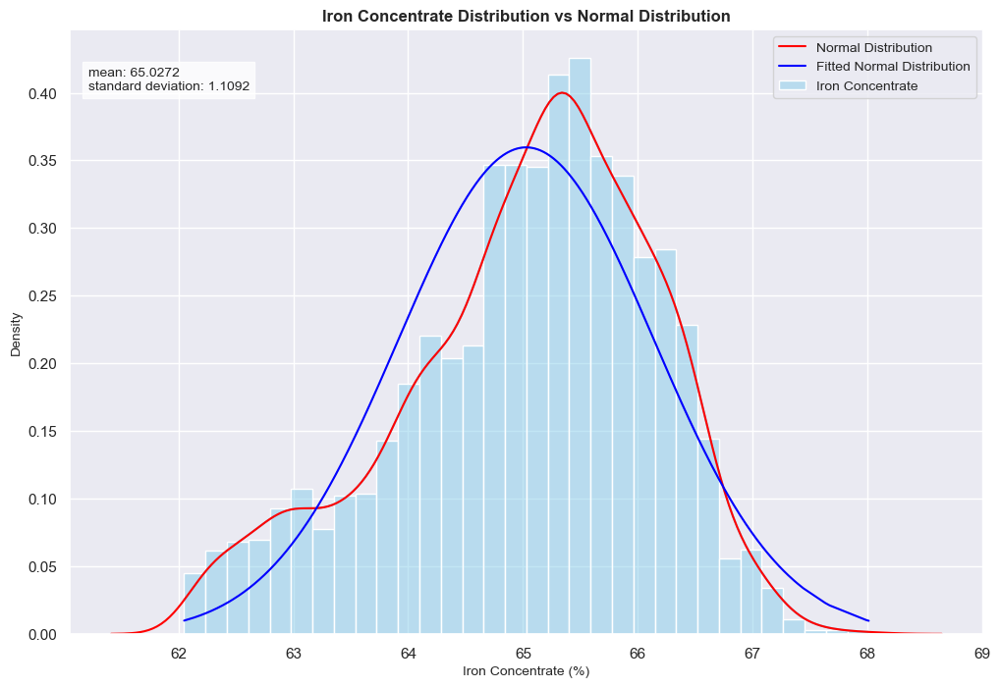

In [33]:
# Fitting normal distribution
(mu, sigma) = norm.fit(flotation['mean_conc_Fe'])

# Plotting the histogram, KDE, and fitted normal distribution
plt.figure(figsize=(12, 8))
sns.histplot(flotation['mean_conc_Fe'], kde=True, stat="density", common_norm=False,
color='skyblue', label='Iron Concentrate')
sns.kdeplot(flotation['mean_conc_Fe'], color='red', label='Normal Distribution')
sns.lineplot(x=flotation['mean_conc_Fe'], y=norm.pdf(flotation['mean_conc_Fe'], mu, sigma),
color='blue', label='Fitted Normal Distribution')

plt.text(0.02, 0.9, f"mean: {mu:.4f}\nstandard deviation: {sigma:.4f}",
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.8), fontsize=10)

plt.title('Iron Concentrate Distribution vs Normal Distribution', fontsize=12, fontweight='bold')
plt.xlabel("Iron Concentrate (%)", fontsize=10)
plt.ylabel("Density", fontsize=10)
plt.legend(fontsize=10)
plt.show()

- Normal distribution to the 'conc_Fe' variable in the 'flotation' dataset and visualizes the distribution using a histogram, KDE plot, and the fitted normal distribution curve. The goal is to assess whether the 'conc_Fe' variable follows a normal distribution.

- Based on the plot, it appears that the 'conc_Fe' variable has a distribution that is relatively symmetric and bell-shaped, which is characteristic of a normal distribution. The fitted normal distribution curve closely aligns with the KDE plot, indicating a good fit. This suggests that the 'conc_Fe' variable can be reasonably approximated by a normal distribution.

- The mean (mu) and standard deviation (sigma) of the fitted normal distribution are calculated as mu = 65.0501 and sigma = 1.1180, respectively. These values provide summary statistics for the central tendency and spread of the data.

- Understanding the distribution of the 'conc_Fe' variable as approximately normal can be valuable in various statistical analyses and modeling tasks. It allows for the application of statistical techniques that assume normality, such as hypothesis testing, confidence intervals, and regression analysis. Additionally, it provides insights into the behavior and characteristics of the 'conc_Fe' variable in the flotation process.

### **3.4.4. Stastistical Tests**
#### **3.4.4.1. Kolmogorov-Smirnov Test**

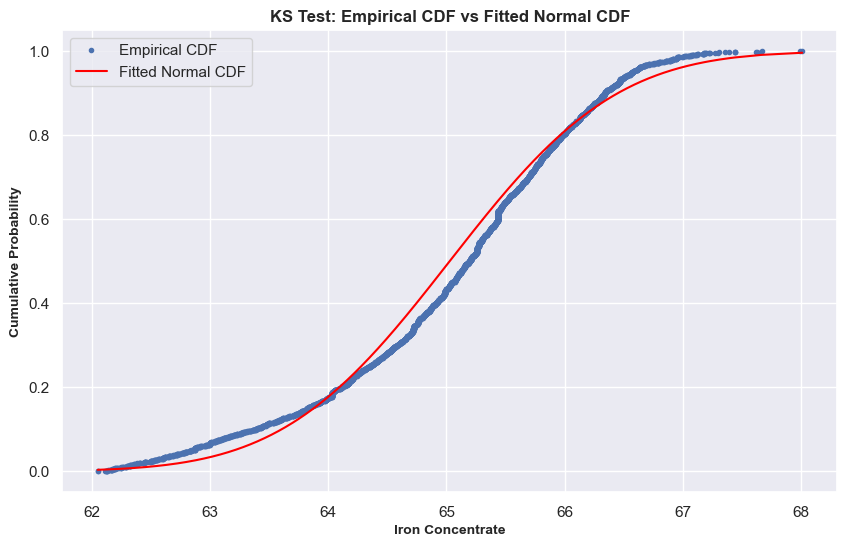

KS Test Statistic: 0.0651
KS Test p-value: 0.0000


In [34]:
from scipy.stats import norm, kstest

# Calculate the ECDF of the data
x = np.sort(flotation['mean_conc_Fe'])
y = np.arange(1, len(x) + 1) / len(x)

# Calculate the CDF of the fitted normal distribution
cdf = norm.cdf(x, mu, sigma)

# Perform the KS test
ks_statistic, ks_pvalue = kstest(x, 'norm', args=(mu, sigma))

# Plot the ECDF, CDF, and KS test results
plt.figure(figsize=(10, 6))
plt.plot(x, y, marker='.', linestyle='none', label='Empirical CDF')
plt.plot(x, cdf, color='red', label='Fitted Normal CDF')
#plt.axvline(x=ks_statistic, color='green', linestyle='--', label=f'KS Statistic: {ks_statistic:.4f}')
plt.xlabel('Iron Concentrate', fontsize = 10, fontweight = 'bold')
plt.ylabel('Cumulative Probability', fontsize = 10, fontweight = 'bold')
plt.title('KS Test: Empirical CDF vs Fitted Normal CDF', fontsize = 12, fontweight = 'bold')
plt.legend()
plt.grid(True)
plt.show()

print(f"KS Test Statistic: {ks_statistic:.4f}")
print(f"KS Test p-value: {ks_pvalue:.4f}")

**The 'conc_Fe' variable does not follow a normal distribution.**

- **KS Test Statistic:**
The KS test statistic is a numerical measure that quantifies the maximum vertical distance between the ECDF and CDF curves. In this case, the computed KS test statistic is 0.0651. A larger KS test statistic suggests a greater discrepancy between the empirical data and the fitted normal distribution.

- **KS Test p-value:**
The p-value is a measure of the strength of evidence against the null hypothesis, which assumes that the 'conc_Fe' variable follows a normal distribution. The p-value calculated by the KS test is 0.0000, indicating an extremely small probability. A smaller p-value suggests stronger evidence to reject the null hypothesis and indicates a significant difference between the empirical data and the fitted normal distribution.

The visual comparison of the ECDF and the fitted normal CDF, along with the relatively large KS test statistic and the very small p-value, indicate **significant deviations between the empirical data and the normal distribution assumption.**

#### **3.4.4.2. Anderson-Darling Test**

Anderson-Darling Test Results:
Test Statistic: 31.5307
Significance Level 15.0:
Critical Value: 0.5750
Reject the null hypothesis

Significance Level 10.0:
Critical Value: 0.6550
Reject the null hypothesis

Significance Level 5.0:
Critical Value: 0.7860
Reject the null hypothesis

Significance Level 2.5:
Critical Value: 0.9170
Reject the null hypothesis

Significance Level 1.0:
Critical Value: 1.0910
Reject the null hypothesis



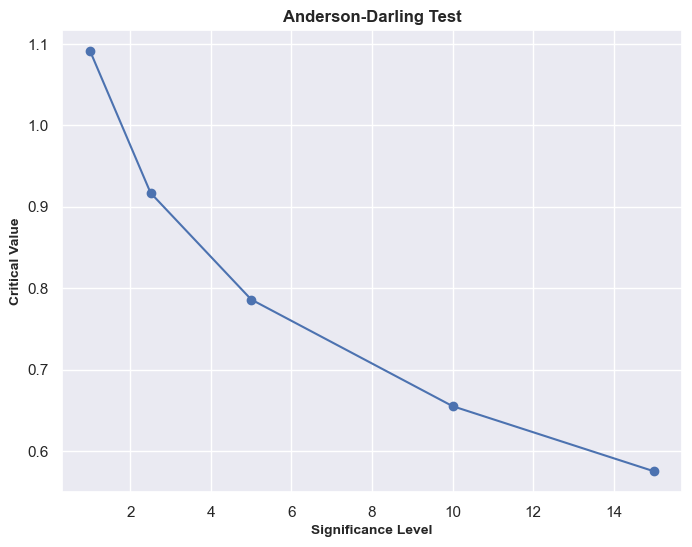

In [35]:
from scipy.stats import anderson

# Perform Anderson-Darling test
result = anderson(flotation['mean_conc_Fe'], dist='norm')

# Extract test statistics and critical values
test_statistic = result.statistic
critical_values = result.critical_values
significance_levels = result.significance_level

# Print the test results
print("Anderson-Darling Test Results:")
print(f"Test Statistic: {test_statistic:.4f}")
for i in range(len(significance_levels)):
    print(f"Significance Level {significance_levels[i]}:")
    print(f"Critical Value: {critical_values[i]:.4f}")
    if test_statistic > critical_values[i]:
        print("Reject the null hypothesis")
    else:
        print("Fail to reject the null hypothesis")
    print()

# Plot the test results
plt.figure(figsize=(8, 6))
plt.plot(significance_levels, critical_values, linestyle='-', marker='o', color='b')
#plt.axhline(test_statistic, color='r', linestyle='--', label='Test Statistic')
plt.xlabel('Significance Level', fontsize = 10, fontweight = 'bold')
plt.ylabel('Critical Value', fontsize = 10, fontweight = 'bold')
plt.title('Anderson-Darling Test', fontsize = 12, fontweight = 'bold')
#plt.legend()
plt.grid(True)
plt.show()

Anderson-Darling test performed on the 'conc_Fe' variable in the flotation dataset to assess whether it follows a normal distribution.

Here are the key findings:

1. Test Statistic:
The Anderson-Darling test statistic is computed as 31.5307. This statistic measures the discrepancy between the observed data and the expected values under the null hypothesis of a normal distribution. A larger test statistic indicates a greater deviation from the normal distribution.

2. Critical Values:
The Anderson-Darling test provides critical values at different significance levels to determine whether the null hypothesis should be rejected. The significance levels considered in this test are 15.0%, 10.0%, 5.0%, 2.5%, and 1.0%. For each significance level, a critical value is calculated to compare against the test statistic.

3. Hypothesis Testing:
For each significance level,  the statistical computation  compares the test statistic with the corresponding critical value. If the test statistic exceeds the critical value, the null hypothesis (the 'conc_Fe' variable follows a normal distribution) is rejected. In this case, the null hypothesis is rejected at all significance levels, as the test statistic (31.5307) exceeds all the critical values.

Based on the Anderson-Darling test results, we can conclude that **the 'conc_Fe' variable does not follow a normal distribution**. The rejection of the null hypothesis at all significance levels suggests significant deviations from the expected distribution.

#### **3.4.4.3. Skewness, Kurtosis, and Shapiro-Wilik Tests**

In [36]:
t,p = stats.shapiro(flotation['mean_conc_Fe'])

print("Skewness: %f" % abs(flotation['mean_conc_Fe']).skew())
print("Kurtosis: %f" % abs(flotation['mean_conc_Fe']).kurt())
print("Shapiro_Test of t: %f" % t)
print("Shapiro_Test of p: %f" % p)

Skewness: -0.536740
Kurtosis: -0.173190
Shapiro_Test of t: 0.972622
Shapiro_Test of p: 0.000000


The results of the Shapiro-Wilk test performed on the 'conc_Fe' variable as well as the skewness and kurtosis values of the 'conc_Fe' variable.

1. Skewness:
The skewness value for the 'conc_Fe' variable is -0.536740. Skewness measures the asymmetry of a distribution. A negative skewness value indicates a longer left tail, suggesting that the distribution is left-skewed.

2. Kurtosis:
The kurtosis value for the 'conc_Fe' variable is -0.173190. Kurtosis measures the heaviness of the tails of a distribution. A kurtosis value close to 0 indicates a normal distribution with similar tail behavior to a standard normal distribution.

3. Shapiro-Wilk Test:
The Shapiro-Wilk test is used to assess the normality of a distribution. The test returns two values: 't' and 'p'. 't' represents the test statistic, and 'p' represents the p-value associated with the test. The null hypothesis of the test is that the data is normally distributed.

4. Shapiro_Test of t:
The Shapiro-Wilk test statistic ('t') for the 'conc_Fe' variable is 0.972628.

5. Shapiro_Test of p:
The p-value ('p') obtained from the Shapiro-Wilk test is 0.000000. Since the p-value is below the significance level of 0.05 (assuming a typical significance level), we reject the null hypothesis. This indicates that the 'conc_Fe' variable does not follow a normal distribution.

Finally, the 'conc_Fe' variable exhibits moderate negative skewness and has a kurtosis value close to 0, indicating a distribution that is relatively close to a standard normal distribution. However, the Shapiro-Wilk test results suggest that **the 'conc_Fe' variable deviates from a normal distribution, as indicated by the low p-value.**

#### **3.4.4.4. Histogram and QQ plot**
**Visualizing the distribution of Iron Concentrate and assess its departure from normality**

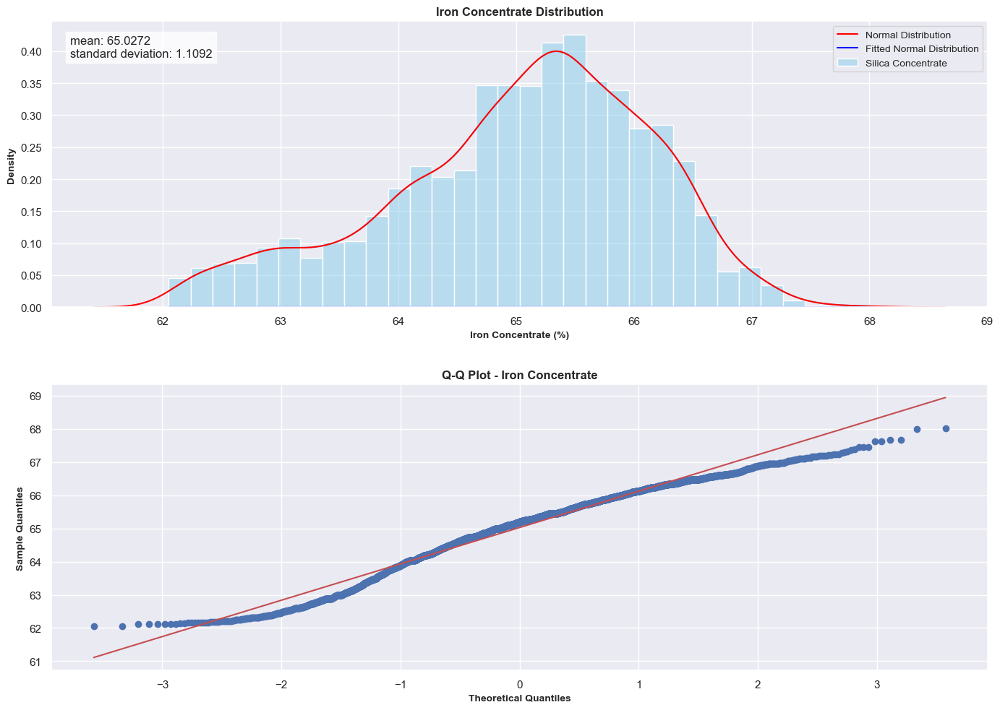

In [37]:
# Fitting normal distribution
(mu, sigma) = norm.fit(flotation['mean_conc_Fe'])

fig, axes = plt.subplots(2, 1, figsize=(14, 10))

# Histogram, KDE, and fitted normal distribution
sns.histplot(flotation['mean_conc_Fe'], kde=True, stat="density", common_norm=False,
             color='skyblue', label='Silica Concentrate', ax=axes[0])
sns.kdeplot(flotation['mean_conc_Fe'], color='red', label='Normal Distribution', ax=axes[0])
sns.lineplot(x=flotation['mean_conc_Fe'], y=norm.pdf(flotation['mean_conc_Si'], mu, sigma),
             color='blue', label='Fitted Normal Distribution', ax=axes[0])

axes[0].text(0.02, 0.95, f"mean: {mu:.4f}\nstandard deviation: {sigma:.4f}", transform=axes[0].transAxes,
             verticalalignment='top',bbox=dict(facecolor='white', alpha=0.8), fontsize=12)

axes[0].set_title('Iron Concentrate Distribution', fontsize=12, fontweight='bold')
axes[0].set_xlabel("Iron Concentrate (%)", fontsize=10, fontweight='bold')
axes[0].set_ylabel("Density", fontsize=10, fontweight='bold')
axes[0].legend(loc='upper right', fontsize=10)

# Q-Q plot
stats.probplot(flotation['mean_conc_Fe'], dist='norm', plot=axes[1])
axes[1].set_title("Q-Q Plot - Iron Concentrate", fontsize=12, fontweight='bold')
axes[1].set_xlabel("Theoretical Quantiles", fontsize=10, fontweight='bold')
axes[1].set_ylabel("Sample Quantiles", fontsize=10, fontweight='bold')

plt.tight_layout(h_pad=2.5)
plt.show()

#### **3.4.4.5. Log transformation**
**Preforms a log transformation and fit the distribution of Iron Concentrate. Hope to get gaussian distribution after transformation**

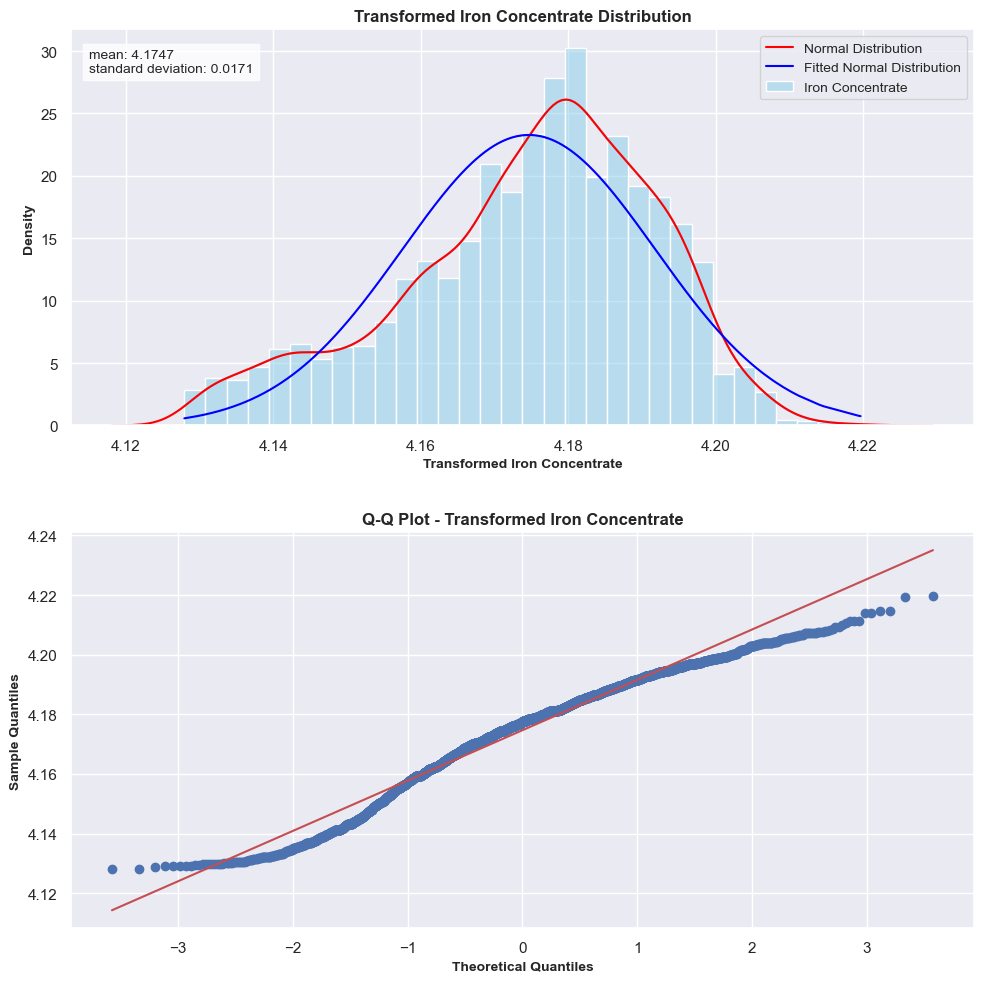

Skewness: -0.5763
Kurtosis: -0.1283
Shapiro-Wilk test:
  - Test statistic: 0.9697
  - p-value: 0.0000


In [38]:
# Log transformation
transformed_conc = np.log(flotation['mean_conc_Fe'])

# Fitting normal distribution
(mu, sigma) = norm.fit(transformed_conc)

fig, axes = plt.subplots(2, 1, figsize=(10, 10))

# Histogram and KDE plot
sns.histplot(transformed_conc, kde=True, stat="density", common_norm=False,
             color='skyblue', label='Iron Concentrate', ax=axes[0])
sns.kdeplot(transformed_conc, color='red', label='Normal Distribution', ax=axes[0])
sns.lineplot(x=transformed_conc, y=norm.pdf(transformed_conc, mu, sigma),
             color='blue', label='Fitted Normal Distribution', ax=axes[0])

axes[0].set_title('Transformed Iron Concentrate Distribution', fontsize=12, fontweight='bold')
axes[0].set_xlabel("Transformed Iron Concentrate", fontsize=10, fontweight='bold')
axes[0].set_ylabel("Density", fontsize=10, fontweight='bold')
axes[0].legend(loc='upper right', fontsize=10)

axes[0].text(0.02, 0.95, f"mean: {mu:.4f}\nstandard deviation: {sigma:.4f}", transform=axes[0].transAxes,
             verticalalignment='top', bbox=dict(facecolor='white', alpha=0.8), fontsize=10)

# Q-Q plot for transformed data
stats.probplot(transformed_conc, dist='norm', plot=axes[1])
axes[1].set_title("Q-Q Plot - Transformed Iron Concentrate", fontsize=12, fontweight='bold')
axes[1].set_xlabel("Theoretical Quantiles", fontsize=10, fontweight='bold')
axes[1].set_ylabel("Sample Quantiles", fontsize=10, fontweight='bold')

plt.tight_layout(h_pad=2.5)
plt.show()

# Calculate skewness and kurtosis
skewness = transformed_conc.skew()
kurtosis = transformed_conc.kurt()

# Shapiro-Wilk test
shapiro_test = stats.shapiro(transformed_conc)
shapiro_t = shapiro_test.statistic
shapiro_p = shapiro_test.pvalue

print("Skewness: %.4f" % skewness)
print("Kurtosis: %.4f" % kurtosis)
print("Shapiro-Wilk test:")
print("  - Test statistic: %.4f" % shapiro_t)
print("  - p-value: %.4f" % shapiro_p)

**Effect of Log transformation on Iron Concentrate**

Before Transformation:
- Skewness: -0.536740
- Kurtosis: -0.173190
- Shapiro-Wilk test: Test statistic: 0.972628, p-value: 0.000000

After Log Transformation:
- Skewness: -0.5763
- Kurtosis: -0.1283
- Shapiro-Wilk test: Test statistic: 0.9697, p-value: 0.0000

Before the log transformation, the variable 't' had negative skewness (-0.536740), indicating a longer left tail. The kurtosis was negative as well (-0.173190), suggesting a distribution that is less peaked than a normal distribution. The Shapiro-Wilk test indicated a departure from normality with a test statistic of 0.972628 and a p-value of 0.000000.

After applying the log transformation to 't', the skewness decreased to -0.5763, indicating a slight reduction in the left tail. The kurtosis decreased to -0.1283, suggesting a distribution that is closer to a normal distribution in terms of peakedness. However, despite the transformation, the Shapiro-Wilk test still indicated a departure from normality with a test statistic of 0.9697 and a p-value of 0.0000.

In summary, the log transformation improved the skewness and kurtosis of the variable 't', making the distribution slightly more symmetric and less platykurtic. However, the transformed data still deviates from a normal distribution based on the Shapiro-Wilk test.

#### **3.4.4.6. Confidence interval of Iron Concentrate**

Bootstrap Confidence Interval:
Lower Bound: 64.99227142333984
Upper Bound: 65.06167602539062


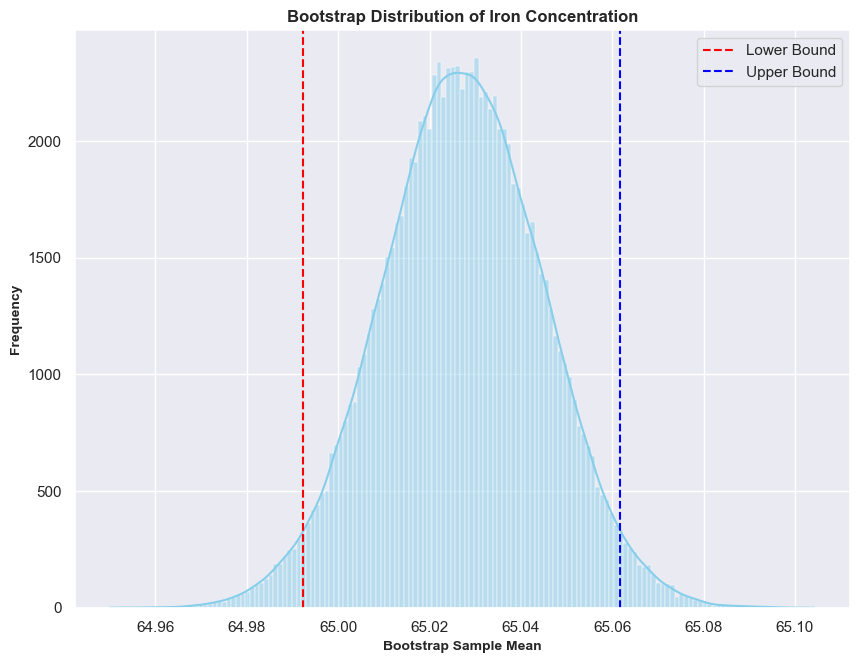

In [39]:
column_data = flotation["mean_conc_Fe"].values

num_iterations = 100000
confidence_level = 0.95

# Create an empty array to store the bootstrap sample means
bootstrap_means = np.empty(num_iterations)

# Perform the bootstrap sampling
for i in range(num_iterations):
    # Generate a bootstrap sample by sampling with replacement
    bootstrap_sample = np.random.choice(column_data,
                       size=len(column_data), replace=True)
    # Calculate the mean of the bootstrap sample
    bootstrap_means[i] = np.mean(bootstrap_sample)

# Sort the bootstrap means and calculate the lower and upper percentiles
sorted_means = np.sort(bootstrap_means)
lower_percentile = (1 - confidence_level) / 2
upper_percentile = 1 - lower_percentile

# Calculate the confidence interval
lower_bound = sorted_means[int(lower_percentile * num_iterations)]
upper_bound = sorted_means[int(upper_percentile * num_iterations)]

print("Bootstrap Confidence Interval:")
print("Lower Bound:", lower_bound)
print("Upper Bound:", upper_bound)

# Plot the bootstrap distribution
plt.figure(figsize=(10, 7.5))
sns.histplot(bootstrap_means, kde=True, color='skyblue')
plt.axvline(lower_bound, color='red', linestyle='--', label='Lower Bound')
plt.axvline(upper_bound, color='blue', linestyle='--', label='Upper Bound')
plt.xlabel('Bootstrap Sample Mean',
          fontsize=10, fontweight='bold')
plt.ylabel('Frequency',
          fontsize=10, fontweight='bold')
plt.title('Bootstrap Distribution of Iron Concentration',
          fontsize=12, fontweight='bold')
plt.legend()
plt.show()

The bootstrap confidence interval provides an estimate of the range in which we can be confident the true population mean of the Iron Concentrate lies. In this case, the confidence level chosen is 95%, which means that we can be 95% confident that the true population mean falls within the calculated interval.

The lower bound of the confidence interval is 64.9924, and the upper bound is 65.0619. This indicates that we are 95% confident that the true population mean of the Iron Concentrate is between these two values.

The histogram of the bootstrap means provides a visual representation of the bootstrap distribution. The distribution appears to be approximately symmetric and centered around the sample mean. The shape of the distribution can provide insights into the sampling variability and the uncertainty associated with the sample mean estimation.

The dashed lines in the histogram mark the lower and upper bounds of the confidence interval. These lines help visualize the range of values within which we have 95% confidence that the true population mean lies. The fact that the bounds are relatively close to the sample mean suggests that the sample mean is a reasonable estimate of the true population mean.

By using the bootstrap resampling method, we account for the uncertainty in estimating the population mean from a single sample. The bootstrap procedure allows us to generate multiple resamples, calculate their means, and then estimate the variability of the sample mean.

Overall, the bootstrap confidence interval provides a measure of uncertainty around the estimated mean of the Iron Concentrate. It gives us a range of values within which the true population mean is likely to fall, based on the available sample data.

# **4. EDA V2 (More Thorough EDA on transformed dataset)**

## **4.1. Descriptive Statistics**
Purpose: To get an overview of the data distribution, central tendency, and variability.

Methods:

- Summary Statistics: Mean, median, standard deviation, minimum, maximum, and quartiles.
- Skewness and Kurtosis: To understand the asymmetry and tail behavior of the data distribution.

In [40]:
flotation_no_std = flotation.loc[:, ~flotation.columns.str.startswith('std_')]
flotation_desctiptive_stats_aggregated = flotation_no_std.describe().T
flotation_desctiptive_stats_aggregated.to_excel("Flotation Data.xlsx", "stats_cut", float_format = "%.3f")
print(flotation_desctiptive_stats_aggregated)
print("________________________________________________________________")
print()
print(flotation_no_std.skew())
print("________________________________________________________________")
print()
print(flotation_no_std.kurtosis())

                      count         mean          std         min  \
mean_feed_Fe         3948.0    56.220303     5.231150   42.740002   
mean_feed_Si         3948.0    14.767789     6.887711    1.310000   
mean_starch_flow     3948.0  2847.013184   948.913513   54.595482   
mean_amina_flow      3948.0   488.720673    83.769852  242.927475   
mean_pulp_flow       3948.0   397.471405     8.491449  376.837585   
mean_pulp_pH         3948.0     9.769642     0.378012    8.753389   
mean_pulp_density    3948.0     1.679042     0.063417    1.519926   
mean_air1            3948.0   281.287415    29.361843  175.885574   
mean_air2            3948.0   278.182037    29.490105  178.188431   
mean_air3            3948.0   282.253113    28.244196  177.202667   
mean_air4            3948.0   299.612000     2.317443  293.336670   
mean_air5            3948.0   299.673248     3.143090  287.056458   
mean_air6            3948.0   293.659271    28.978373  196.512085   
mean_air7            3948.0   292.

## **4.2. Data Visualization**
Purpose: To visually inspect the data, detect anomalies, and understand relationships between variables.

Methods:

- Histograms: To visualize the distribution of each variable.
- Box Plots: To identify outliers and understand the spread and skewness of the data.
- Heatmaps: To visualize correlations between variables.
- Pair Plots: To examine relationships between pairs of variables

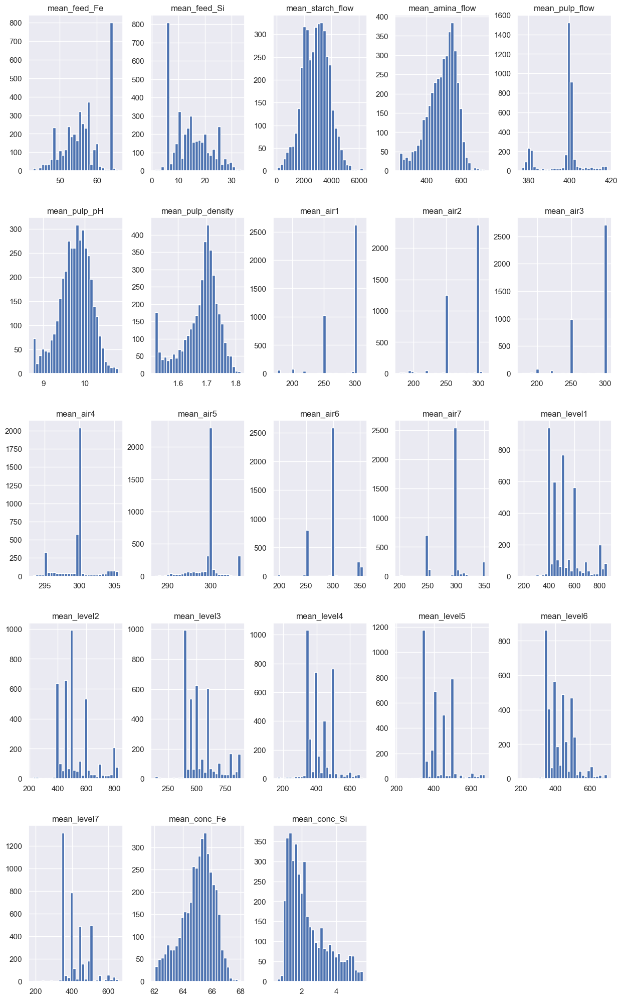

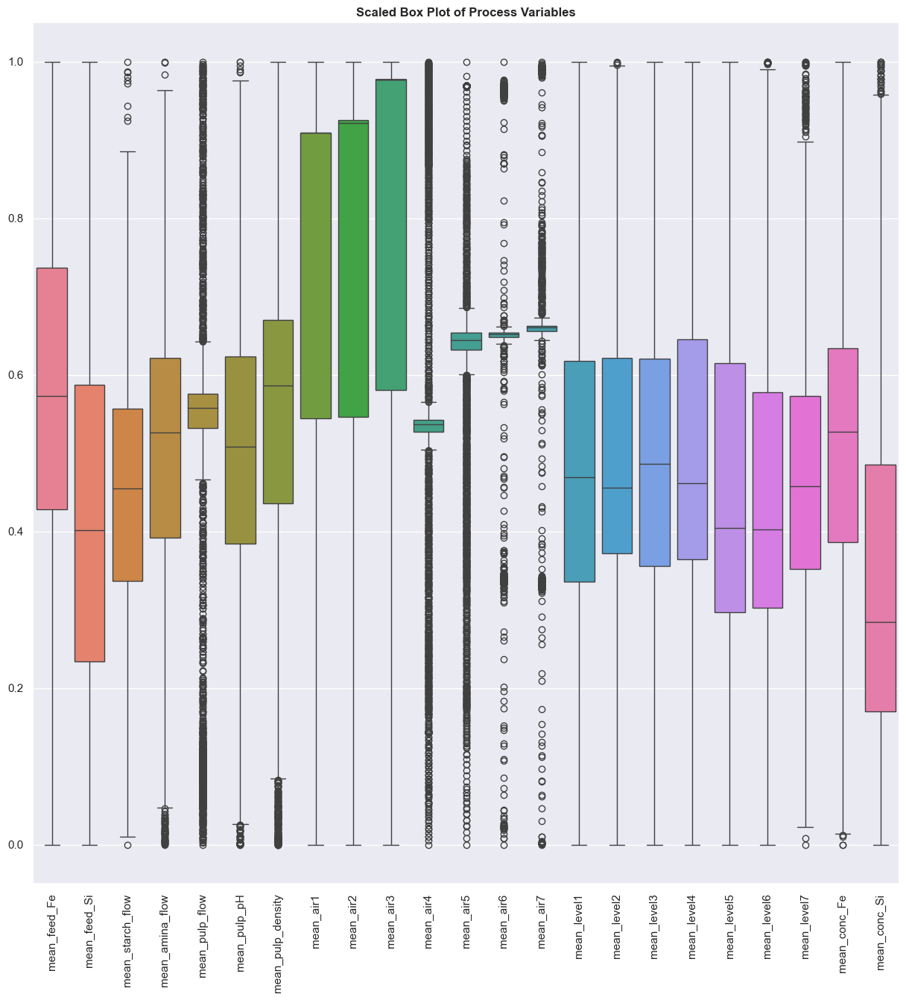

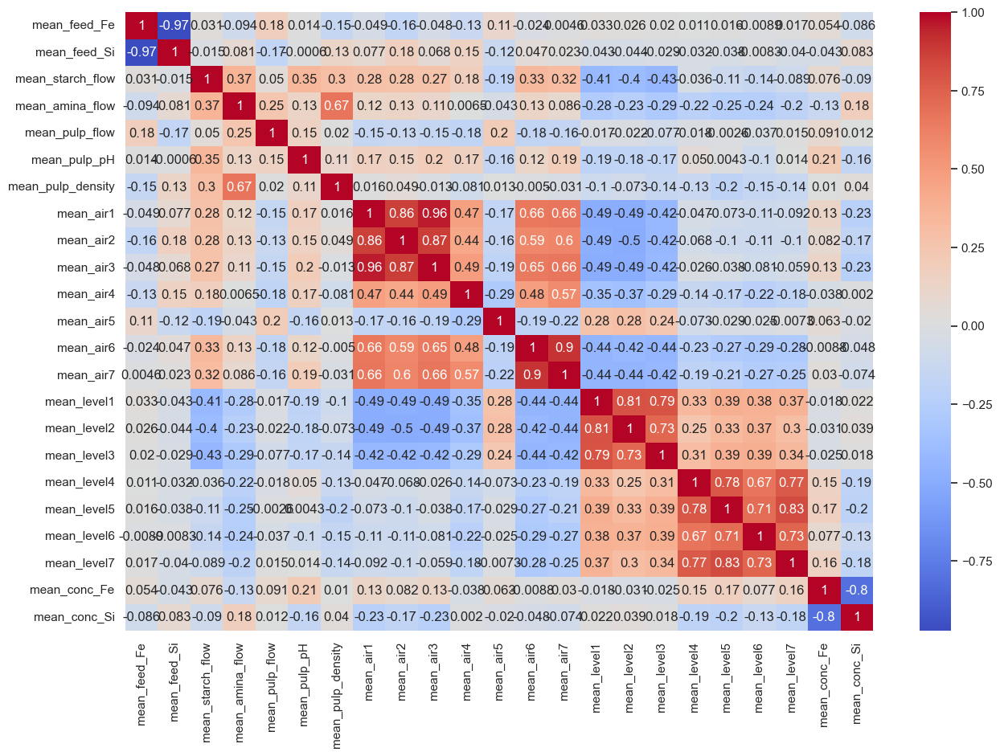

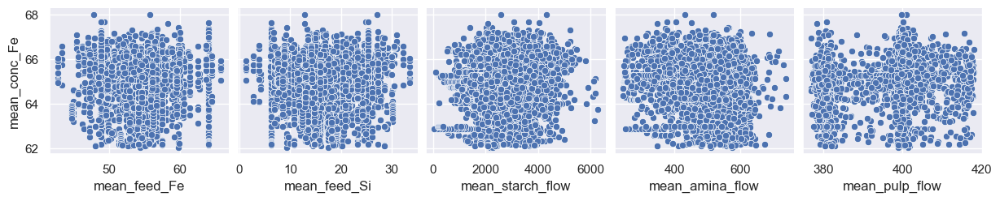

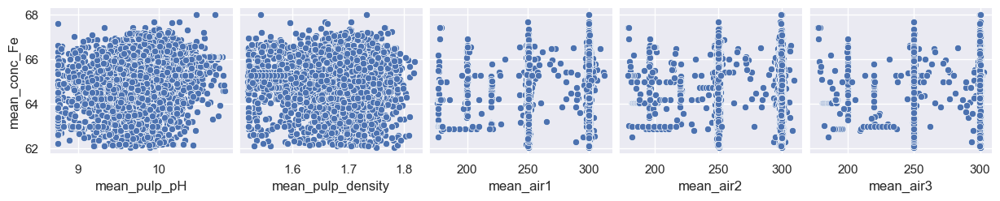

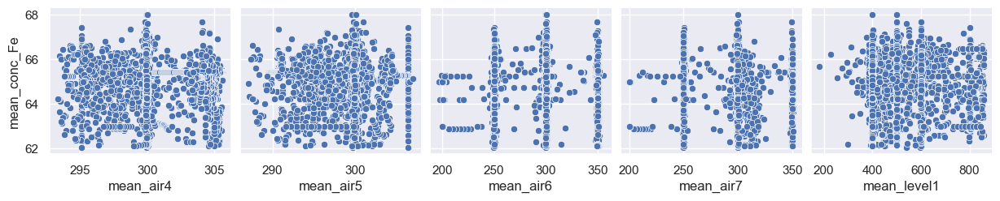

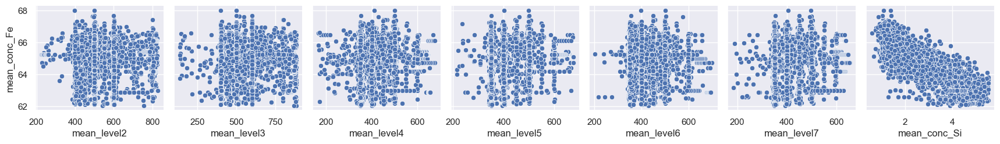

In [41]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import pandas as pd

mean_subset = flotation.loc[:, flotation.columns.str.startswith('mean_')]

# Histograms
mean_subset.hist(bins=30, figsize=(15, 25))
plt.title("Histograms of the Distribution of Process Variables")
plt.show()

# Box Plots
# Create a MinMaxScaler instance
scaler = MinMaxScaler()

# Apply MinMax scaling to the data
flotation_scaled = pd.DataFrame(scaler.fit_transform(mean_subset), columns=mean_subset.columns)

# Plot Box Plots
plt.figure(figsize=(15, 15))
sns.boxplot(data=flotation_scaled)
plt.xticks(rotation=90)
plt.title("Scaled Box Plot of Process Variables", fontsize=12, fontweight='bold')
plt.show()

# Correlation Heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(mean_subset.loc[:, ~mean_subset.columns.str.startswith('std_')].corr(), annot=True, cmap='coolwarm')
plt.show()


# Pair Plot for `conc_Fe` with other mean columns, split into four plots
# Using `flotation_no_std` as the DataFrame without the standard deviation columns
mean_columns = mean_subset.columns.tolist()
mean_columns.remove('mean_conc_Fe')  # Remove the target variable from the list

num_splits = 4  # Number of groups to split the columns into
split_size = len(mean_columns) // num_splits

# Split the columns into four groups ensuring all columns are included
split_columns = [mean_columns[i * split_size: (i + 1) * split_size] for i in range(num_splits - 1)]
split_columns.append(mean_columns[(num_splits - 1) * split_size:])

# Generate pair plots for each group
for i, cols in enumerate(split_columns):
    sns.pairplot(mean_subset, x_vars=cols, y_vars=['mean_conc_Fe'])
    #plt.title(f'Pair Plot Group {i+1}', fontsize=12, fontweight='bold')
    plt.show()


## **4.3. Time Series Analysis**
Purpose: Since the data is likely time-dependent, understanding trends, seasonality, and cycles is crucial.

Methods:

- Line Plots: To visualize trends over time.
- Seasonal Decomposition: To decompose the time series into trend, seasonal, and residual components.
- Autocorrelation and Partial Autocorrelation: To understand the lag relationships

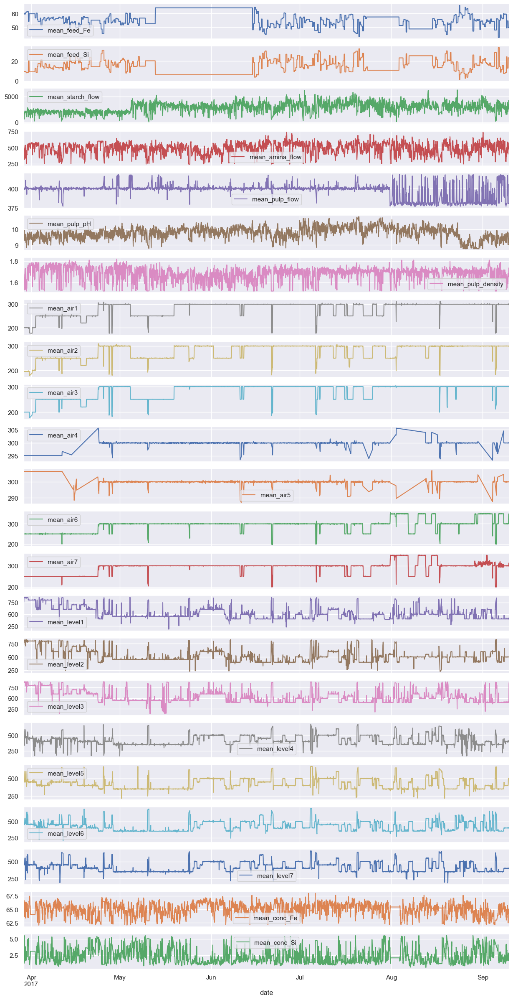

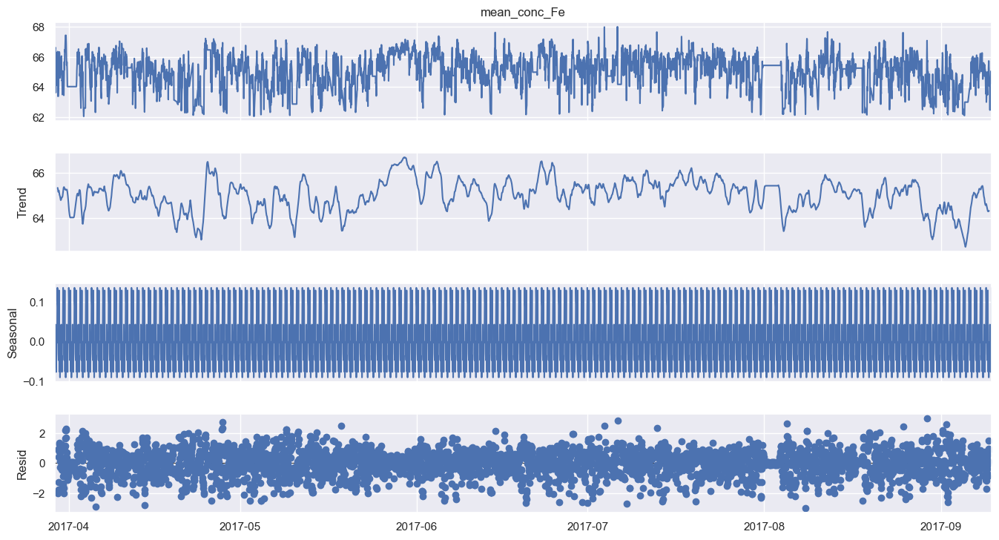

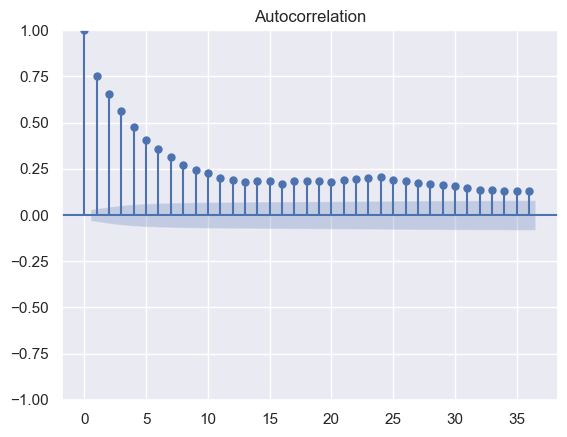

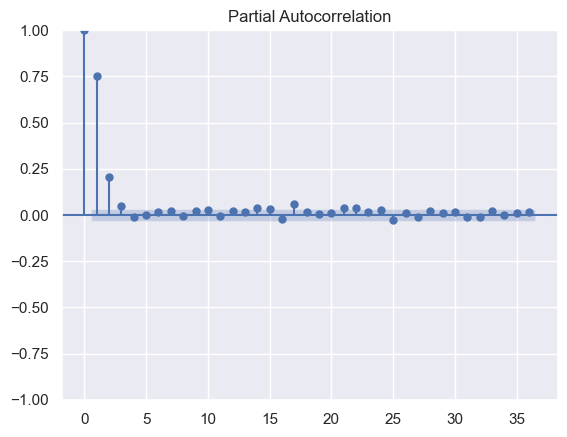

In [42]:
mean_subset = flotation.loc[:, flotation.columns.str.startswith('mean_')]
# Line Plots for all variables
mean_subset.plot(subplots=True, figsize=(15, 30))
plt.show()

# Seasonal Decomposition
from statsmodels.tsa.seasonal import seasonal_decompose

result = seasonal_decompose(flotation['mean_conc_Fe'], model='additive', period=24)
fig = result.plot()
fig.set_size_inches(15, 8)
plt.show()

# Autocorrelation and Partial Autocorrelation
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plot_acf(flotation['mean_conc_Fe'])
plot_pacf(flotation['mean_conc_Fe'])
plt.show()

## **4.4. Feature Engineering and Selection**

Purpose: To create new features that might capture underlying physics principles and improve model performance.

Methods:

- Domain-Specific Features: Based on understanding of the flotation process.
- Lag Features: To capture temporal dependencies.
- Rolling Statistics: Mean, standard deviation, min, max over rolling windows.

In [43]:
import pandas as pd
import numpy as np

# Assuming 'flotation' already contains hourly mean, median, and standard deviation columns
# Create a copy of the DataFrame to add lag features and rolling statistics
flotation_augmented = flotation.copy()

# Feature Engineering: Create Lag Features for 'mean_', 'median_', and 'std_' columns
for prefix in ['mean_', 'median_', 'std_']:
    target_col = f'{prefix}conc_Fe'  # Assuming 'conc_Fe' is the target variable for each statistic
    if target_col in flotation.columns:
        # Create lag features for each target column
        for lag in range(1, 6):
            flotation_augmented[f'{target_col}_lag_{lag}'] = flotation_augmented[target_col].shift(lag)

        # Create rolling mean and rolling std for each target column
        flotation_augmented[f'{target_col}_roll_mean'] = flotation_augmented[target_col].rolling(window=5).mean()
        flotation_augmented[f'{target_col}_roll_std'] = flotation_augmented[target_col].rolling(window=5).std()

# Optional: Clean up the DataFrame by removing rows with NaN values generated due to shifting and rolling operations
flotation_augmented.dropna(inplace=True)

# Display the first few rows to check the results
flotation_augmented.head().T


date,2017-03-29 17:00:00,2017-03-29 18:00:00,2017-03-29 19:00:00,2017-03-29 20:00:00,2017-03-29 21:00:00
mean_feed_Fe,59.540001,59.540001,59.540001,59.540001,59.540001
mean_feed_Si,9.560000,9.560000,9.560000,9.560000,9.560000
mean_starch_flow,1729.412720,1639.599121,1913.013672,2033.815796,2213.602783
mean_amina_flow,410.978729,460.216797,495.235077,500.493195,530.642578
mean_pulp_flow,400.036102,399.255371,399.948303,400.512512,400.355042
...,...,...,...,...,...
std_conc_Fe_lag_3,0.000000,0.000000,0.000000,0.000000,0.000000
std_conc_Fe_lag_4,0.000000,0.000000,0.000000,0.000000,0.000000
std_conc_Fe_lag_5,0.000000,0.000000,0.000000,0.000000,0.000000
std_conc_Fe_roll_mean,0.000000,0.000000,0.000000,0.000000,0.000000


## **4.5. Correlation and Multicollinearity Analysis**
Purpose: To identify highly correlated features and assess multicollinearity which can impact model performance.

Methods:

- Correlation Matrix: To identify highly correlated features.
- Variance Inflation Factor (VIF): To assess multicollinearity.

In [44]:
flotation_no_std = flotation.loc[:, ~flotation.columns.str.startswith('std_')]
# Correlation Matrix
corr_matrix = flotation_no_std.corr()
print("CORRELATION MATRIX")
print(corr_matrix)
print("__________________________________________")
print()

# Variance Inflation Factor (VIF)

from statsmodels.stats.outliers_influence import variance_inflation_factor

# Calculating Variance Inflation Factor VIF for each feature
vif_data = pd.DataFrame()
vif_data["feature"] = flotation_no_std.columns
vif_data["VIF"] = [variance_inflation_factor(flotation_no_std.values, i) for i in range(len(flotation_no_std.columns))]
print(vif_data)

CORRELATION MATRIX
                     mean_feed_Fe  mean_feed_Si  mean_starch_flow  \
mean_feed_Fe             1.000000     -0.972047          0.030933   
mean_feed_Si            -0.972047      1.000000         -0.014637   
mean_starch_flow         0.030933     -0.014637          1.000000   
mean_amina_flow         -0.093785      0.081443          0.365694   
mean_pulp_flow           0.182895     -0.170492          0.049626   
mean_pulp_pH             0.014026     -0.000599          0.352483   
mean_pulp_density       -0.148803      0.126092          0.299222   
mean_air1               -0.049256      0.077022          0.280294   
mean_air2               -0.163703      0.175415          0.275554   
mean_air3               -0.048144      0.068119          0.271855   
mean_air4               -0.128376      0.150366          0.182847   
mean_air5                0.112857     -0.118479         -0.187078   
mean_air6               -0.023938      0.046859          0.333333   
mean_air7      

## **4.6. Anomaly Detection**
Purpose: To detect anomalies in the data that could affect model training and prediction.

Methods:

- Isolation Forest: To identify anomalies in the dataset.
- Z-score: To identify outliers based on standard deviations from the mean.

In [45]:
flotation_no_std = flotation.loc[:, ~flotation.columns.str.startswith('std_')]
flotation_no_std.isna()

,mean_feed_Fe,mean_feed_Si,mean_starch_flow,mean_amina_flow,mean_pulp_flow,mean_pulp_pH,mean_pulp_density,mean_air1,mean_air2,mean_air3,...,median_air7,median_level1,median_level2,median_level3,median_level4,median_level5,median_level6,median_level7,median_conc_Fe,median_conc_Si
date,,,,,,,,,,,,,,,,,,,,,
2017-03-29 12:00:00,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2017-03-29 13:00:00,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2017-03-29 14:00:00,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2017-03-29 15:00:00,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2017-03-29 16:00:00,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-09-09 19:00:00,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2017-09-09 20:00:00,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2017-09-09 21:00:00,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [46]:

from sklearn.ensemble import IsolationForest

iso = IsolationForest(contamination=0.01)
yhat = iso.fit_predict(mean_subset)
mask = yhat != -1
flotation_cleaned = mean_subset[mask]
print("Isolation Forest: Number of anomalies detected:", len(mean_subset) - len(flotation_cleaned))

# Z-score
from scipy import stats

z_scores = stats.zscore(mean_subset)
abs_z_scores = np.abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
flotation_cleaned = mean_subset[filtered_entries]
print("Isolation Forest: Number of anomalies detected:", len(mean_subset) - len(flotation_cleaned))

Isolation Forest: Number of anomalies detected: 40
Isolation Forest: Number of anomalies detected: 235


# **5. Modelling**


## **5.1. Splitting Dataset**
**Split dataset as X and Y**
**Split dataset into training, validation, and testing**

In [47]:
# Scale data
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(flotation_augmented)

# Create sequences
def create_sequences(data, seq_length):
    xs = []
    ys = []
    for i in range(len(data) - seq_length):
        x = data[i:i+seq_length]
        y = data[i+seq_length][flotation_augmented.columns.get_loc("mean_conc_Fe")]  # Update target variable location based on new columns
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

SEQ_LENGTH = 10  # Length of the sequences
X, y = create_sequences(scaled_data, SEQ_LENGTH)

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

**Setting up functions to:**
- **Print Model Weights**
- **Plot unnormalized predictions**

In [48]:
# Function to print model weights
def tabulate_model_weights(model):
    layers_weights = []
    for layer in model.layers:
        weights = layer.get_weights()
        if weights:
            for i, weight_matrix in enumerate(weights):
                weight_df = pd.DataFrame(weight_matrix)
                weight_df.columns = [f'{layer.name}_W{i}_{col}' for col in weight_df.columns]
                layers_weights.append(weight_df)
    return pd.concat(layers_weights, axis=1)

# Inverse transform function for a specific column
def inverse_transform_column(scaled_column, scaler, column_index):
    """
    Inverse transform a specific column from scaled data.
    
    Args:
        scaled_column (numpy.ndarray): Scaled data for the specific column.
        scaler (MinMaxScaler): The scaler used for scaling the data.
        column_index (int): The index of the column to inverse transform.
        
    Returns:
        numpy.ndarray: Inverse transformed data for the specific column.
    """
    dummy_data = np.zeros((scaled_column.shape[0], scaler.data_max_.shape[0]))
    dummy_data[:, column_index] = scaled_column.squeeze()
    inversed_data = scaler.inverse_transform(dummy_data)
    return inversed_data[:, column_index]

# Predict and plot function
def plot_predictions(model, X_test, y_test, scaler, label, column_index):
    """
    Plot the original vs predicted values.
    
    Args:
        model (Model): Trained model for predictions.
        X_test (numpy.ndarray): Test features.
        y_test (numpy.ndarray): Test target values.
        scaler (MinMaxScaler): The scaler used for scaling the data.
        label (str): Label for the plot.
        column_index (int): The index of the column to inverse transform.
    """
    # Predict
    y_pred = model.predict(X_test)
    
    # Inverse transform
    y_test_inv = inverse_transform_column(y_test, scaler, column_index)
    y_pred_inv = inverse_transform_column(y_pred, scaler, column_index)
    
    # Plotting original vs predicted values
    plt.figure(figsize=(25, 6))
    plt.plot(y_test_inv, label='Original')
    plt.plot(y_pred_inv, label='Predicted')
    plt.title(f'{label} - Iron Concentration', fontsize = 12, fontweight = 'bold')
    plt.xlabel('Time', fontsize = 10, fontweight = 'bold')
    plt.ylabel('Iron Concentration', fontsize = 10, fontweight = 'bold')
    plt.legend()
    plt.show()


## **5.2. Base Models**

### **5.2.1. LSTM1**

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 10, 50)         │        27,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 50)             │        20,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            51 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 48,051 (187.70 KB)

 Trainable params: 48,051 (187.70 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 20ms/step - loss: 0.0248 - val_loss: 0.0128
Epoch 2/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0119 - val_loss: 0.0108
Epoch 3/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0095 - val_loss: 0.0096
Epoch 4/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0082 - val_loss: 0.0082
Epoch 5/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0080 - val_loss: 0.0096
Epoch 6/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0070 - val_loss: 0.0087
Epoch 7/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0070 - val_loss: 0.0079
Epoch 8/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0073 - val_loss: 0.0081
Epoch 9/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0070 - val_loss: 0.0078
Epoch 10/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0070 - val_loss: 0.0077
Epoch 11/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0068 - val_loss: 0.0074
Epoch 12/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.0

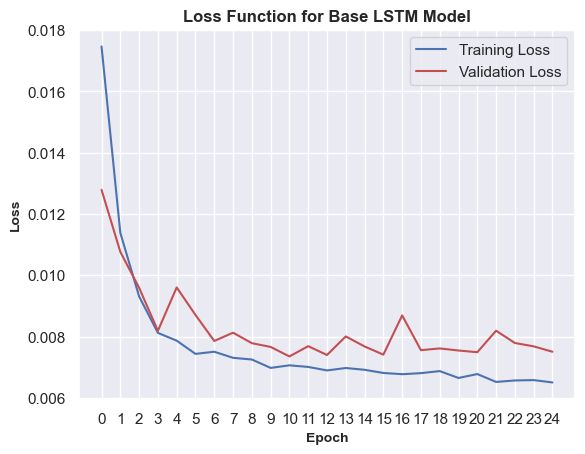

In [49]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Build LSTM model
model_lstm_base = Sequential([
    LSTM(50, return_sequences=True, input_shape=(SEQ_LENGTH, X_train.shape[2])),
    LSTM(50),
    Dense(1)
    ])

model_lstm_base.compile(optimizer='adam', loss='huber')
model_lstm_base.summary()

# Train the model
history_lstm = model_lstm_base.fit(X_train, y_train, epochs=25, batch_size=32, validation_split=0.2)

# Evaluate the model
loss_lstm = model_lstm_base.evaluate(X_test, y_test)
print(f'Test Loss for Base LSTM: {loss_lstm}')

ax = plt.axes()
plt.plot(history_lstm.history['loss'], color = 'b', label = "Training Loss")
plt.plot(history_lstm.history['val_loss'], color = 'r', label = 'Validation Loss')
plt.xlabel("Epoch", fontsize = 10, fontweight ='bold')
plt.ylabel("Loss", fontsize = 10, fontweight ='bold')
ax.set_xticks(np.arange(0, len(history_lstm.history['loss'])))
plt.title("Loss Function for Base LSTM Model", fontsize = 12, fontweight = 'bold')
plt.legend(loc = 'best')
plt.show()



**Base LSTM Model Predictions:**

25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step


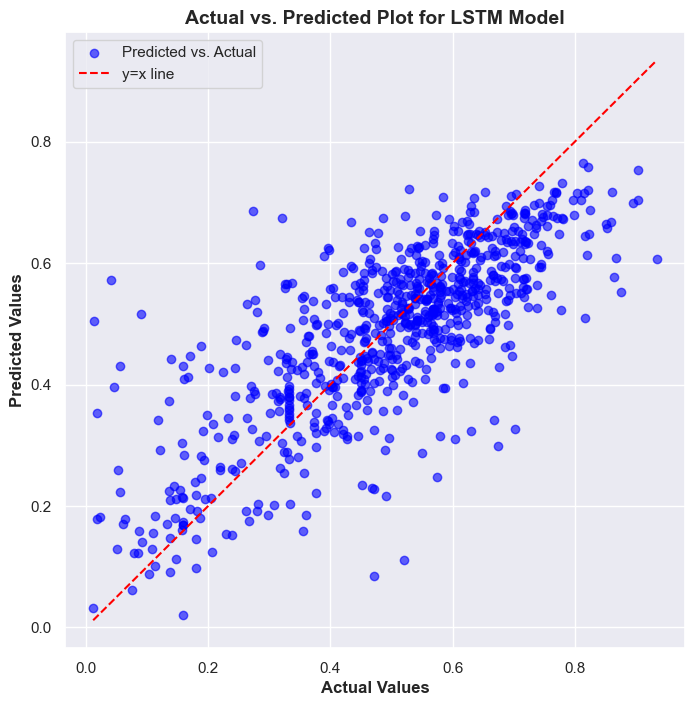

Mean Squared Error (MSE): 0.0134
Mean Absolute Error (MAE): 0.0869
R-squared (R²): 0.5781
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


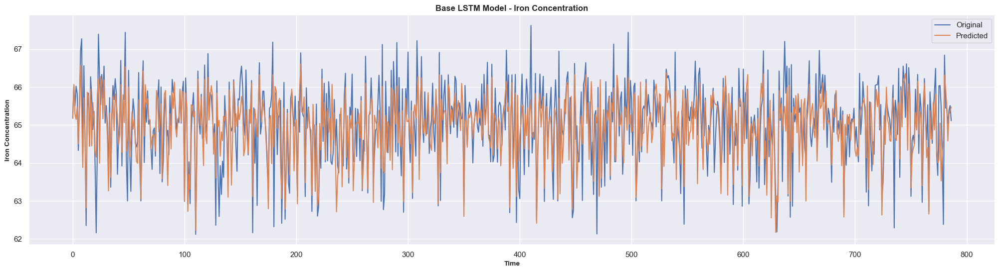

In [50]:
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Make predictions on the test set
y_pred = model_lstm_base.predict(X_test)

# Plot actual vs. predicted
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred, alpha=0.6, color='blue', label='Predicted vs. Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--', label='y=x line')
plt.xlabel('Actual Values', fontsize=12, fontweight='bold')
plt.ylabel('Predicted Values', fontsize=12, fontweight='bold')
plt.title('Actual vs. Predicted Plot for LSTM Model', fontsize=14, fontweight='bold')
plt.legend(loc='best')
plt.grid(True)
plt.show()

# Calculate the evaluation metrics
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the metrics
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

# Plot predictions
plot_predictions(model_lstm_base, X_test, y_test, scaler, 'Base LSTM Model', new_columns.index('conc_Fe'))

**Base LSTM Model Weights**

In [51]:
import numpy as np

# Get the model's weights and biases
weights_and_biases = model_lstm_base.get_weights()

# Save the weights and biases to a text file
with open("Tensors_Base_LSTM.txt", "w") as file:
    for i, tensor in enumerate(weights_and_biases):
        file.write(f"Tensor {i+1} (Shape: {tensor.shape}):\n")
        file.write(np.array2string(tensor, separator=', '))
        file.write("\n\n")

print("Model weights and biases have been saved to 'Tensors_Base_LSTM.txt'.")


Model weights and biases have been saved to 'Tensors_Base_LSTM.txt'.


**Base LSTM Architecture**

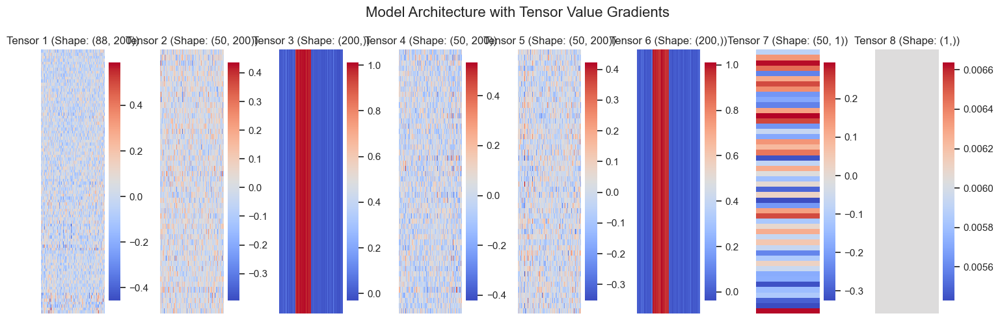

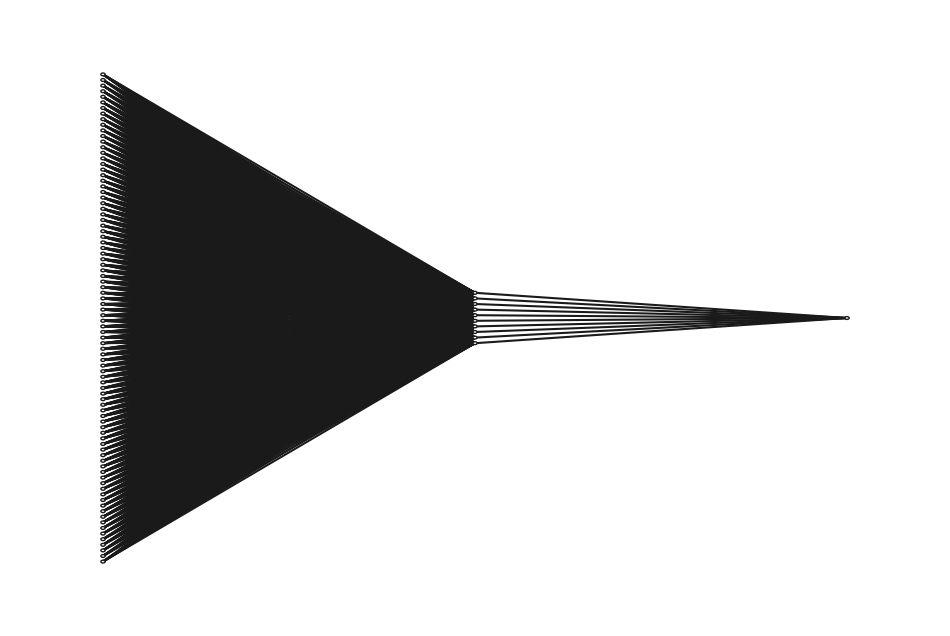

In [52]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Get the model's weights and biases
weights_and_biases = model_lstm_base.get_weights()

# Define a function to plot the tensors using color gradients
def plot_tensor(tensor, title, ax):
    sns.heatmap(tensor, cmap='coolwarm', cbar=True, ax=ax)
    ax.set_title(title, fontsize=12)
    ax.axis('off')

# Plot the model architecture
fig, axes = plt.subplots(1, len(weights_and_biases), figsize=(15, 5))

for i, tensor in enumerate(weights_and_biases):
    # Reshape the tensor to 2D for visualization purposes, if necessary
    tensor_2d = tensor if len(tensor.shape) == 2 else np.reshape(tensor, (-1, tensor.shape[-1]))
    plot_tensor(tensor_2d, f'Tensor {i+1} (Shape: {tensor.shape})', axes[i])

plt.suptitle('Model Architecture with Tensor Value Gradients', fontsize=16)
plt.tight_layout()
plt.show()

import matplotlib.pyplot as plt
import numpy as np

def draw_neural_net(ax, left, right, bottom, top, layer_sizes, weights=None):
    '''
    Draw a neural network cartoon using matplotlib.
    
    :param ax: matplotlib AxesSubplot object
    :param left: float, x-coordinate of the leftmost node(s)
    :param right: float, x-coordinate of the rightmost node(s)
    :param bottom: float, y-coordinate of the bottommost node(s)
    :param top: float, y-coordinate of the topmost node(s)
    :param layer_sizes: List of int, list containing the number of nodes in each layer
    :param weights: List of np.array, weights of connections between layers
    '''
    v_spacing = (top - bottom) / float(max(layer_sizes))
    h_spacing = (right - left) / float(len(layer_sizes) - 1)

    # Nodes
    for n, layer_size in enumerate(layer_sizes):
        layer_top = v_spacing * (layer_size - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size):
            circle = plt.Circle((n * h_spacing + left, layer_top - m * v_spacing), v_spacing / 4.,
                                color='w', ec='k', zorder=4)
            ax.add_artist(circle)

    # Edges
    for n, (layer_size_a, layer_size_b) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
        layer_top_a = v_spacing * (layer_size_a - 1) / 2. + (top + bottom) / 2.
        layer_top_b = v_spacing * (layer_size_b - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size_a):
            for o in range(layer_size_b):
                line = plt.Line2D([n * h_spacing + left, (n + 1) * h_spacing + left],
                                  [layer_top_a - m * v_spacing, layer_top_b - o * v_spacing], c='k')
                ax.add_artist(line)

# Example usage:
fig = plt.figure(figsize=(12, 8))
ax = fig.gca()
ax.axis('off')

# This example assumes an LSTM with an input layer of size SEQ_LENGTH * features, two LSTM layers (combined into one for simplicity), and an output layer of size 1
layer_sizes = [X_train.shape[2], 10, 1]  # Input layer, hidden layer(s), output layer
draw_neural_net(ax, .1, .9, .1, .9, layer_sizes)

plt.show()


### **5.2.2. Autoencoder1**

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 10, 88)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed                │ (None, 10, 14)         │         1,246 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_1              │ (None, 10, 88)         │         1,320 │
│ (TimeDistributed)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,566 (10.02 KB)

 Trainable params: 2,566 (10.02 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - loss: 0.0850 - val_loss: 0.0519
Epoch 2/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0414 - val_loss: 0.0286
Epoch 3/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0273 - val_loss: 0.0245
Epoch 4/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0231 - val_loss: 0.0206
Epoch 5/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0199 - val_loss: 0.0188
Epoch 6/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0185 - val_loss: 0.0176
Epoch 7/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0173 - val_loss: 0.0163
Epoch 8/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0157 - val_loss: 0.0152
Epoch 9/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0149 - val_loss: 0.0144
Epoch 10/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0140 - val_loss: 0.0138
Epoch 11/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0135 - val_loss: 0.0134
Epoch 12/30
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0133 - val_lo

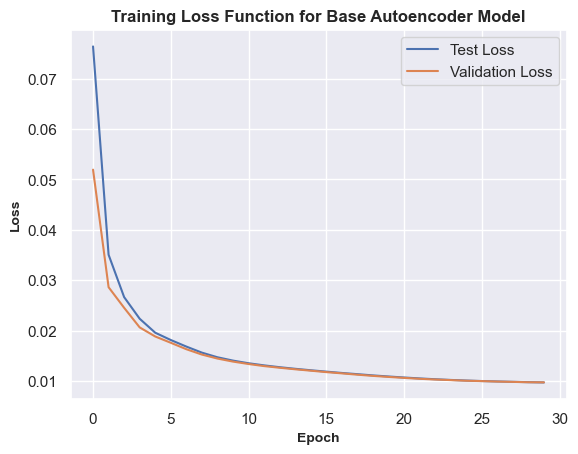

25/25 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


In [53]:
from tensorflow.keras.layers import Input, Dense, RepeatVector, TimeDistributed
from tensorflow.keras.models import Model

# Build Autoencoder model
input_dim = X_train.shape[2]
encoding_dim = 14  # Dimension of the latent space

input_layer = Input(shape=(SEQ_LENGTH, input_dim))
encoded = TimeDistributed(Dense(encoding_dim, activation='relu'))(input_layer)
decoded = TimeDistributed(Dense(input_dim, activation='sigmoid'))(encoded)

autoencoder_base = Model(input_layer, decoded)
autoencoder_base.compile(optimizer='adam', loss='mse')
autoencoder_base.summary()

# Train the autoencoder
history_autoencoder_base = autoencoder_base.fit(X_train, X_train, epochs=30, batch_size=32, validation_split=0.2)

# Evaluate the autoencoder
loss_autoencoder = autoencoder_base.evaluate(X_test, X_test)
print(f'Test Loss for Autoencoder: {loss_autoencoder}')

ax = plt.axes()
plt.plot(history_autoencoder_base.history['loss'], label = "Test Loss")
plt.plot(history_autoencoder_base.history['val_loss'], label = "Validation Loss")
plt.xlabel("Epoch", fontsize = 10, fontweight ='bold')
plt.ylabel("Loss", fontsize = 10, fontweight ='bold')
plt.title("Training Loss Function for Base Autoencoder Model", fontsize = 12, fontweight = 'bold')
plt.legend()
plt.show()

# Predict and plot
X_test_decoded = autoencoder_base.predict(X_test)
y_pred_autoencoder_base = X_test_decoded[:, -1, new_columns.index('conc_Fe')]

**Base Autoencoder Model Predictions:**

25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


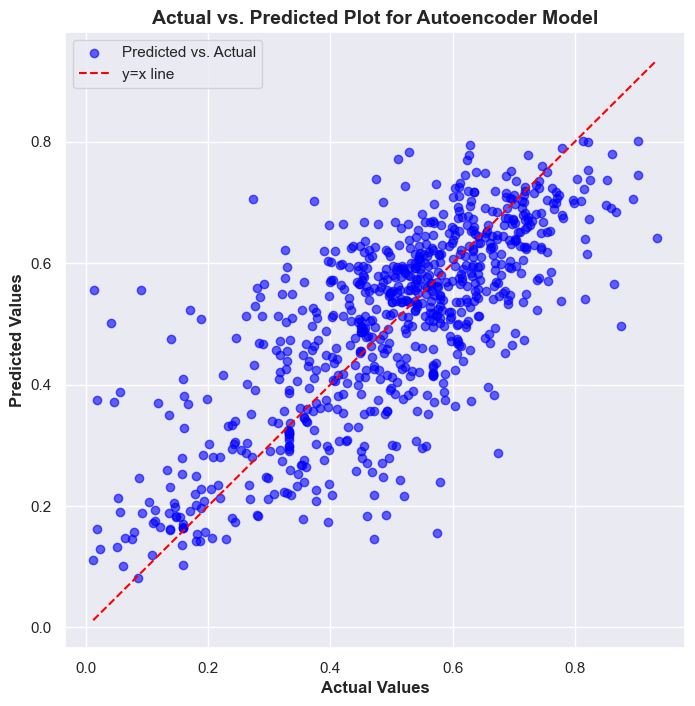

Mean Squared Error (MSE): 0.0149
Mean Absolute Error (MAE): 0.0930
R-squared (R²): 0.5312


NameError: name 'y_test_actual' is not defined

In [54]:
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Make predictions using the autoencoder
X_test_decoded = autoencoder_base.predict(X_test)

# Extract the predicted values for 'conc_Fe' (last time step of each sequence)
y_pred_autoencoder_base = X_test_decoded[:, -1, new_columns.index('conc_Fe')]

# Plot actual vs. predicted values
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred_autoencoder_base, alpha=0.6, color='blue', label='Predicted vs. Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--', label='y=x line')
plt.xlabel('Actual Values', fontsize=12, fontweight='bold')
plt.ylabel('Predicted Values', fontsize=12, fontweight='bold')
plt.title('Actual vs. Predicted Plot for Autoencoder Model', fontsize=14, fontweight='bold')
plt.legend(loc='best')
plt.grid(True)
plt.show()

# Calculate the evaluation metrics
mse = mean_squared_error(y_test, y_pred_autoencoder_base)
mae = mean_absolute_error(y_test, y_pred_autoencoder_base)
r2 = r2_score(y_test, y_pred_autoencoder_base)

# Print the metrics
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

# Plot predictions
plt.figure(figsize=(15, 6))
plt.plot(y_test_actual, label='Original')
plt.plot(y_pred_autoencoder_base, label='Predicted')
plt.title('Base Autoencoder Model - Iron Concentration')
plt.xlabel('Time')
plt.ylabel('Iron Concentration')
plt.legend()
plt.show()

**Base Autoencoder Weights**

In [55]:
import numpy as np

# Get the model's weights and biases
weights_and_biases = autoencoder_base.get_weights()

# Save the weights and biases to a text file
with open("Tensors_Base_Autoencoder.txt", "w") as file:
    for i, tensor in enumerate(weights_and_biases):
        file.write(f"Tensor {i+1} (Shape: {tensor.shape}):\n")
        file.write(np.array2string(tensor, separator=', '))
        file.write("\n\n")

print("Model weights and biases have been saved to 'Tensors_Base_Autoencoder.txt'.")


Model weights and biases have been saved to 'Tensors_Base_Autoencoder.txt'.


**Base Autoencoder Architecture**

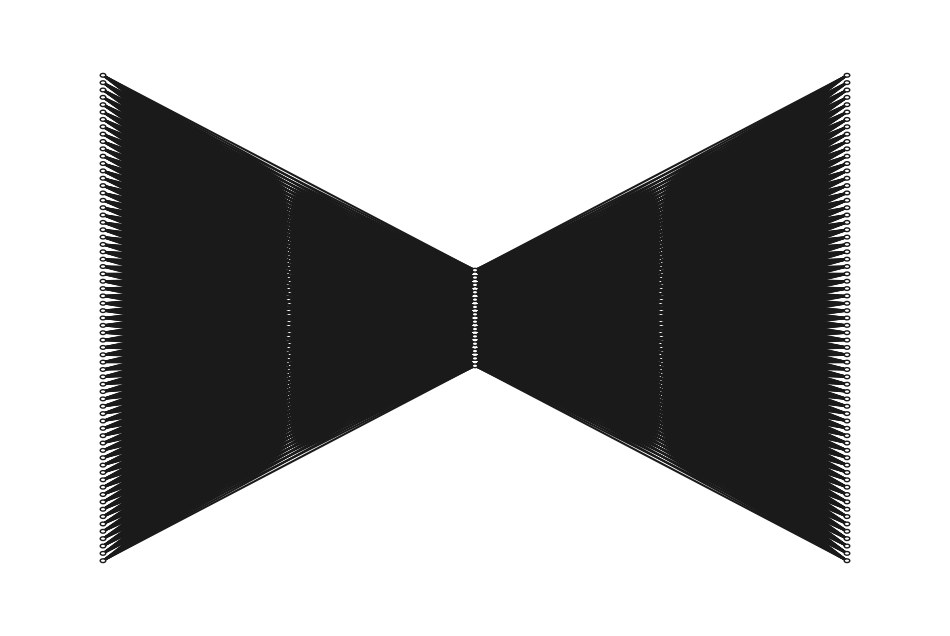

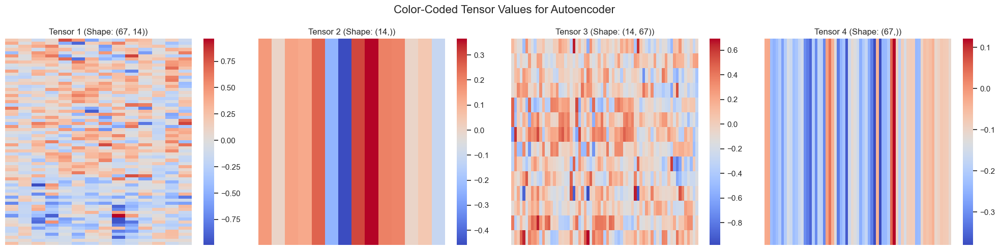

In [56]:
import matplotlib.pyplot as plt

def draw_neural_net(ax, left, right, bottom, top, layer_sizes):
    '''
    Draw a simple neural network diagram using matplotlib.
    
    :param ax: matplotlib AxesSubplot object
    :param left: float, x-coordinate of the leftmost node(s)
    :param right: float, x-coordinate of the rightmost node(s)
    :param bottom: float, y-coordinate of the bottommost node(s)
    :param top: float, y-coordinate of the topmost node(s)
    :param layer_sizes: List of int, list containing the number of nodes in each layer
    '''
    v_spacing = (top - bottom) / float(max(layer_sizes))
    h_spacing = (right - left) / float(len(layer_sizes) - 1)

    # Nodes
    for n, layer_size in enumerate(layer_sizes):
        layer_top = v_spacing * (layer_size - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size):
            circle = plt.Circle((n * h_spacing + left, layer_top - m * v_spacing), v_spacing / 4.,
                                color='w', ec='k', zorder=4)
            ax.add_artist(circle)

    # Edges
    for n, (layer_size_a, layer_size_b) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
        layer_top_a = v_spacing * (layer_size_a - 1) / 2. + (top + bottom) / 2.
        layer_top_b = v_spacing * (layer_size_b - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size_a):
            for o in range(layer_size_b):
                line = plt.Line2D([n * h_spacing + left, (n + 1) * h_spacing + left],
                                  [layer_top_a - m * v_spacing, layer_top_b - o * v_spacing], c='k')
                ax.add_artist(line)

# Example usage:
fig = plt.figure(figsize=(12, 8))
ax = fig.gca()
ax.axis('off')

# Define the number of nodes for input layer, hidden layers, and output layer (e.g., [input_dim, encoding_dim, output_dim])
layer_sizes = [X_train.shape[2], 14, X_train.shape[2]]  # Input, hidden (encoding), and output layers
draw_neural_net(ax, .1, .9, .1, .9, layer_sizes)

plt.show()

import seaborn as sns

# Define a function to plot tensor values using heatmaps
def plot_tensor(tensor, title, ax):
    sns.heatmap(tensor, cmap='coolwarm', cbar=True, ax=ax)
    ax.set_title(title, fontsize=12)
    ax.axis('off')

# Plot the model's tensors (weights)
weights_and_biases = autoencoder_base.get_weights()

# Create subplots to display tensors
fig, axes = plt.subplots(1, len(weights_and_biases), figsize=(20, 5))

for i, tensor in enumerate(weights_and_biases):
    # Reshape the tensor to 2D for visualization purposes, if necessary
    tensor_2d = tensor if len(tensor.shape) == 2 else np.reshape(tensor, (-1, tensor.shape[-1]))
    plot_tensor(tensor_2d, f'Tensor {i+1} (Shape: {tensor.shape})', axes[i])

plt.suptitle('Color-Coded Tensor Values for Autoencoder', fontsize=16)
plt.tight_layout()
plt.show()


### **5.2.3. LSTM Autoencoder 1**

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 10, 67)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 50)             │        23,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ repeat_vector (RepeatVector)    │ (None, 10, 50)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_3 (LSTM)                   │ (None, 10, 67)         │        31,624 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 55,224 (215.72 KB)

 Trainable params: 55,224 (215.72 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 6s 21ms/step - loss: 0.1084 - val_loss: 0.0307
Epoch 2/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0299 - val_loss: 0.0259
Epoch 3/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0246 - val_loss: 0.0209
Epoch 4/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0200 - val_loss: 0.0184
Epoch 5/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0179 - val_loss: 0.0170
Epoch 6/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0167 - val_loss: 0.0155
Epoch 7/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0150 - val_loss: 0.0144
Epoch 8/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0140 - val_loss: 0.0137
Epoch 9/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 0.0134 - val_loss: 0.0131
Epoch 10/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0127 - val_loss: 0.0127
Epoch 11/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0125 - val_loss: 0.0123
Epoch 12/25
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.012

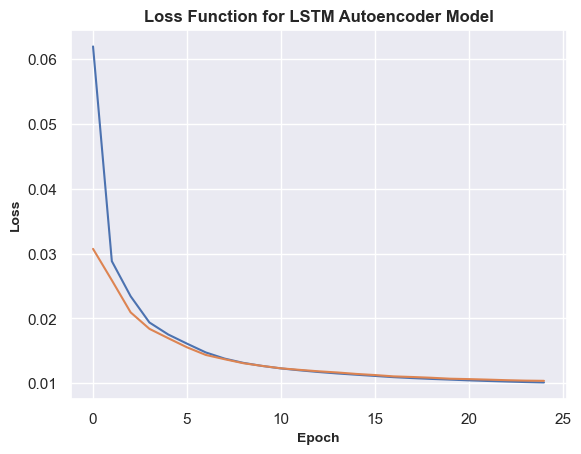

25/25 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step


In [57]:
# Build LSTM Autoencoder model
input_layer = Input(shape=(SEQ_LENGTH, input_dim))
encoded = LSTM(50, return_sequences=False)(input_layer)
decoded = RepeatVector(SEQ_LENGTH)(encoded)
decoded = LSTM(input_dim, return_sequences=True)(decoded)

lstm_autoencoder_base = Model(input_layer, decoded)
lstm_autoencoder_base.compile(optimizer='adam', loss='mse')
lstm_autoencoder_base.summary()

# Train the LSTM Autoencoder
history_lstm_autoencoder_base = lstm_autoencoder_base.fit(X_train, X_train, epochs=25, batch_size=32, validation_split=0.2)

# Evaluate the LSTM Autoencoder
loss_lstm_autoencoder = lstm_autoencoder_base.evaluate(X_test, X_test)
print(f'Test Loss for LSTM Autoencoder: {loss_lstm_autoencoder}')

ax = plt.axes()
plt.plot(history_lstm_autoencoder_base.history['loss'], label = "Training Loss")
plt.plot(history_lstm_autoencoder_base.history['val_loss'], label = "Validation Loss")
plt.xlabel("Epoch", fontsize = 10, fontweight ='bold')
plt.ylabel("Loss", fontsize = 10, fontweight ='bold')
plt.title("Loss Function for LSTM Autoencoder Model", fontsize = 12, fontweight = 'bold')
plt.show()

# Predict and plot
X_test_decoded = lstm_autoencoder_base.predict(X_test)
y_pred_lstm_autoencoder_base = X_test_decoded[:, -1, new_columns.index('conc_Fe')]

**Base LSTM Autoencoder Predictions**

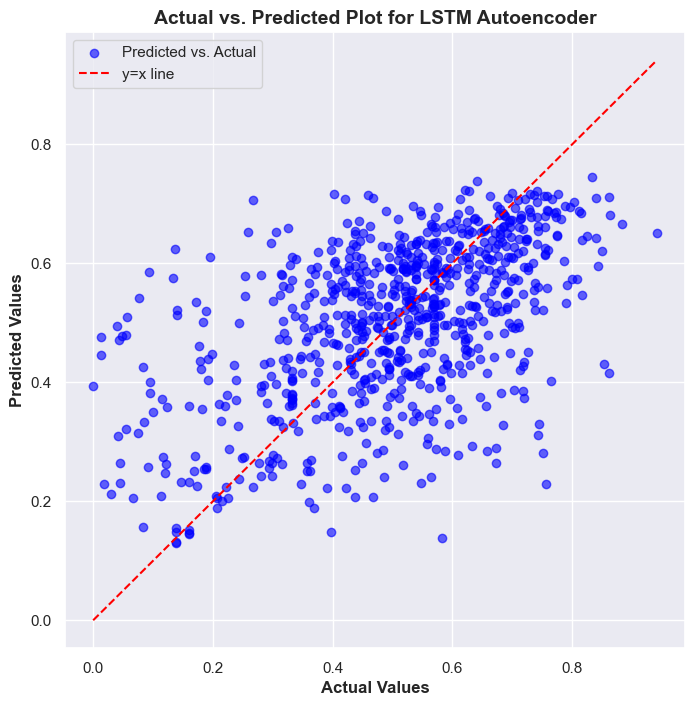

Mean Squared Error (MSE): 0.0242
Mean Absolute Error (MAE): 0.1185
R-squared (R²): 0.2406


In [58]:
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Create the actual vs. predicted plot
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred_lstm_autoencoder_base, alpha=0.6, color='blue', label='Predicted vs. Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--', label='y=x line')
plt.xlabel('Actual Values', fontsize=12, fontweight='bold')
plt.ylabel('Predicted Values', fontsize=12, fontweight='bold')
plt.title('Actual vs. Predicted Plot for LSTM Autoencoder', fontsize=14, fontweight='bold')
plt.legend(loc='best')
plt.grid(True)
plt.show()

# Calculate and print error metrics
mse = mean_squared_error(y_test, y_pred_lstm_autoencoder_base)
mae = mean_absolute_error(y_test, y_pred_lstm_autoencoder_base)
r2 = r2_score(y_test, y_pred_lstm_autoencoder_base)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

# Plot predictions
plt.figure(figsize=(15, 6))
plt.plot(y_test_actual, label='Original')
plt.plot(y_pred_lstm_autoencoder_base, label='Predicted')
plt.title('Base LSTM Autoencoder Model - Iron Concentration')
plt.xlabel('Time')
plt.ylabel('Iron Concentration')
plt.legend()
plt.show()

**Base LSTM Autoencoder weights**

In [59]:
import numpy as np

# Get the model's weights and biases
weights_and_biases = lstm_autoencoder_base.get_weights()

# Save the weights and biases to a text file
with open("Tensors_Base_LSTMAutoencoder.txt", "w") as file:
    for i, tensor in enumerate(weights_and_biases):
        file.write(f"Tensor {i+1} (Shape: {tensor.shape}):\n")
        file.write(np.array2string(tensor, separator=', '))
        file.write("\n\n")

print("Model weights and biases have been saved to 'Tensors_Base_LSTMAutoencoder.txt'.")


Model weights and biases have been saved to 'Tensors_Base_LSTMAutoencoder.txt'.


**Base LSTM Autoencoder Architecture**

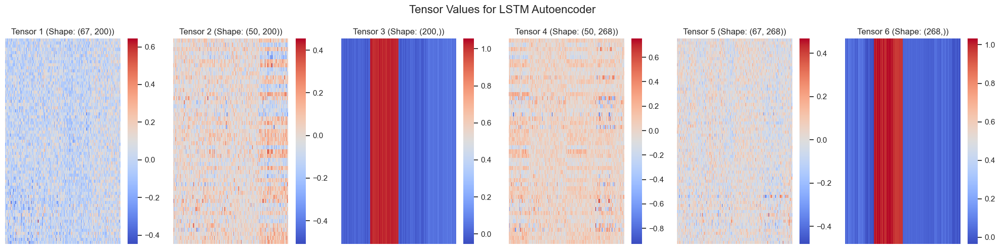

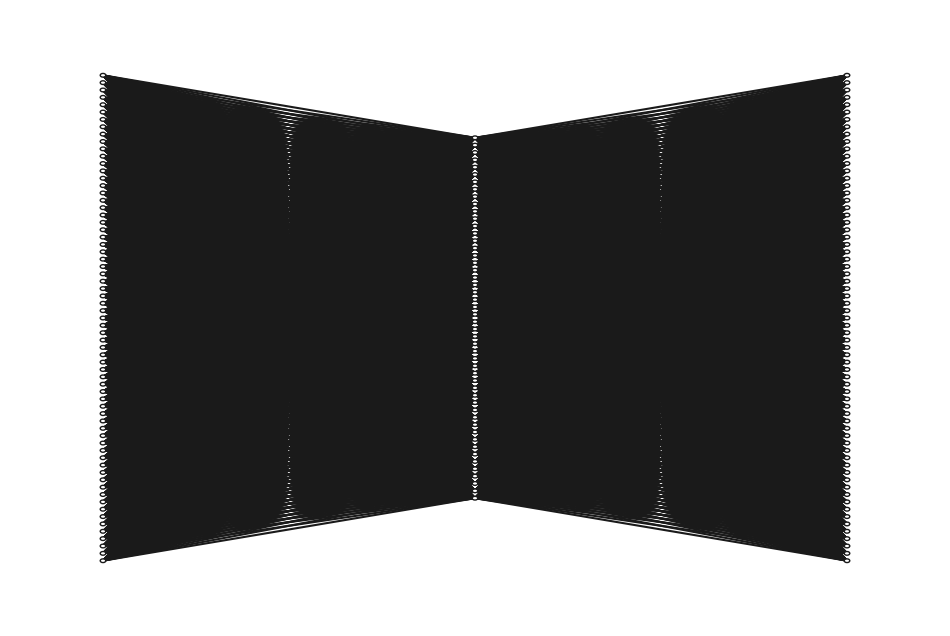

In [60]:
import seaborn as sns

# Define a function to plot tensor values using heatmaps
def plot_tensor(tensor, title, ax):
    sns.heatmap(tensor, cmap='coolwarm', cbar=True, ax=ax)
    ax.set_title(title, fontsize=12)
    ax.axis('off')

# Plot the model's tensors (weights)
fig, axes = plt.subplots(1, len(weights_and_biases), figsize=(20, 5))

for i, tensor in enumerate(weights_and_biases):
    # Reshape the tensor to 2D for visualization purposes if necessary
    tensor_2d = tensor if len(tensor.shape) == 2 else np.reshape(tensor, (-1, tensor.shape[-1]))
    plot_tensor(tensor_2d, f'Tensor {i+1} (Shape: {tensor.shape})', axes[i])

plt.suptitle('Tensor Values for LSTM Autoencoder', fontsize=16)
plt.tight_layout()
plt.show()

#FOR NEURAL NETWORK LAYOUT
# Importing required libraries
import matplotlib.pyplot as plt

def draw_neural_net(ax, left, right, bottom, top, layer_sizes):
    '''
    Draw a simple neural network diagram using matplotlib.
    
    :param ax: matplotlib AxesSubplot object
    :param left: float, x-coordinate of the leftmost node(s)
    :param right: float, x-coordinate of the rightmost node(s)
    :param bottom: float, y-coordinate of the bottommost node(s)
    :param top: float, y-coordinate of the topmost node(s)
    :param layer_sizes: List of int, list containing the number of nodes in each layer
    '''
    v_spacing = (top - bottom) / float(max(layer_sizes))
    h_spacing = (right - left) / float(len(layer_sizes) - 1)

    # Nodes
    for n, layer_size in enumerate(layer_sizes):
        layer_top = v_spacing * (layer_size - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size):
            circle = plt.Circle((n * h_spacing + left, layer_top - m * v_spacing), v_spacing / 4.,
                                color='w', ec='k', zorder=4)
            ax.add_artist(circle)

    # Edges
    for n, (layer_size_a, layer_size_b) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
        layer_top_a = v_spacing * (layer_size_a - 1) / 2. + (top + bottom) / 2.
        layer_top_b = v_spacing * (layer_size_b - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size_a):
            for o in range(layer_size_b):
                line = plt.Line2D([n * h_spacing + left, (n + 1) * h_spacing + left],
                                  [layer_top_a - m * v_spacing, layer_top_b - o * v_spacing], c='k')
                ax.add_artist(line)

# Example usage
fig = plt.figure(figsize=(12, 8))
ax = fig.gca()
ax.axis('off')

# Replace `latent_dim` with its numerical value (50) directly
layer_sizes = [X_train.shape[2], 50, X_train.shape[2]]  # Assuming latent_dim is 50
draw_neural_net(ax, .1, .9, .1, .9, layer_sizes)

plt.show()



## **5.3. Hyperparameter Tuning**


### **5.3.1. LSTM tuning**

In [61]:
import kerastuner as kt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam

# Define the LSTM model with hyperparameters
def build_lstm_model(hp):
    model = Sequential()
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden LSTM layers
        model.add(LSTM(
            units=hp.Int(f'units_{i}', min_value=32, max_value=512, step=32),
            return_sequences=(i != hp.get('num_layers') - 1),  # Only the last LSTM layer should not return sequences
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        ))
    model.add(Dense(1))
    model.compile(optimizer=Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                  loss='huber')
    return model

# Instantiate the tuner
tuner = kt.Hyperband(build_lstm_model,
                     objective='val_loss',
                     max_epochs=10,
                     factor=3,
                     directory='my_dir',
                     project_name='lstm_tuning')

# Perform hyperparameter search
tuner.search(X_train, y_train, epochs=10, validation_split=0.2)

# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# Build the model with the optimal hyperparameters and train it
model_lstm_tuned = tuner.hypermodel.build(best_hps)
history_lstm_tuned = model_lstm_tuned.fit(X_train, y_train, epochs=20, batch_size=32, validation_split=0.2)

# Evaluate the model
loss_lstm = model_lstm_tuned.evaluate(X_test, y_test)
print(f'Test Loss for LSTM: {loss_lstm}')

Reloading Tuner from my_dir\lstm_tuning\tuner0.json
Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 8s 69ms/step - loss: 0.0758 - val_loss: 0.0107
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 5s 63ms/step - loss: 0.0094 - val_loss: 0.0096
Epoch 3/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 5s 62ms/step - loss: 0.0082 - val_loss: 0.0086
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - loss: 0.0082 - val_loss: 0.0083
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 5s 62ms/step - loss: 0.0071 - val_loss: 0.0079
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 3s 43ms/step - loss: 0.0073 - val_loss: 0.0082
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 5s 61ms/step - loss: 0.0071 - val_loss: 0.0087
Epoch 8/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - loss: 0.0069 - val_loss: 0.0078
Epoch 9/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 50ms/step - loss: 0.0066 - val_loss: 0.0079
Epoch 10/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 5s 60ms/step - loss: 0.0070 - val_loss: 0.0111
Epoch 11/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - loss: 0.0079 - val_loss: 0.0084
Epoch 12/20

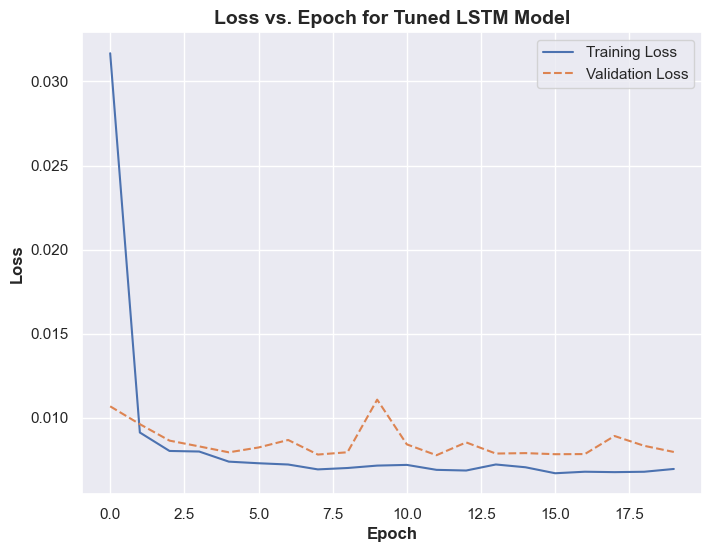

In [62]:
import matplotlib.pyplot as plt

# Plot loss vs. epoch graph for the tuned model
plt.figure(figsize=(8, 6))
plt.plot(history_lstm_tuned.history['loss'], label='Training Loss')
plt.plot(history_lstm_tuned.history['val_loss'], label='Validation Loss', linestyle='--')
plt.xlabel('Epoch', fontsize=12, fontweight='bold')
plt.ylabel('Loss', fontsize=12, fontweight='bold')
plt.title('Loss vs. Epoch for Tuned LSTM Model', fontsize=14, fontweight='bold')
plt.legend(loc='upper right')
plt.grid(True)
plt.show()

**Tuned LSTM Hyperparams**

In [63]:
# Print optimal hyperparameters
print("Optimal Hyperparameters:")
print(f"Number of Layers: {best_hps.get('num_layers')}")
for i in range(best_hps.get('num_layers')):
    print(f"Units in Layer {i + 1}: {best_hps.get(f'units_{i}')}")
    print(f"Activation for Layer {i + 1}: {best_hps.get('activation')}")
print(f"Learning Rate: {best_hps.get('learning_rate')}")

# Save the optimal hyperparameters to a text file
with open("Hyperparams_LSTM.txt", "w") as file:
    file.write("Optimal Hyperparameters:\n")
    file.write(f"Number of Layers: {best_hps.get('num_layers')}\n")
    for i in range(best_hps.get('num_layers')):
        file.write(f"Units in Layer {i + 1}: {best_hps.get(f'units_{i}')}\n")
        file.write(f"Activation for Layer {i + 1}: {best_hps.get('activation')}\n")
    file.write(f"Learning Rate: {best_hps.get('learning_rate')}\n")

print("Optimal hyperparameters have been saved to 'Hyperparams_LSTM.txt'.")


Optimal Hyperparameters:
Number of Layers: 1
Units in Layer 1: 416
Activation for Layer 1: tanh
Learning Rate: 0.001
Optimal hyperparameters have been saved to 'Hyperparams_LSTM.txt'.


**Tuned LSTM Model Predictions:**

25/25 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step


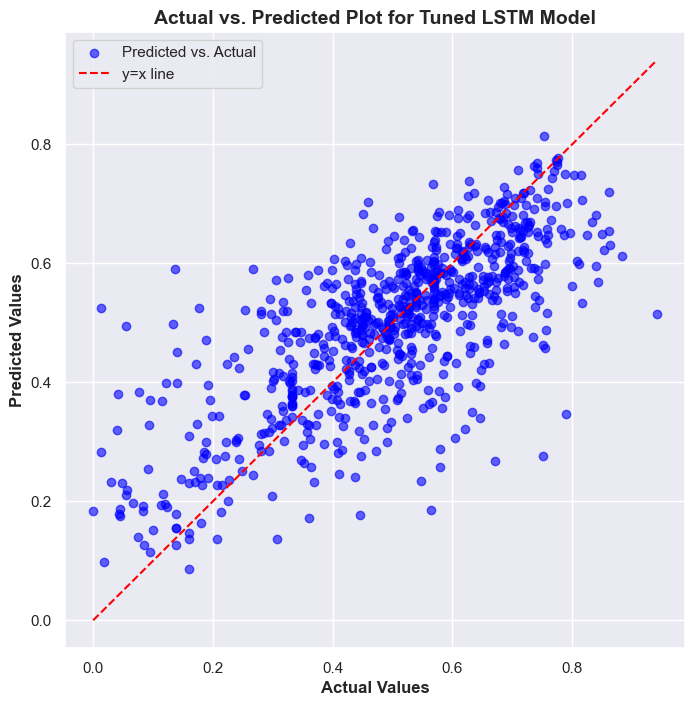

Mean Squared Error (MSE): 0.0145
Mean Absolute Error (MAE): 0.0891
R-squared (R²): 0.5444


In [64]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Make predictions on the test set
y_pred_lstm_tuned = model_lstm_tuned.predict(X_test)

# Plot actual vs. predicted values
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred_lstm_tuned, alpha=0.6, color='blue', label='Predicted vs. Actual')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linestyle='--', label='y=x line')
plt.xlabel('Actual Values', fontsize=12, fontweight='bold')
plt.ylabel('Predicted Values', fontsize=12, fontweight='bold')
plt.title('Actual vs. Predicted Plot for Tuned LSTM Model', fontsize=14, fontweight='bold')
plt.legend(loc='best')
plt.grid(True)
plt.show()

# Calculate and print error metrics
mse = mean_squared_error(y_test, y_pred_lstm_tuned)
mae = mean_absolute_error(y_test, y_pred_lstm_tuned)
r2 = r2_score(y_test, y_pred_lstm_tuned)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

# Predict and plot
plot_predictions(model_lstm_tuned, X_test, y_test, scaler, 'Tuned LSTM Model', new_columns.index('conc_Fe'))

**Tuned LSTM Architecture**

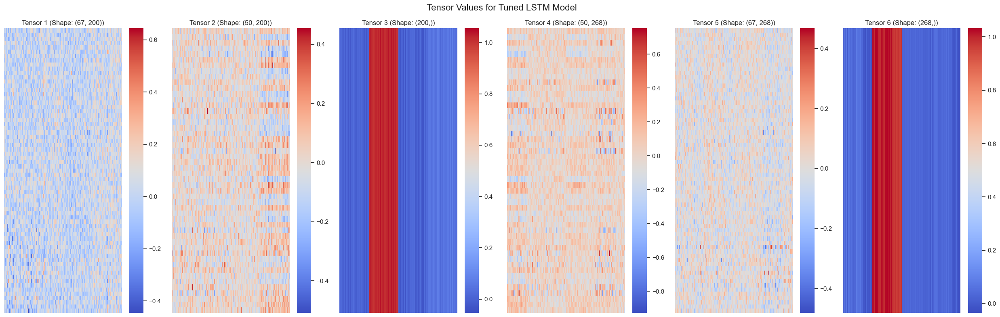

In [65]:
import seaborn as sns

# Define a function to plot tensor values using heatmaps
def plot_tensor(tensor, title, ax):
    sns.heatmap(tensor, cmap='coolwarm', cbar=True, ax=ax)
    ax.set_title(title, fontsize=12)
    ax.axis('off')

# Plot the model's tensors (weights)
fig, axes = plt.subplots(1, len(weights_and_biases), figsize=(25, 8))

for i, tensor in enumerate(weights_and_biases):
    # Reshape the tensor to 2D for visualization purposes, if necessary
    tensor_2d = tensor if len(tensor.shape) == 2 else np.reshape(tensor, (-1, tensor.shape[-1]))
    plot_tensor(tensor_2d, f'Tensor {i+1} (Shape: {tensor.shape})', axes[i])

plt.suptitle('Tensor Values for Tuned LSTM Model', fontsize=16)
plt.tight_layout()
plt.show()




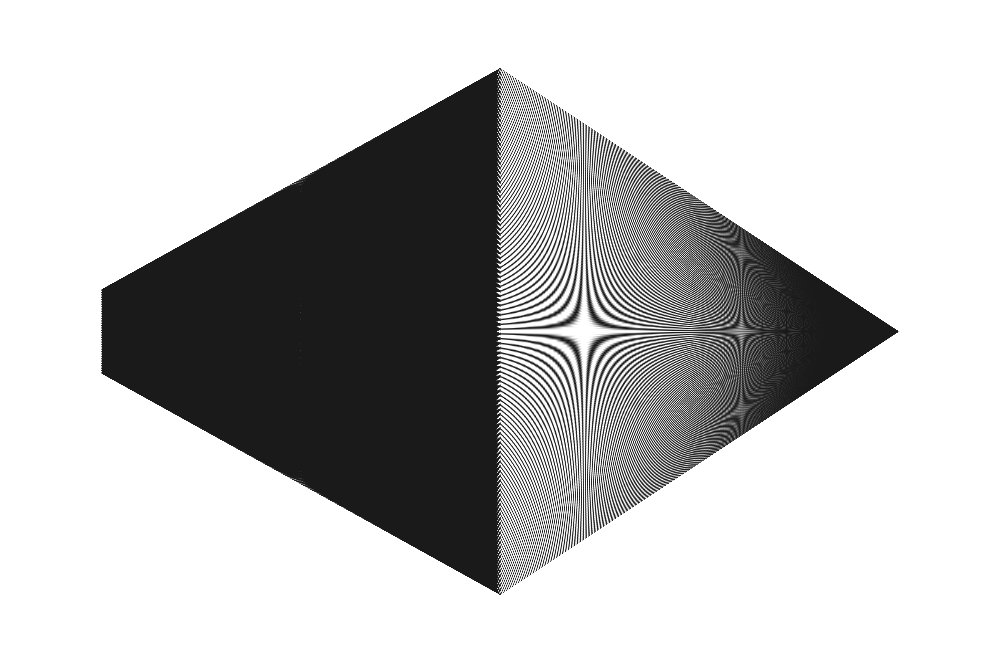

In [66]:
def draw_neural_net(ax, left, right, bottom, top, layer_sizes):
    '''
    Draw a simple neural network diagram using matplotlib.
    
    :param ax: matplotlib AxesSubplot object
    :param left: float, x-coordinate of the leftmost node(s)
    :param right: float, x-coordinate of the rightmost node(s)
    :param bottom: float, y-coordinate of the bottommost node(s)
    :param top: float, y-coordinate of the topmost node(s)
    :param layer_sizes: List of int, list containing the number of nodes in each layer
    '''
    v_spacing = (top - bottom) / float(max(layer_sizes))
    h_spacing = (right - left) / float(len(layer_sizes) - 1)

    # Nodes
    for n, layer_size in enumerate(layer_sizes):
        layer_top = v_spacing * (layer_size - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size):
            circle = plt.Circle((n * h_spacing + left, layer_top - m * v_spacing), v_spacing / 4.,
                                color='w', ec='k', zorder=4)
            ax.add_artist(circle)

    # Edges
    for n, (layer_size_a, layer_size_b) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
        layer_top_a = v_spacing * (layer_size_a - 1) / 2. + (top + bottom) / 2.
        layer_top_b = v_spacing * (layer_size_b - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size_a):
            for o in range(layer_size_b):
                line = plt.Line2D([n * h_spacing + left, (n + 1) * h_spacing + left],
                                  [layer_top_a - m * v_spacing, layer_top_b - o * v_spacing], c='k')
                ax.add_artist(line)

# Example usage
fig = plt.figure(figsize=(72, 48))
ax = fig.gca()
ax.axis('off')

# Define the number of nodes for input layer, hidden layers, and output layer
layer_sizes = [X_train.shape[2]] + [best_hps.get(f'units_{i}') for i in range(best_hps.get('num_layers'))] + [1]
draw_neural_net(ax, .1, .9, .1, .9, layer_sizes)

plt.show()


**Tuned LSTM Model Weights**

In [67]:
import numpy as np

# Get the model's weights and biases
weights_and_biases = model_lstm_tuned.get_weights()

# Save the weights and biases to a text file
with open("Tensors_Tuned_LSTM.txt", "w") as file:
    for i, tensor in enumerate(weights_and_biases):
        file.write(f"Tensor {i+1} (Shape: {tensor.shape}):\n")
        file.write(np.array2string(tensor, separator=', '))
        file.write("\n\n")

print("Model weights and biases have been saved to 'Tensors_Tuned_LSTM.txt'.")


Model weights and biases have been saved to 'Tensors_Tuned_LSTM.txt'.


### **5.3.2 Autoencoder tuning**

In [68]:
from tensorflow.keras.layers import Input, Dense, RepeatVector, TimeDistributed
from tensorflow.keras.models import Model

# Define the Autoencoder model with hyperparameters
def build_autoencoder_model(hp):
    input_dim = X_train.shape[2]
    encoding_dim = hp.Int('encoding_dim', min_value=8, max_value=64, step=8)
    
    input_layer = Input(shape=(SEQ_LENGTH, input_dim))
    encoded = input_layer
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden layers in encoder
        encoded = TimeDistributed(Dense(
            units=hp.Int(f'encoding_units_{i}', min_value=8, max_value=64, step=8),
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        ))(encoded)
    
    decoded = encoded
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden layers in decoder
        decoded = TimeDistributed(Dense(
            units=hp.Int(f'decoding_units_{i}', min_value=8, max_value=64, step=8),
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        ))(decoded)
    decoded = TimeDistributed(Dense(input_dim, activation='sigmoid'))(decoded)

    autoencoder = Model(input_layer, decoded)
    autoencoder.compile(optimizer=Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                        loss='huber')
    return autoencoder

# Instantiate the tuner
tuner = kt.Hyperband(build_autoencoder_model,
                     objective='val_loss',
                     max_epochs=10,
                     factor=3,
                     directory='my_dir',
                     project_name='autoencoder_tuning')

# Perform hyperparameter search
tuner.search(X_train, X_train, epochs=10, validation_split=0.2)

# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
print("best hyperparameters =", best_hps)

# Build the model with the optimal hyperparameters and train it
autoencoder_tuned = tuner.hypermodel.build(best_hps)
history_autoencoder_tuned = autoencoder_tuned.fit(X_train, X_train, epochs=20, batch_size=32, validation_split=0.2)

# Evaluate the model
loss_autoencoder_tuned = autoencoder_tuned.evaluate(X_test, X_test)
print(f'Test Loss for Tuned Autoencoder: {loss_autoencoder_tuned}')

# Predict and plot
X_test_decoded_tuned = autoencoder_tuned.predict(X_test)
y_pred_autoencoder_tuned = X_test_decoded_tuned[:, -1, new_columns.index('conc_Fe')]

Reloading Tuner from my_dir\autoencoder_tuning\tuner0.json
best hyperparameters = <keras_tuner.src.engine.hyperparameters.hyperparameters.HyperParameters object at 0x000002573B85A3C0>
Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 27ms/step - loss: 0.0266 - val_loss: 0.0128
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0115 - val_loss: 0.0086
Epoch 3/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0078 - val_loss: 0.0064
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0060 - val_loss: 0.0053
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0051 - val_loss: 0.0047
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0045 - val_loss: 0.0041
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0039 - val_loss: 0.0037
Epoch 8/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0035 - val_loss: 0.0033
Epoch 9/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0031 - val_loss: 0.0029
Epoch 10/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss:

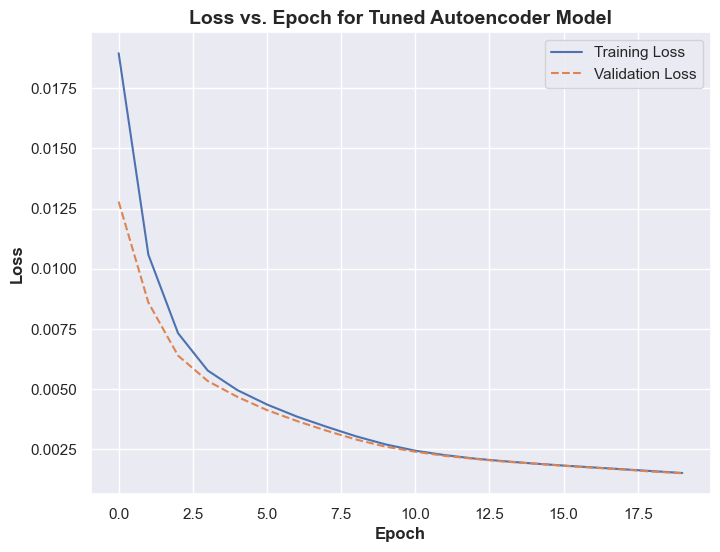

In [69]:
import matplotlib.pyplot as plt

# Plot loss vs. epoch graph for the tuned autoencoder model
plt.figure(figsize=(8, 6))
plt.plot(history_autoencoder_tuned.history['loss'], label='Training Loss')
plt.plot(history_autoencoder_tuned.history['val_loss'], label='Validation Loss', linestyle='--')
plt.xlabel('Epoch', fontsize=12, fontweight='bold')
plt.ylabel('Loss', fontsize=12, fontweight='bold')
plt.title('Loss vs. Epoch for Tuned Autoencoder Model', fontsize=14, fontweight='bold')
plt.legend(loc='upper right')
plt.grid(True)
plt.show()


**Tuned Autoencoder Hyperparams**

In [70]:
# Print optimal hyperparameters
print("Optimal Hyperparameters:")
print(f"Encoding Dimension: {best_hps.get('encoding_dim')}")
print(f"Number of Layers in Encoder: {best_hps.get('num_layers')}")
for i in range(best_hps.get('num_layers')):
    print(f"Units in Encoder Layer {i + 1}: {best_hps.get(f'encoding_units_{i}')}")
    print(f"Activation for Encoder Layer {i + 1}: {best_hps.get('activation')}")
print(f"Learning Rate: {best_hps.get('learning_rate')}")

# Save the optimal hyperparameters to a text file
with open("Hyperparams_Autoencoder.txt", "w") as file:
    file.write("Optimal Hyperparameters:\n")
    file.write(f"Encoding Dimension: {best_hps.get('encoding_dim')}\n")
    file.write(f"Number of Layers in Encoder: {best_hps.get('num_layers')}\n")
    for i in range(best_hps.get('num_layers')):
        file.write(f"Units in Encoder Layer {i + 1}: {best_hps.get(f'encoding_units_{i}')}\n")
        file.write(f"Activation for Encoder Layer {i + 1}: {best_hps.get('activation')}\n")
    file.write(f"Learning Rate: {best_hps.get('learning_rate')}\n")

print("Optimal hyperparameters have been saved to 'Hyperparams_Autoencoder.txt'.")


Optimal Hyperparameters:
Encoding Dimension: 32
Number of Layers in Encoder: 2
Units in Encoder Layer 1: 32
Activation for Encoder Layer 1: tanh
Units in Encoder Layer 2: 64
Activation for Encoder Layer 2: tanh
Learning Rate: 0.001
Optimal hyperparameters have been saved to 'Hyperparams_Autoencoder.txt'.


**Tuned Autoencoder Model Predictions**

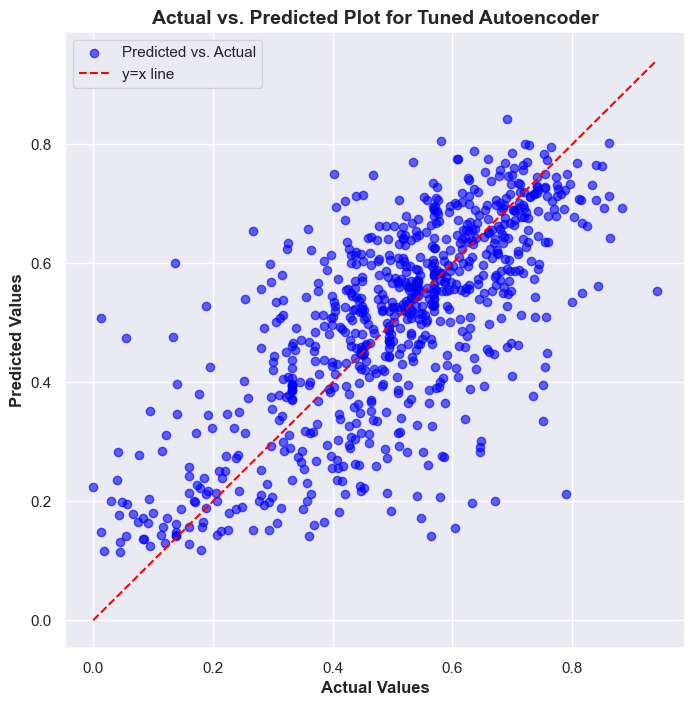

Mean Squared Error (MSE): 0.0177
Mean Absolute Error (MAE): 0.0994
R-squared (R²): 0.4448


In [71]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Extract the true values of 'conc_Fe' for the test set
y_test_true = y_test

# Plot actual vs. predicted values
plt.figure(figsize=(8, 8))
plt.scatter(y_test_true, y_pred_autoencoder_tuned, alpha=0.6, color='blue', label='Predicted vs. Actual')
plt.plot([y_test_true.min(), y_test_true.max()], [y_test_true.min(), y_test_true.max()], color='red', linestyle='--', label='y=x line')
plt.xlabel('Actual Values', fontsize=12, fontweight='bold')
plt.ylabel('Predicted Values', fontsize=12, fontweight='bold')
plt.title('Actual vs. Predicted Plot for Tuned Autoencoder', fontsize=14, fontweight='bold')
plt.legend(loc='best')
plt.grid(True)
plt.show()

# Calculate error metrics
mse = mean_squared_error(y_test_true, y_pred_autoencoder_tuned)
mae = mean_absolute_error(y_test_true, y_pred_autoencoder_tuned)
r2 = r2_score(y_test_true, y_pred_autoencoder_tuned)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

# Plot predictions
plt.figure(figsize=(15, 6))
plt.plot(y_test_actual, label='Original')
plt.plot(y_pred_autoencoder_tuned, label='Predicted')
plt.title('Tuned Autoencoder Model - Iron Concentration')
plt.xlabel('Time')
plt.ylabel('Iron Concentration')
plt.legend()
plt.show()

**Tuned Autoencoder Model Weights**

In [72]:
import numpy as np

# Get the model's weights and biases
weights_and_biases = autoencoder_tuned.get_weights()

# Save the weights and biases to a text file
with open("Tensors_Tuned_Autoencoder.txt", "w") as file:
    for i, tensor in enumerate(weights_and_biases):
        file.write(f"Tensor {i+1} (Shape: {tensor.shape}):\n")
        file.write(np.array2string(tensor, separator=', '))
        file.write("\n\n")

print("Model weights and biases have been saved to 'Tensors_Tuned_Autoencoder.txt'.")


Model weights and biases have been saved to 'Tensors_Tuned_Autoencoder.txt'.


**Tuned Autoencoder Architecture**

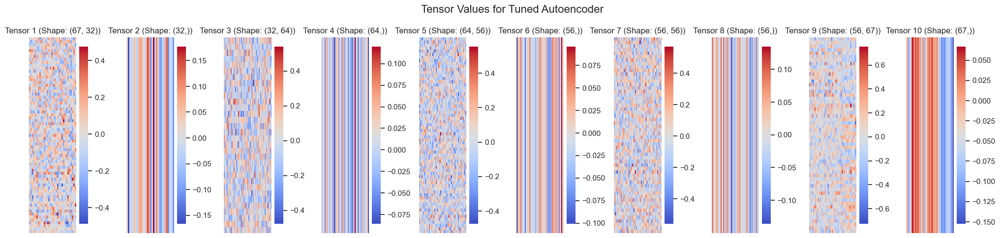

In [73]:
import seaborn as sns

# Define a function to plot tensor values using heatmaps
def plot_tensor(tensor, title, ax):
    sns.heatmap(tensor, cmap='coolwarm', cbar=True, ax=ax)
    ax.set_title(title, fontsize=12)
    ax.axis('off')

# Plot the model's tensors (weights)
fig, axes = plt.subplots(1, len(weights_and_biases), figsize=(20, 5))

for i, tensor in enumerate(weights_and_biases):
    # Reshape the tensor to 2D for visualization purposes, if necessary
    tensor_2d = tensor if len(tensor.shape) == 2 else np.reshape(tensor, (-1, tensor.shape[-1]))
    plot_tensor(tensor_2d, f'Tensor {i+1} (Shape: {tensor.shape})', axes[i])

plt.suptitle('Tensor Values for Tuned Autoencoder', fontsize=16)
plt.tight_layout()
plt.show()


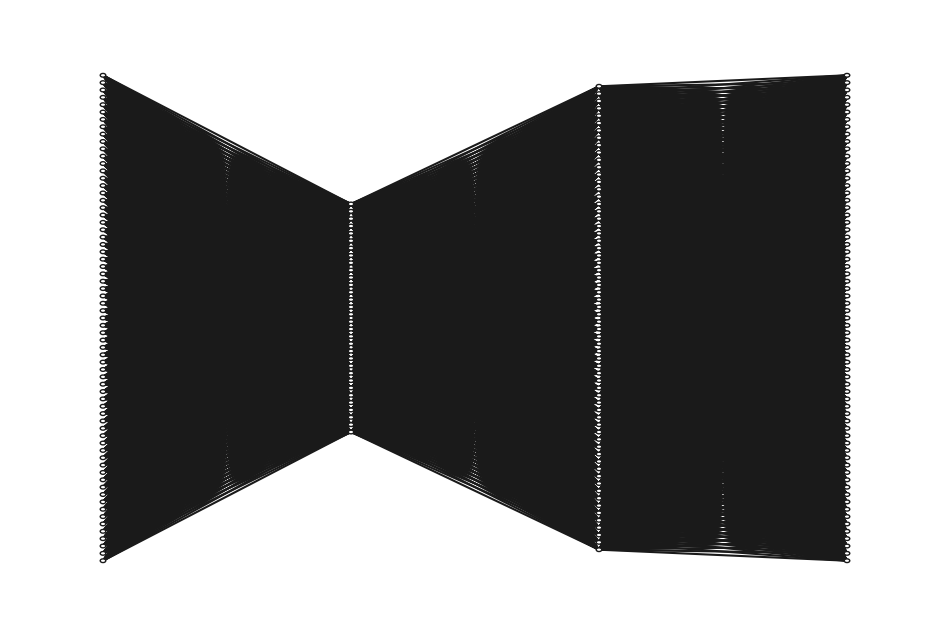

In [74]:
def draw_neural_net(ax, left, right, bottom, top, layer_sizes):
    '''
    Draw a simple neural network diagram using matplotlib.
    
    :param ax: matplotlib AxesSubplot object
    :param left: float, x-coordinate of the leftmost node(s)
    :param right: float, x-coordinate of the rightmost node(s)
    :param bottom: float, y-coordinate of the bottommost node(s)
    :param top: float, y-coordinate of the topmost node(s)
    :param layer_sizes: List of int, list containing the number of nodes in each layer
    '''
    v_spacing = (top - bottom) / float(max(layer_sizes))
    h_spacing = (right - left) / float(len(layer_sizes) - 1)

    # Nodes
    for n, layer_size in enumerate(layer_sizes):
        layer_top = v_spacing * (layer_size - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size):
            circle = plt.Circle((n * h_spacing + left, layer_top - m * v_spacing), v_spacing / 4.,
                                color='w', ec='k', zorder=4)
            ax.add_artist(circle)

    # Edges
    for n, (layer_size_a, layer_size_b) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
        layer_top_a = v_spacing * (layer_size_a - 1) / 2. + (top + bottom) / 2.
        layer_top_b = v_spacing * (layer_size_b - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size_a):
            for o in range(layer_size_b):
                line = plt.Line2D([n * h_spacing + left, (n + 1) * h_spacing + left],
                                  [layer_top_a - m * v_spacing, layer_top_b - o * v_spacing], c='k')
                ax.add_artist(line)

# Example usage
fig = plt.figure(figsize=(12, 8))
ax = fig.gca()
ax.axis('off')

# Define the number of nodes for input layer, encoding layers, and output layer
layer_sizes = [X_train.shape[2]] + [best_hps.get(f'encoding_units_{i}') for i in range(best_hps.get('num_layers'))] + [X_train.shape[2]]
draw_neural_net(ax, .1, .9, .1, .9, layer_sizes)

plt.show()


### **5.3.3. LSTM Autoencoder tuning**

In [75]:
from tensorflow.keras.layers import LSTM, RepeatVector, TimeDistributed, Dense

# Define the LSTM Autoencoder model with hyperparameters
def build_lstm_autoencoder_model(hp):
    input_dim = X_train.shape[2]
    
    input_layer = Input(shape=(SEQ_LENGTH, input_dim))
    encoded = input_layer
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden LSTM layers in encoder
        encoded = LSTM(
            units=hp.Int(f'encoding_units_{i}', min_value=32, max_value=512, step=32),
            return_sequences=(i != hp.get('num_layers') - 1),  # Only the last LSTM layer should not return sequences
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        )(encoded)
    
    decoded = RepeatVector(SEQ_LENGTH)(encoded)
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden LSTM layers in decoder
        decoded = LSTM(
            units=hp.Int(f'decoding_units_{i}', min_value=32, max_value=512, step=32),
            return_sequences=True,
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        )(decoded)
    decoded = TimeDistributed(Dense(input_dim, activation='sigmoid'))(decoded)
    
    lstm_autoencoder = Model(input_layer, decoded)
    lstm_autoencoder.compile(optimizer=Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                             loss='huber')
    return lstm_autoencoder

# Instantiate the tuner
tuner = kt.Hyperband(build_lstm_autoencoder_model,
                     objective='val_loss',
                     max_epochs=10,
                     factor=3,
                     directory='my_dir',
                     project_name='lstm_autoencoder_tuning')

# Perform hyperparameter search
tuner.search(X_train, X_train, epochs=10, validation_split=0.2)

# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# Build the model with the optimal hyperparameters and train it
lstm_autoencoder_tuned = tuner.hypermodel.build(best_hps)
history_lstm_autoencoder_tuned = lstm_autoencoder_tuned.fit(X_train, X_train, epochs=20, batch_size=32, validation_split=0.2)

# Evaluate the model
loss_lstm_autoencoder_tuned = lstm_autoencoder_tuned.evaluate(X_test, X_test)
print(f'Test Loss for Tuned LSTM Autoencoder: {loss_lstm_autoencoder_tuned}')

# Predict and plot
X_test_decoded_tuned = lstm_autoencoder_tuned.predict(X_test)
y_pred_lstm_autoencoder_tuned = X_test_decoded_tuned[:, -1, new_columns.index('conc_Fe')]

Reloading Tuner from my_dir\lstm_autoencoder_tuning\tuner0.json
Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 20s 145ms/step - loss: 0.0179 - val_loss: 0.0094
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 11s 139ms/step - loss: 0.0087 - val_loss: 0.0072
Epoch 3/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 11s 138ms/step - loss: 0.0065 - val_loss: 0.0057
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 11s 138ms/step - loss: 0.0055 - val_loss: 0.0052
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 11s 141ms/step - loss: 0.0051 - val_loss: 0.0049
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 13s 163ms/step - loss: 0.0047 - val_loss: 0.0048
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 157ms/step - loss: 0.0046 - val_loss: 0.0045
Epoch 8/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 13s 168ms/step - loss: 0.0043 - val_loss: 0.0042
Epoch 9/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 149ms/step - loss: 0.0041 - val_loss: 0.0041
Epoch 10/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 157ms/step - loss: 0.0038 - val_loss: 0.0039
Epoch 11/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 157ms/step - loss: 0.0

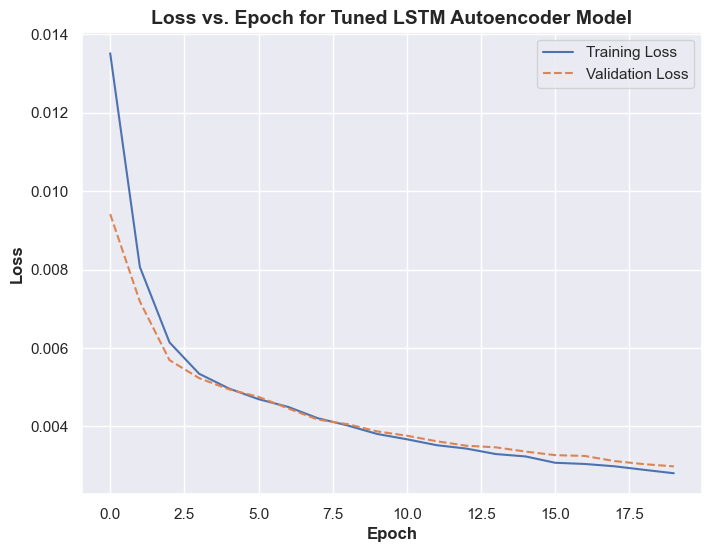

In [76]:
import matplotlib.pyplot as plt

# Plot loss vs. epoch graph for the tuned LSTM Autoencoder model
plt.figure(figsize=(8, 6))
plt.plot(history_lstm_autoencoder_tuned.history['loss'], label='Training Loss')
plt.plot(history_lstm_autoencoder_tuned.history['val_loss'], label='Validation Loss', linestyle='--')
plt.xlabel('Epoch', fontsize=12, fontweight='bold')
plt.ylabel('Loss', fontsize=12, fontweight='bold')
plt.title('Loss vs. Epoch for Tuned LSTM Autoencoder Model', fontsize=14, fontweight='bold')
plt.legend(loc='upper right')
plt.grid(True)
plt.show()


**Tuned LSTM Autoencoder Hyperparams**

In [77]:
# Print optimal hyperparameters
print("Optimal Hyperparameters:")
print(f"Number of Layers in Encoder: {best_hps.get('num_layers')}")
for i in range(best_hps.get('num_layers')):
    print(f"Units in Encoder Layer {i + 1}: {best_hps.get(f'encoding_units_{i}')}")
    print(f"Activation for Encoder Layer {i + 1}: {best_hps.get('activation')}")
print(f"Learning Rate: {best_hps.get('learning_rate')}")

# Save the optimal hyperparameters to a text file
with open("Hyperparams_LSTM_Autoencoder.txt", "w") as file:
    file.write("Optimal Hyperparameters:\n")
    file.write(f"Number of Layers in Encoder: {best_hps.get('num_layers')}\n")
    for i in range(best_hps.get('num_layers')):
        file.write(f"Units in Encoder Layer {i + 1}: {best_hps.get(f'encoding_units_{i}')}\n")
        file.write(f"Activation for Encoder Layer {i + 1}: {best_hps.get('activation')}\n")
    file.write(f"Learning Rate: {best_hps.get('learning_rate')}\n")

print("Optimal hyperparameters have been saved to 'Hyperparams_LSTM_Autoencoder.txt'.")


Optimal Hyperparameters:
Number of Layers in Encoder: 1
Units in Encoder Layer 1: 512
Activation for Encoder Layer 1: tanh
Learning Rate: 0.001
Optimal hyperparameters have been saved to 'Hyperparams_LSTM_Autoencoder.txt'.


**Tuned LSTM Autoencoder Predictions**

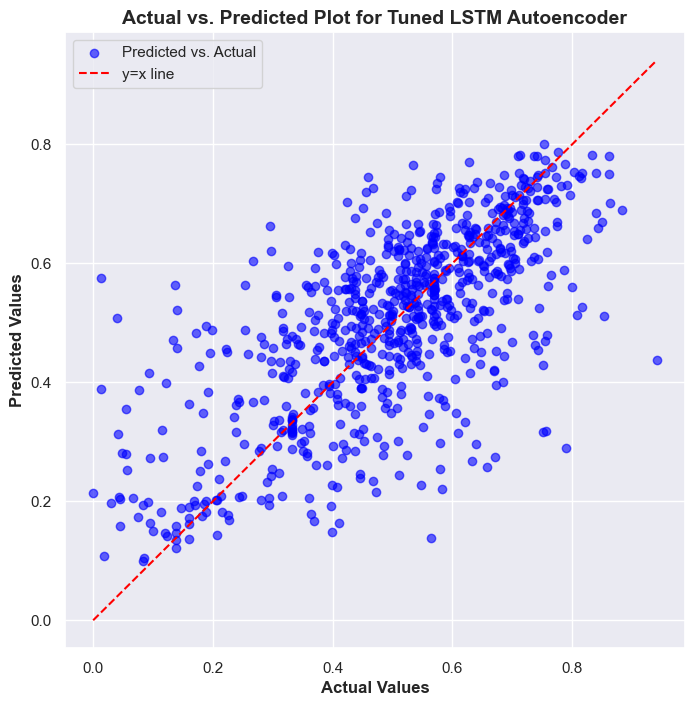

Mean Squared Error (MSE): 0.0174
Mean Absolute Error (MAE): 0.0966
R-squared (R²): 0.4520


In [78]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Extract the true values of 'conc_Fe' for the test set
y_test_true = y_test

# Plot actual vs. predicted values
plt.figure(figsize=(8, 8))
plt.scatter(y_test_true, y_pred_lstm_autoencoder_tuned, alpha=0.6, color='blue', label='Predicted vs. Actual')
plt.plot([y_test_true.min(), y_test_true.max()], [y_test_true.min(), y_test_true.max()], color='red', linestyle='--', label='y=x line')
plt.xlabel('Actual Values', fontsize=12, fontweight='bold')
plt.ylabel('Predicted Values', fontsize=12, fontweight='bold')
plt.title('Actual vs. Predicted Plot for Tuned LSTM Autoencoder', fontsize=14, fontweight='bold')
plt.legend(loc='best')
plt.grid(True)
plt.show()

# Calculate error metrics
mse = mean_squared_error(y_test_true, y_pred_lstm_autoencoder_tuned)
mae = mean_absolute_error(y_test_true, y_pred_lstm_autoencoder_tuned)
r2 = r2_score(y_test_true, y_pred_lstm_autoencoder_tuned)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

# Plot predictions
plt.figure(figsize=(15, 6))
plt.plot(y_test_actual, label='Original')
plt.plot(y_pred_autoencoder_tuned, label='Predicted')
plt.title('Tuned Autoencoder Model - Iron Concentration')
plt.xlabel('Time')
plt.ylabel('Iron Concentration')
plt.legend()
plt.show()

**Tuned LSTM Autoencoder Model Weights**

In [79]:
import numpy as np

# Get the model's weights and biases
weights_and_biases = lstm_autoencoder_tuned.get_weights()

# Save the weights and biases to a text file
with open("Tensors_Tuned_LSTM_Autoencoder.txt", "w") as file:
    for i, tensor in enumerate(weights_and_biases):
        file.write(f"Tensor {i+1} (Shape: {tensor.shape}):\n")
        file.write(np.array2string(tensor, separator=', '))
        file.write("\n\n")

print("Model weights and biases have been saved to 'Tensors_Tuned_LSTM_Autoencoder.txt'.")


Model weights and biases have been saved to 'Tensors_Tuned_LSTM_Autoencoder.txt'.


**Tuned LSTM Autoencoder Architecture**

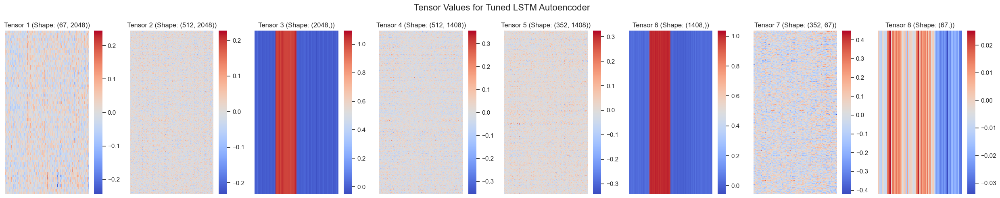

In [80]:
import seaborn as sns

# Define a function to plot tensor values using heatmaps
def plot_tensor(tensor, title, ax):
    sns.heatmap(tensor, cmap='coolwarm', cbar=True, ax=ax)
    ax.set_title(title, fontsize=12)
    ax.axis('off')

# Plot the model's tensors (weights)
fig, axes = plt.subplots(1, len(weights_and_biases), figsize=(25, 5))

for i, tensor in enumerate(weights_and_biases):
    # Reshape the tensor to 2D for visualization purposes, if necessary
    tensor_2d = tensor if len(tensor.shape) == 2 else np.reshape(tensor, (-1, tensor.shape[-1]))
    plot_tensor(tensor_2d, f'Tensor {i+1} (Shape: {tensor.shape})', axes[i])

plt.suptitle('Tensor Values for Tuned LSTM Autoencoder', fontsize=16)
plt.tight_layout()
plt.show()


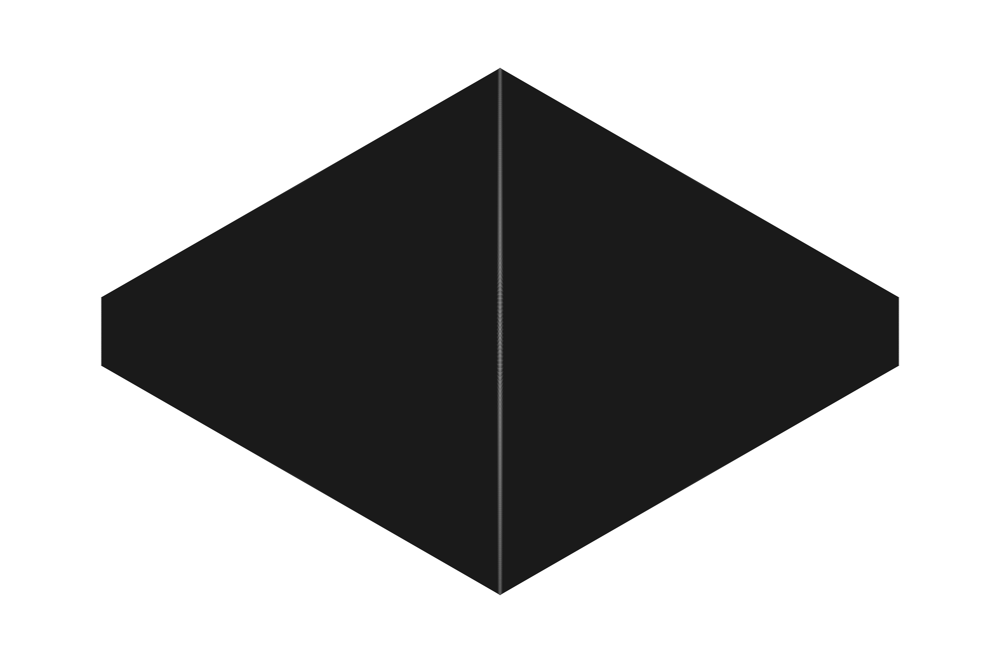

In [81]:
def draw_neural_net(ax, left, right, bottom, top, layer_sizes):
    '''
    Draw a simple neural network diagram using matplotlib.
    
    :param ax: matplotlib AxesSubplot object
    :param left: float, x-coordinate of the leftmost node(s)
    :param right: float, x-coordinate of the rightmost node(s)
    :param bottom: float, y-coordinate of the bottommost node(s)
    :param top: float, y-coordinate of the topmost node(s)
    :param layer_sizes: List of int, list containing the number of nodes in each layer
    '''
    v_spacing = (top - bottom) / float(max(layer_sizes))
    h_spacing = (right - left) / float(len(layer_sizes) - 1)

    # Nodes
    for n, layer_size in enumerate(layer_sizes):
        layer_top = v_spacing * (layer_size - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size):
            circle = plt.Circle((n * h_spacing + left, layer_top - m * v_spacing), v_spacing / 4.,
                                color='w', ec='k', zorder=4)
            ax.add_artist(circle)

    # Edges
    for n, (layer_size_a, layer_size_b) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
        layer_top_a = v_spacing * (layer_size_a - 1) / 2. + (top + bottom) / 2.
        layer_top_b = v_spacing * (layer_size_b - 1) / 2. + (top + bottom) / 2.
        for m in range(layer_size_a):
            for o in range(layer_size_b):
                line = plt.Line2D([n * h_spacing + left, (n + 1) * h_spacing + left],
                                  [layer_top_a - m * v_spacing, layer_top_b - o * v_spacing], c='k')
                ax.add_artist(line)

# Example usage
fig = plt.figure(figsize=(72, 48))
ax = fig.gca()
ax.axis('off')

# Define the number of nodes for input layer, encoding layers, and output layer
layer_sizes = [X_train.shape[2]] + [best_hps.get(f'encoding_units_{i}') for i in range(best_hps.get('num_layers'))] + [X_train.shape[2]]
draw_neural_net(ax, .1, .9, .1, .9, layer_sizes)

plt.show()


# **6. Model Comparisons**

Comparing the Above models with ones that:
- does not include rolling statistics, and lag features
- averages the dataset based on mean and standard deviation only

## **6.1. Without Rolling stats & lag features**

**Splitting dataset**

In [ ]:
# Scale data
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(flotation_transformed)

# Create sequences
def create_sequences(data, seq_length):
    xs = []
    ys = []
    for i in range(len(data) - seq_length):
        x = data[i:i+seq_length]
        y = data[i+seq_length][flotation_transformed.columns.get_loc("mean_conc_Fe")]  # Update target variable location based on new columns
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

SEQ_LENGTH = 10  # Length of the sequences
X, y = create_sequences(scaled_data, SEQ_LENGTH)

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

**LSTM**

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Build LSTM model
model_lstm_base1 = Sequential([
    LSTM(50, return_sequences=True, input_shape=(SEQ_LENGTH, X_train.shape[2])),
    LSTM(50),
    Dense(1)
    ])

model_lstm_base1.compile(optimizer='adam', loss='huber')
model_lstm_base1.summary()

# Train the model
history_lstm1 = model_lstm_base1.fit(X_train, y_train, epochs=25, batch_size=32, validation_split=0.2)

# Evaluate the model
loss_lstm = model_lstm_base1.evaluate(X_test, y_test)
print(f'Test Loss for Base LSTM: {loss_lstm}')

ax = plt.axes()
plt.plot(history_lstm1.history['loss'], color = 'b', label = "Training Loss")
plt.plot(history_lstm1.history['val_loss'], color = 'r', label = 'Validation Loss')
plt.xlabel("Epoch", fontsize = 10, fontweight ='bold')
plt.ylabel("Loss", fontsize = 10, fontweight ='bold')
ax.set_xticks(np.arange(0, len(history_lstm1.history['loss'])))
plt.title("Loss Function for Base LSTM Model", fontsize = 12, fontweight = 'bold')
plt.legend(loc = 'best')
plt.show()

# Make predictions on the test set
y_pred = model_lstm_base1.predict(X_test)

# Calculate the evaluation metrics
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the metrics
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

**Autoencoder**

In [ ]:
from tensorflow.keras.layers import Input, Dense, RepeatVector, TimeDistributed
from tensorflow.keras.models import Model

# Build Autoencoder model
input_dim = X_train.shape[2]
encoding_dim = 14  # Dimension of the latent space

input_layer = Input(shape=(SEQ_LENGTH, input_dim))
encoded = TimeDistributed(Dense(encoding_dim, activation='relu'))(input_layer)
decoded = TimeDistributed(Dense(input_dim, activation='sigmoid'))(encoded)

autoencoder_base1 = Model(input_layer, decoded)
autoencoder_base1.compile(optimizer='adam', loss='mse')
autoencoder_base1.summary()

# Train the autoencoder
history_autoencoder_base1 = autoencoder_base1.fit(X_train, X_train, epochs=30, batch_size=32, validation_split=0.2)

# Evaluate the autoencoder
loss_autoencoder = autoencoder_base1.evaluate(X_test, X_test)
print(f'Test Loss for Autoencoder: {loss_autoencoder}')

ax = plt.axes()
plt.plot(history_autoencoder_base1.history['loss'], label = "Test Loss")
plt.plot(history_autoencoder_base1.history['val_loss'], label = "Validation Loss")
plt.xlabel("Epoch", fontsize = 10, fontweight ='bold')
plt.ylabel("Loss", fontsize = 10, fontweight ='bold')
plt.title("Training Loss Function for Base Autoencoder Model", fontsize = 12, fontweight = 'bold')
plt.legend()
plt.show()

# Predict and plot
X_test_decoded = autoencoder_base1.predict(X_test)
y_pred_autoencoder_base = X_test_decoded[:, -1, new_columns.index('conc_Fe')]

# Make predictions using the autoencoder
X_test_decoded = autoencoder_base.predict(X_test)

# Calculate the evaluation metrics
mse = mean_squared_error(y_test, y_pred_autoencoder_base)
mae = mean_absolute_error(y_test, y_pred_autoencoder_base)
r2 = r2_score(y_test, y_pred_autoencoder_base)

# Print the metrics
print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

**LSTM-Autoencoder**

In [ ]:
# Build LSTM Autoencoder model
input_layer = Input(shape=(SEQ_LENGTH, input_dim))
encoded = LSTM(50, return_sequences=False)(input_layer)
decoded = RepeatVector(SEQ_LENGTH)(encoded)
decoded = LSTM(input_dim, return_sequences=True)(decoded)

lstm_autoencoder_base1 = Model(input_layer, decoded)
lstm_autoencoder_base1.compile(optimizer='adam', loss='mse')
lstm_autoencoder_base1.summary()

# Train the LSTM Autoencoder
history_lstm_autoencoder_base1 = lstm_autoencoder_base1.fit(X_train, X_train, epochs=25, batch_size=32, validation_split=0.2)

# Evaluate the LSTM Autoencoder
loss_lstm_autoencoder = lstm_autoencoder_base1.evaluate(X_test, X_test)
print(f'Test Loss for LSTM Autoencoder: {loss_lstm_autoencoder}')

ax = plt.axes()
plt.plot(history_lstm_autoencoder_base1.history['loss'], label = "Training Loss")
plt.plot(history_lstm_autoencoder_base1.history['val_loss'], label = "Validation Loss")
plt.xlabel("Epoch", fontsize = 10, fontweight ='bold')
plt.ylabel("Loss", fontsize = 10, fontweight ='bold')
plt.title("Loss Function for LSTM Autoencoder Model", fontsize = 12, fontweight = 'bold')
plt.show()

# Predict and plot
X_test_decoded = lstm_autoencoder_base1.predict(X_test)
y_pred_lstm_autoencoder_base1 = X_test_decoded[:, -1, new_columns.index('conc_Fe')]

# Calculate and print error metrics
mse = mean_squared_error(y_test, y_pred_lstm_autoencoder_base1)
mae = mean_absolute_error(y_test, y_pred_lstm_autoencoder_base1)
r2 = r2_score(y_test, y_pred_lstm_autoencoder_base1)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

**Tuned LSTM**

In [ ]:
import kerastuner as kt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam

# Define the LSTM model with hyperparameters
def build_lstm_model(hp):
    model = Sequential()
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden LSTM layers
        model.add(LSTM(
            units=hp.Int(f'units_{i}', min_value=32, max_value=512, step=32),
            return_sequences=(i != hp.get('num_layers') - 1),  # Only the last LSTM layer should not return sequences
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        ))
    model.add(Dense(1))
    model.compile(optimizer=Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                  loss='huber')
    return model

# Instantiate the tuner
tuner = kt.Hyperband(build_lstm_model,
                     objective='val_loss',
                     max_epochs=10,
                     factor=3,
                     directory='my_dir2',
                     project_name='lstm_tuning')

# Perform hyperparameter search
tuner.search(X_train, y_train, epochs=10, validation_split=0.2)

# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# Build the model with the optimal hyperparameters and train it
model_lstm_tuned1 = tuner.hypermodel.build(best_hps)
history_lstm_tuned1 = model_lstm_tuned1.fit(X_train, y_train, epochs=20, batch_size=32, validation_split=0.2)

# Evaluate the model
loss_lstm = model_lstm_tuned1.evaluate(X_test, y_test)
print(f'Test Loss for LSTM: {loss_lstm}')

# Make predictions on the test set
y_pred_lstm_tuned1 = model_lstm_tuned1.predict(X_test)

# Calculate and print error metrics
mse = mean_squared_error(y_test, y_pred_lstm_tuned1)
mae = mean_absolute_error(y_test, y_pred_lstm_tuned1)
r2 = r2_score(y_test, y_pred_lstm_tuned1)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

**Tuned-Autoencoder**

In [ ]:
from tensorflow.keras.layers import Input, Dense, RepeatVector, TimeDistributed
from tensorflow.keras.models import Model

# Define the Autoencoder model with hyperparameters
def build_autoencoder_model(hp):
    input_dim = X_train.shape[2]
    encoding_dim = hp.Int('encoding_dim', min_value=8, max_value=64, step=8)
    
    input_layer = Input(shape=(SEQ_LENGTH, input_dim))
    encoded = input_layer
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden layers in encoder
        encoded = TimeDistributed(Dense(
            units=hp.Int(f'encoding_units_{i}', min_value=8, max_value=64, step=8),
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        ))(encoded)
    
    decoded = encoded
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden layers in decoder
        decoded = TimeDistributed(Dense(
            units=hp.Int(f'decoding_units_{i}', min_value=8, max_value=64, step=8),
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        ))(decoded)
    decoded = TimeDistributed(Dense(input_dim, activation='sigmoid'))(decoded)

    autoencoder = Model(input_layer, decoded)
    autoencoder.compile(optimizer=Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                        loss='huber')
    return autoencoder

# Instantiate the tuner
tuner = kt.Hyperband(build_autoencoder_model,
                     objective='val_loss',
                     max_epochs=10,
                     factor=3,
                     directory='my_dir2',
                     project_name='autoencoder_tuning')

# Perform hyperparameter search
tuner.search(X_train, X_train, epochs=10, validation_split=0.2)

# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]
print("best hyperparameters =", best_hps)

# Build the model with the optimal hyperparameters and train it
autoencoder_tuned1 = tuner.hypermodel.build(best_hps)
history_autoencoder_tuned = autoencoder_tuned1.fit(X_train, X_train, epochs=20, batch_size=32, validation_split=0.2)

# Evaluate the model
loss_autoencoder_tuned1 = autoencoder_tuned1.evaluate(X_test, X_test)
print(f'Test Loss for Tuned Autoencoder: {loss_autoencoder_tuned1}')

# Predict and plot
X_test_decoded_tuned = autoencoder_tuned1.predict(X_test)
y_pred_autoencoder_tuned1 = X_test_decoded_tuned[:, -1, new_columns.index('conc_Fe')]

# Extract the true values of 'conc_Fe' for the test set
y_test_true = y_test

# Calculate error metrics
mse = mean_squared_error(y_test_true, y_pred_autoencoder_tuned1)
mae = mean_absolute_error(y_test_true, y_pred_autoencoder_tuned1)
r2 = r2_score(y_test_true, y_pred_autoencoder_tuned1)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')

**Tuned LSTM-Autoencoder**

In [ ]:
from tensorflow.keras.layers import LSTM, RepeatVector, TimeDistributed, Dense

# Define the LSTM Autoencoder model with hyperparameters
def build_lstm_autoencoder_model(hp):
    input_dim = X_train.shape[2]
    
    input_layer = Input(shape=(SEQ_LENGTH, input_dim))
    encoded = input_layer
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden LSTM layers in encoder
        encoded = LSTM(
            units=hp.Int(f'encoding_units_{i}', min_value=32, max_value=512, step=32),
            return_sequences=(i != hp.get('num_layers') - 1),  # Only the last LSTM layer should not return sequences
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        )(encoded)
    
    decoded = RepeatVector(SEQ_LENGTH)(encoded)
    for i in range(hp.Int('num_layers', 1, 3)):  # Tune the number of hidden LSTM layers in decoder
        decoded = LSTM(
            units=hp.Int(f'decoding_units_{i}', min_value=32, max_value=512, step=32),
            return_sequences=True,
            activation=hp.Choice('activation', values=['relu', 'tanh'])
        )(decoded)
    decoded = TimeDistributed(Dense(input_dim, activation='sigmoid'))(decoded)
    
    lstm_autoencoder = Model(input_layer, decoded)
    lstm_autoencoder.compile(optimizer=Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                             loss='huber')
    return lstm_autoencoder

# Instantiate the tuner
tuner = kt.Hyperband(build_lstm_autoencoder_model,
                     objective='val_loss',
                     max_epochs=10,
                     factor=3,
                     directory='my_dir2',
                     project_name='lstm_autoencoder_tuning')

# Perform hyperparameter search
tuner.search(X_train, X_train, epochs=10, validation_split=0.2)

# Get the optimal hyperparameters
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# Build the model with the optimal hyperparameters and train it
lstm_autoencoder_tuned1 = tuner.hypermodel.build(best_hps)
history_lstm_autoencoder_tuned = lstm_autoencoder_tuned1.fit(X_train, X_train, epochs=20, batch_size=32, validation_split=0.2)

# Evaluate the model
loss_lstm_autoencoder_tuned1 = lstm_autoencoder_tuned1.evaluate(X_test, X_test)
print(f'Test Loss for Tuned LSTM Autoencoder: {loss_lstm_autoencoder_tuned1}')

# Predict and plot
X_test_decoded_tuned = lstm_autoencoder_tuned1.predict(X_test)
y_pred_lstm_autoencoder_tuned1 = X_test_decoded_tuned[:, -1, new_columns.index('conc_Fe')]

# Extract the true values of 'conc_Fe' for the test set
y_test_true = y_test

# Calculate error metrics
mse = mean_squared_error(y_test_true, y_pred_lstm_autoencoder_tuned1)
mae = mean_absolute_error(y_test_true, y_pred_lstm_autoencoder_tuned1)
r2 = r2_score(y_test_true, y_pred_lstm_autoencoder_tuned1)

print(f'Mean Squared Error (MSE): {mse:.4f}')
print(f'Mean Absolute Error (MAE): {mae:.4f}')
print(f'R-squared (R²): {r2:.4f}')